# Attack attempt, using a cGAN to train D and FGSM to refine D

## Imports

In [1]:
import tensorflow as tf
# tf.enable_eager_execution() # default for TF 2.0

tf.keras.backend.clear_session()  # For easy reset of notebook state.
from tensorflow import keras  # Import the tf version of keras.
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization, \
                                    LeakyReLU, Conv2DTranspose, Reshape
# import keras.backend as K
from tensorflow.keras.datasets import mnist

print('TF', tf.__version__)
print('Keras', keras.__version__)

TF 2.2.0
Keras 2.3.0-tf


In [2]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from tqdm import notebook, tqdm
import pickle
from glob import glob
from pprint import pprint

import os.path
import shutil
import math
import random
from copy import copy, deepcopy

In [3]:
# Setting seeds for reproducibility 
# np.random.seed(0)
# tf.random.set_seed(0)

# Enlargen plots
plt.rcParams['figure.figsize'] = [10, 5]

## Parameters

In [4]:
# EASY_MODE: if True, Split Learning NN is used as the Discriminator in the GAN. This is good for testing, but
# bypasses the black-box paradigm! Use with caution
EASY_MODE = True

# Black-box params (optimized for MNIST)
depth = 9
filters = 33
dense = 110
num_classes = 10

# Input image dimensions
img_rows, img_cols = 28, 28
target_rows, target_cols = 28, 28    # governed by the chosen model
input_shape = (target_rows, target_cols, 1)

# Attack params:
attack_params = {
    'our_class': 0,                             # the label indices that we want to preserve (and the data we own)
    'attacker_clients': 5,                      # attacker controls X number of clients and their data
    'attack_classes': [1],                      # the label(s) we want to poison
    'flip_to': [7],                             # must be len(attack_classes) - flips the target label ('1') to new class ('7')
    'prime_trigger': 0.001, #0.11                # the D test accuracy that, after which, we will move on from priming
    'prime_first_iteration': True,              # whether to always prime on the first iteration
    'prime_by_ckpt': False,                      # whether to prime manually (False) or by loading a checkpoint file (True)
    'prime_cgan_by_ckpt': False,                # whether to load a pretrained cGAN from default/ or start from scratch (False)
    'attack_trigger': 0.8,                      # the D accuracy (wrt Black-box) that, after which, we will commence an attack
    'd_refinement_batch_num': 3,                # number of batches to refine D with: G -> BB <-> D
    'd_refinement_batch_size': 100,             # number of attack images in each refinement batch: G -> BB <-> D
    'train_dataset': None,                      # attack dataset - fixed in the beginning by choosing the attacking clients
                                                # - this is the only data we have access to throughout the training process
    'attacks_per_epoch': 10,                    # how many times to attack per epoch
    'prime_exit_trigger': 1.0,                  # how good D has to be on the current blackbox model to exit priming
    'refine_exit_trigger': 1.0,                 # how good D has to be after refinement*
    'train_bb_every_n_its': 2,                  # only train the BB model while querying if (it % train_bb_every_n_its == 0)
    'cgan_query_every_n_its': 1,                # only query BB with cGAN every N iterations
    'refine_using_fgsm': True,                 # use FGSM to generate images to refine D with via uG -> BB -> D
    'refine_using_ugan': False,                  # use the uGAN to generate images to refine D with via uG -> BB -> D
    'accumulate_g_queries': True,               # whether to keep uGAN imgs every iteration, or to just use most recent (False)
    'flush_g_queries_every_bb_train': False,    # whether to keep uGAN imgs after new BB is trained, or preserved them (False)
    'reset_g_every_bb_train': False,            # whether to reset G back to init every time we train the BB model
}

# Split Learning training params:
split_training_params = {
    'minibatch_size': None,                     # number of samples to operate on at one time
                                                #  - can vary to optimize computing requirements
                                                #  - if None, will evaluate the client's whole batch regardless of its size
    'apply_gradients_after': 20,                # after averaging the gradients from X clients, we will apply them to the model
    'epochs': 8,                                # number of epochs to train for
    'shuffle_clients': True,                    # whether to shuffle the clients during training
    'eval_batch_size': 256,                     # batch size when evaluating test set (not split by clients),
    'train_dataset': None,                      # training set - indexed by client
    'test_dataset': None,                       # testing set - not batched
    'batch_limit': None,                        # how many batches to train on, maximum, per epoch
    'ckpt_folder': "blackbox_ckpt",       # folder where to store the checkpoints
    'start_id': 'split_start',            # start piece
    'middle_id': 'split_mid',          # middle piece
    'end_id': 'split_end',                # end piece
    'full_id': 'split_model',                   # full model name
}

# cGAN training params:
cgan_training_params = {
    'minibatch_size': split_training_params['minibatch_size'],
    'extra_depth': 3,                           # number of extra middle layers to put in the D of cGAN
    'start_id': 'd_start_model',                # start piece
    'middle_id': 'd_middle_model',              # middle piece
    'end_id': 'd_end_model',                    # end piece
    'full_id': 'd_model',                       # full model name
    'use_bb_ends': True,                        # whether to share the weights of the start and end piece from the BB model
    'batch_size': 256,                          # number of images to generate from cG at once
    'noise_dim': 100,                           # noise vector for cG
    'epochs': 4,                                # number of epochs to train cGAN
    'use_blackbox': False,                      # if True, copies the Blackbox model into D (easy check)
    'd_ckpt_folder': "discriminator_ckpt",# folder where to store the d checkpoints
    'bb_ckpt_folder': "blackbox_ckpt",    # folder where the blackbox default ckpt is kept
    'g_ckpt_folder': "generator_ckpt",    # folder where to store the g checkpoints
    'batches_per_epoch': 100,                   # number of batches to train on per epoch
    'd_trigger': 0.98,                          # train D if g_accuracy is >= X
    'g_trigger': 1.01,                          # train G if g_accuracy is < X
    'loop_times': 0,                            # number of times to apply softmax -> onehot encoding
    'uncertain_loop_times': 1,                  # number to use in the uncertain_loss used by D
    'softmax_power': 2,                         # number used in softmax -> onehot encoding operation
    'd_reset_percentage': 1.0,                  # reset D if the test d_accuracy dips below X% of the original accuracy
    'early_stop_trigger': 5,                    # stop training early, if g_accuracy has not improved for X epochs
    'stop_sensitivity': 0.02,                   # "no improvement" is when the g_accuracy has not moved more than X% from prev
    'g_nudge_trigger': 3,                       # if "no improvement" for X epochs, turn on D for one turn
    'g_nudge_probability': 0.20,                # probability of nudging this sample, if enabled
    'counter_nudge': True,                      # whether to train an extra epoch when coming out of training right after nudge
    'd_priming_epoch_limit': 1000,              # number of epochs to stop at for priming
    'd_refine_epoch_limit': 200,                # number of epochs to stop at for refining D
    'save_best_g': False,                       # whether to save the best G during training, or to just use the last one
    'd_restore_after_nudge': True,              # whether to restore D back to normal at the end of the epoch if it was nudged
    'reset_g_every_it': False,                  # whether to restore cG back to init at the end of Step 5 if not -> Step 6
}

# uGAN training params:
ugan_training_params = {
    'minibatch_size': split_training_params['minibatch_size'],
    'extra_depth': 3,                           # number of extra middle layers to put in the D of cGAN
    'start_id': 'x_start_model',                # start piece
    'middle_id': 'x_middle_model',              # middle piece
    'end_id': 'x_end_model',                    # end piece
    'full_id': 'x_model',                       # full model name
    'use_bb_ends': True,                        # whether to share the weights of the start and end piece from the BB model
    'is_conditional': True,                     # whether to use the cGAN or uGAN architecture
    'batch_size': 256,                          # number of images to generate from uG at once
    'noise_dim': 100,                           # noise vector for uG
    'epochs': 15,                               # number of epochs to train uGAN
    'd_ckpt_folder': "discriminator_ckpt",# folder where to store the d checkpoints
    'bb_ckpt_folder': "blackbox_ckpt",    # folder where the blackbox default ckpt is kept
    'g_ckpt_folder': "generator_ckpt",    # folder where to store the g checkpoints
    'batches_per_epoch': 100,                   # number of batches to train on per epoch
    'loop_times': 0,                            # number of times to apply softmax -> onehot encoding
    'uncertain_loop_times': 1,                  # number to use in the uncertain_loss used by D
    'softmax_power': 2,                         # number used in softmax -> onehot encoding operation
    'early_stop_trigger': 5,                    # stop training early, if g_accuracy has not improved for X epochs
    'stop_sensitivity': 0.02,                   # "no improvement" is when the g_accuracy has not moved more than X% from prev
    'save_best_g': False,                       # whether to save the best G during training, or to just use the last one
    'reset_g_every_it': True,                   # whether to restore uG back to init at the end of Step 5 if not -> Step 6
}

# FGSM training params:
fgsm_training_params = {
    'epsilon': 0.9,
    'norm': 'Inf',                                 # can be L1, Inf
}

# Mitigation params:
mitigation_params = {
    'percent_to_drop': 0.5,                    # what percentage of images in the batch should be replaced with noise
    'smart_detect': False
}

# Data parsing params
clients_per_class = 100                         # number of clients per label. Each client only has access to one label
                                                # - each unique class is divided into X number of subsets

# Dataset params
separated_folder = "./separated_dataset"
os.makedirs(separated_folder, exist_ok=True)
separated_train_path = os.path.join(separated_folder, "train_separated.pkl")
separated_test_path = os.path.join(separated_folder, "test_separated.pkl")

## Load Data

In [5]:
# The data, split between train and test sets
(x_train, y_train), (x_test, y_test) = mnist.load_data()

if keras.backend.image_data_format() == 'channels_first':
    x_train = x_train.reshape(x_train.shape[0], 1, img_rows, img_cols)
    x_test = x_test.reshape(x_test.shape[0], 1, img_rows, img_cols)
    input_shape = (1, img_rows, img_cols)
else:
    x_train = x_train.reshape(x_train.shape[0], img_rows, img_cols, 1)
    x_test = x_test.reshape(x_test.shape[0], img_rows, img_cols, 1)
    input_shape = (img_rows, img_cols, 1)

x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255    # range is [0, 1]
x_test /= 255     # range is [0, 1]

if target_rows != img_rows or target_cols != img_cols:
    # resize x_train
    x_train_resized = []
    for x_ in x_train:
        # scale image to be the same WxH as we need:
        x_ = cv2.resize(x_, dsize=(target_rows, target_cols), interpolation=cv2.INTER_CUBIC)
        x_train_resized.append(x_)
    x_train = np.asarray(x_train_resized)

    # resize x_test
    x_test_resized = []
    for x_ in x_test:
        # scale image to be the same WxH as we need:
        x_ = cv2.resize(x_, dsize=(target_rows, target_cols), interpolation=cv2.INTER_CUBIC)
        x_test_resized.append(x_)
    x_test = np.asarray(x_test_resized)

# convert class vectors to binary class matrices
y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)

In [6]:
# summary of data shapes:
print('X:', x_train.shape, x_test.shape)
print('y:', y_train.shape, y_test.shape)
print(x_train.shape[0], 'train samples')
print(x_test.shape[0], 'test samples')

BUFFER_SIZE = x_train.shape[0]

X: (60000, 28, 28, 1) (10000, 28, 28, 1)
y: (60000, 10) (10000, 10)
60000 train samples
10000 test samples


#### Separate the data by class

In [7]:
# Separating the data by class
if os.path.isfile(separated_train_path):
    with open(separated_train_path, 'rb') as f:
        x_train_dict, y_train_dict = pickle.load(f)
        print('loaded training seperation')
else:
    x_train_dict = {}
    y_train_dict = {}
    for target_label in notebook.tqdm(range(10)):
        x_train_dict[target_label] = []
        y_train_dict[target_label] = []
        for i, label in enumerate(y_train):
            if list(label).index(1) == target_label:
                x_train_dict[target_label].append(x_train[i])
                y_train_dict[target_label].append(y_train[i])
    
    with open(separated_train_path, 'wb') as f:
        pickle.dump([x_train_dict, y_train_dict], f)
        print('saved training seperation')

if os.path.isfile(separated_test_path):
    with open(separated_test_path, 'rb') as f:
        x_test_dict, y_test_dict = pickle.load(f)
        print('loaded testing seperation')
else:
    x_test_dict = {}
    y_test_dict = {}
    for target_label in notebook.tqdm(range(10)):
        x_test_dict[target_label] = []
        y_test_dict[target_label] = []
        for i, label in enumerate(y_test):
            if list(label).index(1) == target_label:
                x_test_dict[target_label].append(x_test[i])
                y_test_dict[target_label].append(y_test[i])

    with open(separated_test_path, 'wb') as f:
        pickle.dump([x_test_dict, y_test_dict], f)
        print('saved testing seperation')
    
# convert dicts to lists
x_train_seperated = [np.array(x_train_dict[i]) for i in range(10)]
y_train_seperated = [np.array(y_train_dict[i]) for i in range(10)]

x_test_seperated = [np.array(x_test_dict[i]) for i in range(10)]
y_test_seperated = [np.array(y_test_dict[i]) for i in range(10)]

loaded training seperation
loaded testing seperation


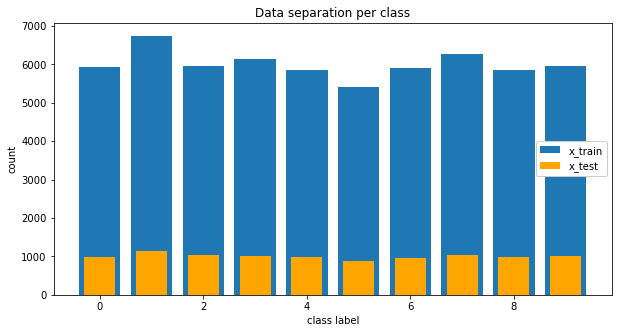

In [8]:
# summary of data shapes:
plt.figure()
plt.title('Data separation per class')
plt.bar(x_train_dict.keys(), [len(v) for v in x_train_dict.values()], color='tab:blue')
plt.bar(x_test_dict.keys(), [len(v) for v in x_test_dict.values()], color='orange', width=0.6)
plt.legend(['x_train', 'x_test'], loc='center right', framealpha=1.0)
plt.xlabel('class label')
plt.ylabel('count')
plt.show()

#### Separate the data into batches for clients to use

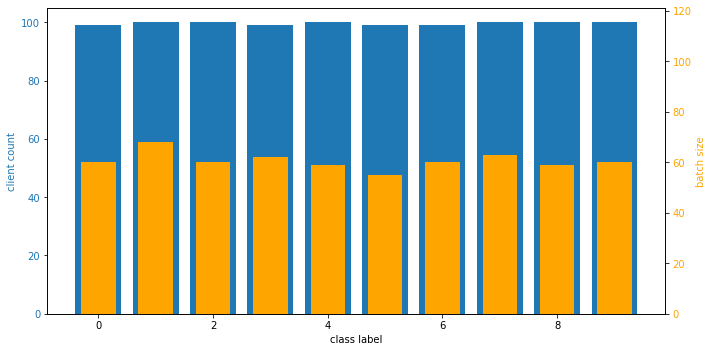

Clients per class:  99.6 ~= 100
Total number of clients: 996
Average batch size: 60.6


In [9]:
# Separate the data into a long list of batches, each batch representing a client training with that batch of images.
# After each batch, a new client will have the opportunity to train their batch of images.
# Batches are shuffled to simulate many clients training the model at once.

client_counts = {}
batch_sizes = {}
x_batches = []
y_batches = []

def ceil(a,b):
    return -(-a//b)

for class_idx in range(len(x_train_seperated)):
    # Get batches from class data:
    n_samples_per_class = len(x_train_seperated[class_idx])
    samples_per_client = n_samples_per_class / clients_per_class
    better_batch_size = int(math.ceil(samples_per_client))

    count = 0
    for i in range(ceil(n_samples_per_class, better_batch_size)):
        x_batches.append((class_idx, x_train_seperated[class_idx][i * better_batch_size: (i+1) * better_batch_size]))
        y_batches.append((class_idx, y_train_seperated[class_idx][i * better_batch_size: (i+1) * better_batch_size]))
        count += 1
    client_counts[class_idx] = count
    batch_sizes[class_idx] = better_batch_size
        
# double check that the clients_per_class is upheld per class
# (blue bars should be uniform, orange should change according to class):
fig, ax1 = plt.subplots()

color = 'tab:blue'
ax1.set_xlabel('class label')
ax1.set_ylabel('client count', color=color)
plt.bar(client_counts.keys(), [v for v in client_counts.values()], color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'orange'
ax2.set_ylabel('batch size', color=color)  # we already handled the x-label with ax1
plt.bar(batch_sizes.keys(), [v for v in batch_sizes.values()], color=color, width=0.6)
ax2.tick_params(axis='y', labelcolor=color)
ax2.set_ylim(0, np.mean([v for v in batch_sizes.values()])*2)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.show()

print('Clients per class:  {} ~= {}'.format(np.mean([v for v in client_counts.values()]), clients_per_class))
print('Total number of clients: {}'.format(np.sum([v for v in client_counts.values()])))
print('Average batch size: {}'.format(np.mean([v for v in batch_sizes.values()])))

split_batch_size = np.floor(np.mean([v for v in batch_sizes.values()]))

#### Define the attacker's dataset

In [10]:
x_batches_filtered_i = [i for i, batch in enumerate(x_batches) if batch[0] == attack_params['our_class']]
y_batches_filtered_i = [i for i, batch in enumerate(y_batches) if batch[0] == attack_params['our_class']]
assert x_batches_filtered_i == y_batches_filtered_i

x_batches_filtered = list(map(x_batches.__getitem__, x_batches_filtered_i))
y_batches_filtered = list(map(y_batches.__getitem__, y_batches_filtered_i))

print('{} clients to choose from:'.format(len(x_batches_filtered)))
print('Classes of attack clients:', [f[0] for f in x_batches_filtered])
print()

attack_clients = np.random.choice(len(x_batches_filtered), attack_params['attacker_clients'], replace=False)
print('Choosing the following clients as the attackers:\n{}'.format(attack_clients))
x_attack_batches = list(map(x_batches_filtered.__getitem__, attack_clients))
y_attack_batches = list(map(y_batches_filtered.__getitem__, attack_clients))

99 clients to choose from:
Classes of attack clients: [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

Choosing the following clients as the attackers:
[12  4 60 57 28]


In [11]:
# remove the attackers from the original training dataset
# BREAKS THE ORIGINAL X_BATCHES AND Y_BATCHES!
print('Original dataset length:', len(x_batches), len(y_batches))

x_attackers_i = list(map(x_batches_filtered_i.__getitem__, attack_clients))
y_attackers_i = list(map(y_batches_filtered_i.__getitem__, attack_clients))

x_batches = [batch for i, batch in enumerate(x_batches) if i not in x_attackers_i]
y_batches = [batch for i, batch in enumerate(y_batches) if i not in y_attackers_i]

print('New dataset length:     ', len(x_batches), len(y_batches))

Original dataset length: 996 996
New dataset length:      991 991


#### Define our datasets

In [12]:
# Batch and shuffle the data for Split Learning
split_train_dataset = (x_batches, y_batches)
split_test_dataset = (x_test, y_test)

# place into train params:
split_training_params['train_dataset'] = split_train_dataset
split_training_params['test_dataset'] = split_test_dataset

# Build attack dataset
attack_train_dataset = (x_attack_batches, y_attack_batches)
attack_params['train_dataset'] = attack_train_dataset

In [13]:
# Show min and max of the dataset (ensure you are using the right normalization)
min_ = np.inf
max_ = -np.inf
for batch in x_batches:
    min__ = np.min(batch[1])
    max__ = np.max(batch[1])
    min_ = min(min_, min__)
    max_ = max(max_, max__)
print('Min: {}; Max: {}'.format(min_, max_))

Min: 0.0; Max: 1.0


## Build Model

In [14]:
# FUNCTIONAL versions of the graphs. When calling them, you will need to specify input_layer= and training=

def start_piece(identifier, input_shape, filters=4):
    assert filters >= 1
    
    input_1 = keras.layers.Input(input_shape)
    conv1 = Conv2D(filters, kernel_size=(3, 3), activation='relu', padding='same')(input_1)
    model = keras.models.Model(inputs=[input_1], outputs=conv1)
    model._name = identifier
    
    return model

def blackbox_piece(identifier, input_shape, depth=1, filters=4):
    assert depth >= 1
    assert filters >= 1
    
    input_2 = keras.layers.Input(input_shape)
    
    # for now, we will just give the black-box all the CNN layers
    for i in range(depth-1):
        if i == 0:
            convs = Conv2D(filters, kernel_size=(3, 3), activation='relu', padding='same')(input_2)
        else:
            convs = Conv2D(filters, kernel_size=(3, 3), activation='relu', padding='same')(convs)
            
    model = keras.models.Model(inputs=[input_2], outputs=convs)
    model._name = identifier
    
    return model

def approximator_piece(identifier, input_shape, depth=1, filters=4):
    assert depth >= 1
    assert filters >= 1
    
    input_2 = keras.layers.Input(input_shape)
    
    # for now, we will just give the black-box all the CNN layers
    for i in range(depth-1):
        if i == 0:
            convs = Conv2D(filters, kernel_size=(3, 3), activation='relu', padding='same')(input_2)
        else:
            convs = Conv2D(filters, kernel_size=(3, 3), activation='relu', padding='same')(convs)
            
    model = keras.models.Model(inputs=[input_2], outputs=convs)
    model._name = identifier
    
    return model

def end_piece(identifier, input_shape, dense_breadth=128, num_classes=10):
    assert dense_breadth >= num_classes
    
    input_3 = keras.layers.Input(input_shape)
    
    pool1 = MaxPooling2D(pool_size=(2, 2))(input_3)
    drop1 = Dropout(0.25)(pool1)
    flat1 = Flatten()(drop1)
    dense1 = Dense(dense_breadth, activation='relu')(flat1)
    drop2 = Dropout(0.5)(dense1)
    dense2 = Dense(num_classes, activation='softmax')(drop2)
    
    model = keras.models.Model(inputs=[input_3], outputs=dense2)
    model._name = identifier
    
    return model

## Graph Creation

In [15]:
# Ensure the params are acceptable:
assert depth >= 1
assert filters >= 1
assert dense >= num_classes

In [16]:
class SplitLearning:
    
    def __init__(self, split_training_params):
        self.minibatch_size = split_training_params['minibatch_size']
        self.batches_per_train_step = split_training_params['apply_gradients_after']
        self.eval_batch_size = split_training_params['eval_batch_size']
        self.shuffle_clients = split_training_params['shuffle_clients']
        
        self.ckpt_folder = split_training_params['ckpt_folder']
        self.start_id = split_training_params['start_id']
        self.middle_id = split_training_params['middle_id']
        self.end_id = split_training_params['end_id']
        self.full_id = split_training_params['full_id']
        
        # define the NN model
        self.start_piece = None
        self.middle_piece = None
        self.end_piece = None
        self.server_pub, server_shape = self.server_publisher()
        self.client_sub = self.client_subscriber(server_shape)
        self.model = self.blackbox_model(self.server_pub, self.client_sub)
        
        # define loss function
        self.cross_entropy = keras.losses.CategoricalCrossentropy(from_logits=True)
        
        # define optimizers
        self.optimizer = tf.keras.optimizers.Adam(1e-4)
        
        # define metrics
        self.acc_train_avg = None
        self.loss_train_avg = None
        
        # setup checkpointing
        self.init_ckpt()
        
        # setup ops
        self.setup_ops()
        
    ###########################################################################################
    # Black-box model
        
    def server_publisher(self):
        # create the first two models (start and middle)
        
        #   start piece...
        self.start_piece = start_piece(self.start_id, input_shape, filters)
        output_shape = self.start_piece.layers[-1].output_shape[1:]
        
        #   middle...
        self.middle_piece = blackbox_piece(self.middle_id, output_shape, depth, filters)
        output_shape = self.middle_piece.layers[-1].output_shape[1:]
        
        # glue the three models together
        input_ = keras.layers.Input(input_shape)
        hidden1 = self.start_piece(input_)
        output_ = self.middle_piece(hidden1)
        
        # create the full model
        model = keras.models.Model(inputs=[input_], outputs=output_)
        model._name = self.full_id+"_pub"
        model.summary()
        
        return model, output_shape
        
    def client_subscriber(self, input_shape):
        # create the last model (end piece)
        
        #   end piece...
        self.end_piece = end_piece(self.end_id, input_shape, dense, num_classes)
        
        # glue the three models together
        input_ = keras.layers.Input(input_shape)
        output_ = self.end_piece(input_)
        
        # create the full model
        model = keras.models.Model(inputs=[input_], outputs=output_)
        model._name = self.full_id+"_sub"
        model.summary()
        
        return model
    
    def blackbox_model(self, pub, sub):
        # glue both models together
        
        input_ = pub.input
        output_ = sub(pub.output)
        
        full_model = keras.models.Model(inputs=[input_], outputs=output_)
        full_model._name = self.full_id+"_combined"
        full_model.summary()
        
        return full_model
    
    def model_loss(self, y_true, y_pred):
        return self.cross_entropy(y_true, y_pred)
        
    ###########################################################################################
    # Train
    
    def setup_ops(self):
        # INSPIRED BY: https://stackoverflow.com/questions/42156957/how-to-update-model-parameters-with-accumulated-gradients
        # https://www.tensorflow.org/tutorials/customization/custom_training_walkthrough
        
        self.tvs = self.model.trainable_variables
        self.accum_vars = [tf.Variable(tf.zeros_like(tv.initialized_value()), trainable=False) for tv in self.tvs]
        self.accum_counter = tf.Variable(0.0, trainable=False)
        
    def rand_bin_array(self, K, N):
        arr = np.zeros(N)
        arr[..., :K]  = 1
        np.random.shuffle(arr)
        return arr
    
    def train(self, datasets, iteration, g_dataset=None, batch_limit=None):
        # setup checkpointing
        self.setup_ckpt(iteration)
        
        # setup bb_dataset (stores labels if g_dataset is passed in)
        bb_dataset = []
        
        g_dataset_acc = tf.keras.metrics.Accuracy()
        
        # initialize the metrics each new epoch
        if self.acc_train_avg is not None:
            del self.acc_train_avg
        if self.loss_train_avg is not None:
            del self.loss_train_avg
        self.acc_train_avg = tf.keras.metrics.Accuracy()
        self.loss_train_avg = tf.keras.metrics.Mean()
        
        # append all datasets together for training:
        x_batches = []
        y_batches = []
        for dataset in datasets:
            x_batches_, y_batches_ = dataset
            x_batches = x_batches + x_batches_
            y_batches = y_batches + y_batches_
        # if g_dataset is not None, add those batches to the end:
        if g_dataset is not None:
            g_x_batches, g_y_batches = g_dataset
            g_batch_idxs = list(range(len(x_batches), len(x_batches)+len(g_x_batches)))
            x_batches = x_batches + g_x_batches
            y_batches = y_batches + g_y_batches
        else:
            g_batch_idxs = []
            
        # setup progress bar
        total_batches = batch_limit if batch_limit is not None and batch_limit < len(x_batches) else len(x_batches)
        pbar = notebook.tqdm(total=total_batches)
        
        batch_idxs = list(range(len(x_batches)))
        if self.shuffle_clients:
            # shuffle the batches each time
            random.shuffle(batch_idxs)
            
        # generate a mask, where '1' represents samples the server will interfere with, and '0' represents samples
        # the server will leave alone
        interfere_mask = np.zeros(len(batch_idxs))
        if mitigation_params['percent_to_drop'] > 0:
            interfere_mask[:int(mitigation_params['percent_to_drop']*len(batch_idxs))] = 1
        np.random.shuffle(interfere_mask)
        print("Drop percentage:", np.sum(interfere_mask[interfere_mask == 1]) / interfere_mask.size)
            
        for i, batch_idx in enumerate(batch_idxs):
            x_batch = x_batches[batch_idx][1]
            y_batch = y_batches[batch_idx][1]
            
#             if interfere_mask[i] == 1:
#                 # interfere with this batch:
# #                 mask_batch = self.create_mask(shape=(1, attack_params['d_refinement_batch_size']))
#                 mask_batch = self.rand_bin_array(K=int(mitigation_params['percent_to_drop']*attack_params['d_refinement_batch_size']),
#                                                  N=len(batch_idxs))
#             else:
#                 mask_batch = None
            
            if batch_idx in g_batch_idxs:
                # this is a g_x_batch! don't apply gradients, but store the prediction
                client_logits, server_logits = self.pred_step(x_batch, interfere_mask[i] == 1)
                
                # only calc acc on valid samples:
                if interfere_mask[i] != 1:
                    g_dataset_acc(tf.argmax(y_batch, 1), tf.argmax(client_logits, 1))
                
                if interfere_mask[i] == 1 and mitigation_params['smart_detect']:
                    # attacker 'detects' this is bad, and ignores this batch
                    pass
                else:
                    bb_dataset.append((x_batch, y_batch, client_logits))
            else:
                # only train on valid samples:
                if interfere_mask[i] != 1:
                    self.train_step(i, x_batch, y_batch, len(batch_idxs) - 1)
            pbar.update(1)
            pbar.set_description('train_acc={:.2f}%'.format(self.acc_train_avg.result()*100))
            
            if batch_limit is not None and i-1 >= batch_limit:
                break
        pbar.close()
        print('train_acc={:.4f}%'.format(self.acc_train_avg.result()*100))
        print('accuracy of blackbox on G dataset: {:.4f}%'.format(g_dataset_acc.result()*100))
        
        # save checkpoints
        self.checkpoint()
        
        return bb_dataset
        
    def pred_step(self, x_batch, mask_batch=False):
        
        # Generate the output from the server:
        server_logits = []
        j = 0
        while(j < len(x_batch)):
            if self.minibatch_size is None:
                # use whole batch (no minibatch)
                x_minibatch = x_batch
            else:
                x_minibatch = x_batch[j:(j+self.minibatch_size)]

            logits = self.server_pub(x_minibatch, training=True)
            server_logits = server_logits + [logits]

            if self.minibatch_size is None:
                break
            else:
                j += self.minibatch_size
        server_logits = tf.concat(server_logits, 0)
                
        # Apply masking
        
        if mask_batch:
            
            # FIXME: replacing with just zeros for now -- replace with random logits instead
            mask = np.zeros(shape=server_logits.shape)
            server_logits = mask
                
        # Generate the output from the client, accepting the server's response as input:
        client_logits = []
        j = 0
        while(j < len(server_logits)):
            if self.minibatch_size is None:
                # use whole batch (no minibatch)
                x_minibatch = server_logits
            else:
                x_minibatch = server_logits[j:(j+self.minibatch_size)]

            logits = self.client_sub(x_minibatch, training=True)
#             logits = self.model(x_minibatch, training=True)
            client_logits = client_logits + list(logits.numpy())

            if self.minibatch_size is None:
                break
            else:
                j += self.minibatch_size
                
        return client_logits, server_logits
        
    def train_step(self, i, x_batch, y_batch, limit):
        # Iterate over the client's batch in minibatches:
        j = 0
        while(j < len(x_batch)):
            if self.minibatch_size is None:
                # use whole batch (no minibatch)
                x_minibatch = x_batch
                y_minibatch = y_batch
            else:
                x_minibatch = x_batch[j:(j+self.minibatch_size)]
                y_minibatch = y_batch[j:(j+self.minibatch_size)]

            # run the gradients
            loss_value, grads = self.grad(x_minibatch, y_minibatch)

            # accumulate them
            self.accumulate_grads(grads)

            if self.minibatch_size is None:
                break
            else:
                j += self.minibatch_size

        # perform a train step every batches_per_train_step number of batches:
        if (i > 0 and i % self.batches_per_train_step == 0) or i == limit:
            # Run the train_step ops to update the weights based on our accumulated gradients
            self.optimize()
            self.zero_out()
    
    def grad(self, inputs, targets):
        with tf.GradientTape() as tape:
            logits = self.model(inputs, training=True)
            loss_value = self.model_loss(targets, logits)
            
        # evaluate accuracy and append acc and loss to arrays
        self.acc_train_avg(tf.argmax(targets, 1), tf.argmax(logits, 1))
        self.loss_train_avg(loss_value)
        
        return loss_value, tape.gradient(loss_value, self.model.trainable_variables)
    
    def accumulate_grads(self, grads):
        # add to accum_vars the new gradients
        for i, grad in enumerate(grads):
            self.accum_vars[i].assign_add(grad)
        # increment the counter by 1
        self.accum_counter.assign_add(1.0)
        
    def optimize(self):
        # apply the gradients in accum_vars, dividing by the number in accum_counter
        self.optimizer.apply_gradients(
            [(accum_var / self.accum_counter, tv) \
                for (accum_var, tv) in zip(self.accum_vars, self.model.trainable_variables)]
        )
    
    def zero_out(self):
        # reset accum_vars and accum_counter back to 0
        for i, tv in enumerate(self.accum_vars):
            self.accum_vars[i].assign(tf.zeros_like(tv))
        self.accum_counter = tf.Variable(0.0, trainable=False)
        
    ###########################################################################################
    # Checkpoint
    
    def init_ckpt(self):
        self.ckpt = tf.train.Checkpoint(optimizer=self.optimizer, model=self.model)
        self.manager = None
        self.internal_iteration = None
        self.iteration_offset = 0
        
    def setup_ckpt(self, iteration):
        # setup fresh checkpointer every new iteration
        if self.internal_iteration is None or iteration != self.internal_iteration - self.iteration_offset:
            ckpt_save_folder = os.path.join('../gan_attack/checkpoints', 'it_{}'.format(iteration + self.iteration_offset), self.ckpt_folder)
            os.makedirs(ckpt_save_folder, exist_ok=True)
        
            if self.ckpt is not None:
                del self.ckpt
            if self.manager is not None:
                del self.manager

            self.ckpt = tf.train.Checkpoint(optimizer=self.optimizer, model=self.model)
            self.manager = tf.train.CheckpointManager(self.ckpt, ckpt_save_folder, max_to_keep=1)
            self.internal_iteration = iteration + self.iteration_offset
    
    def checkpoint(self):
        save_path = self.manager.save()
        print("Saved checkpoint: {}".format(save_path))
        self.save_all_models(save_path)
        
    def save_all_models(self, save_path):
        # in addition to checkpointing, save all of the models into their own ckpt files
        it_folder = ""
        for folder in self.splitall(save_path):
            if "it" not in folder:
                it_folder = os.path.join(it_folder, folder)
            else:
                it_folder = os.path.join(it_folder, folder)
                break
        
        # save all three models
        start_piece_folder = os.path.join(it_folder, self.start_id + "_ckpt")
        os.makedirs(start_piece_folder, exist_ok=True)
        self.start_piece.save_weights(os.path.join(start_piece_folder, 'ckpt'))
        print("Saved checkpoint: {}".format(os.path.join(start_piece_folder, 'ckpt')))
        
        middle_piece_folder = os.path.join(it_folder, self.middle_id + "_ckpt")
        os.makedirs(middle_piece_folder, exist_ok=True)
        self.middle_piece.save_weights(os.path.join(middle_piece_folder, 'ckpt'))
        print("Saved checkpoint: {}".format(os.path.join(middle_piece_folder, 'ckpt')))
        
        end_piece_folder = os.path.join(it_folder, self.end_id + "_ckpt")
        os.makedirs(end_piece_folder, exist_ok=True)
        self.end_piece.save_weights(os.path.join(end_piece_folder, 'ckpt'))
        print("Saved checkpoint: {}".format(os.path.join(end_piece_folder, 'ckpt')))
        
    @staticmethod
    def splitall(path):
        allparts = []
        while 1:
            parts = os.path.split(path)
            if parts[0] == path:  # sentinel for absolute paths
                allparts.insert(0, parts[0])
                break
            elif parts[1] == path: # sentinel for relative paths
                allparts.insert(0, parts[1])
                break
            else:
                path = parts[0]
                allparts.insert(0, parts[1])
        return allparts
        
    def restore(self, it_restore=None, load_default=False):
        parent_folder = os.path.join('../gan_attack/checkpoints')
        if it_restore is None and not load_default:
            # find the most recent iteration and checkpoint
            largest_it = None
            for d in glob(os.path.join(parent_folder, '*')):
                if os.path.isfile(os.path.join(d, self.ckpt_folder, 'ckpt')):
                    # passed, valid checkpoint
                    if '_' in d:
                        # passed, valid iteration folder
                        it = int(d.split('_')[1])
                        if largest_it is None or it > largest_it:
                            largest_it = it
            if largest_it is not None:
                checkpoint_directory = os.path.join(parent_folder, 'it_{}'.format(largest_it), self.ckpt_folder)
                self.ckpt.restore(tf.train.latest_checkpoint(checkpoint_directory))
                self.iteration_offset = largest_it
                print('Restored latest checkpoint from {}'.format(checkpoint_directory))
            else:
                print('No weights found, starting with a fresh network')
        else:
            if load_default:
                checkpoint_directory = os.path.join(parent_folder, 'default', self.ckpt_folder)
            else:
                checkpoint_directory = os.path.join(parent_folder, 'it_{}'.format(it_restore), self.ckpt_folder)
            if os.path.isfile(os.path.join(checkpoint_directory, 'ckpt')):
                self.ckpt.restore(tf.train.latest_checkpoint(checkpoint_directory))
                if it_restore is not None:
                    self.iteration_offset = it_restore
                print('Restored latest checkpoint from {}'.format(checkpoint_directory))
            else:
                print('No weights found at: {}'.format(checkpoint_directory))
        
    ###########################################################################################
    # Evaluate
        
    def evaluate(self, dataset):
        '''
        NOTE: dataset here is tailored for standard 'test' dataset provided by Keras
        '''
        
        x, y = dataset
        
        acc_test_avg = tf.keras.metrics.Accuracy()
        loss_test_avg = tf.keras.metrics.Mean()
        for i in range(0, len(x), self.eval_batch_size):
            # get batch
            x_batch = x[i:i+self.eval_batch_size]
            y_batch = y[i:i+self.eval_batch_size]
            
            # evaluate
            logits = self.model(x_batch, training=False)
            acc_test_avg(tf.argmax(y_batch, 1), tf.argmax(logits, 1))
            loss_test_avg(self.model_loss(y_batch, logits))
        
        if self.acc_train_avg is not None and self.loss_train_avg is not None:
            print('Train Accuracy: {:.3f} | Loss: {:.3f}'.format(self.acc_train_avg.result(), self.loss_train_avg.result()))
        print('Test Accuracy: {:.3f} | Loss: {:.3f}'.format(acc_test_avg.result(), loss_test_avg.result()))
        print()
        return acc_test_avg.result()
        
    def predict(self, dataset, return_tensors=True):
        '''
        Returns a list of label batches of each client that was in the dataset
        '''
        
        x, _ = dataset
        labels = []
        
        for i, client_x in enumerate(x):
            x_batch = client_x[1]
            label_batch = []
            
            # run through every minibatch:
            j = 0
            while(j < len(x_batch)):
                if self.minibatch_size is None:
                    # use whole batch (no minibatch)
                    x_minibatch = x_batch
                else:
                    x_minibatch = x_batch[j:(j+self.minibatch_size)]
                    
                # evaluate
                preds = self.model(x_batch, training=False)
                if not return_tensors:
                    preds = tf.nn.softmax(preds)
                    preds = tf.argmax(preds, axis=1)
                    
                label_batch = label_batch + list(preds.numpy())
                
                if self.minibatch_size is None:
                    break
                else:
                    j += self.minibatch_size
            
            # add to list
            labels.append(label_batch)
            
        return labels

In [17]:
class D:
    '''
    The Discriminator portion of the GAN. Accepts a network, otherwise creates a new model.
    '''
    
    def __init__(self, gan_training_params, start_piece=None, middle_piece=None, end_piece=None, d_model=None):
        
#         self.ckpt_folder = gan_training_params['d_ckpt_folder']
        self.ckpt_folder = gan_training_params['middle_id']
        self.bb_ckpt_folder = gan_training_params['bb_ckpt_folder']
        self.loop_times = gan_training_params['loop_times']
        self.softmax_power = gan_training_params['softmax_power']
        self.minibatch_size = gan_training_params['minibatch_size']
        
        self.use_bb_ends = gan_training_params['use_bb_ends']
        self.start_id = gan_training_params['start_id']
        self.middle_id = gan_training_params['middle_id']
        self.end_id = gan_training_params['end_id']
        self.full_id = gan_training_params['full_id']
        
        # make FUNCTIONAL versions of the graphs. When calling them, you will need to specify input_layer= and training=
        
        # define the NN model
        if d_model is not None:
            assert start_piece is None and middle_piece is None and end_piece is None
            self.model = d_model
        else:
            self.start_piece = start_piece
            self.middle_piece = middle_piece
            self.end_piece = end_piece
            self.model = self.discriminator_model()
            
        # define optimizers
        self.optimizer = tf.keras.optimizers.Adam(1e-4)
        
        # define entropies
        self.cat_cross_entropy = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
        self.bin_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
            
        # setup checkpointing
        self.ckpt = None
        self.manager = None
        
        # save the initial weights
        if middle_piece is None:
            self.save_initial_weights()
        
    ###########################################################################################
    # Discriminator model
    
    def discriminator_model(self):
        # create all three models
        
        #   start piece...
        if self.use_bb_ends:
            assert self.start_piece is not None
        else:
            self.start_piece = start_piece(self.start_id, input_shape, filters)
        output_shape = self.start_piece.layers[-1].output_shape[1:]
        
        #   middle...
        if self.middle_piece is None:
            self.middle_piece = approximator_piece(self.middle_id, output_shape, depth, filters)
        else:
            print('WARNING: using the middle piece in D')
        output_shape = self.middle_piece.layers[-1].output_shape[1:]
        
        #   end piece...
        if self.use_bb_ends:
            assert self.end_piece is not None
        else:
            self.end_piece = end_piece(self.end_id, output_shape, dense, num_classes)
        
        # glue the three models together
        input_ = keras.layers.Input(input_shape)
        hidden1 = self.start_piece(input_)
        hidden2 = self.middle_piece(hidden1)
        output_ = self.end_piece(hidden2)
        
        # create the full model
        model = keras.models.Model(inputs=[input_], outputs=output_)
        model._name = self.full_id
        model.summary()
        
        return model
        
    ###########################################################################################
    # Loss
    
    def loss(self, fake_discrimination, labels):
        matches = self.matches_labels(fake_discrimination, labels, loop_times=self.loop_times)
        # we want the discriminator to NOT be fooled by these fake images
        cross_entropy = self.bin_cross_entropy(tf.zeros_like(matches), matches)
        return cross_entropy
    
    def entropy(self, y_true, y_pred):
        return self.cat_cross_entropy(y_true, y_pred)
        
    def matches_labels(self, fake_output, labels, loop_times=0):
        '''
        Only works if the Discriminator is already trained on real images!!
        1. Performs a softmax -> onehot conversion (differentiable approx.)
        2. Multiplies this by the onehot version of the onehot attack label
        3. Sums to reduce dimension
        
        - if the sum is close to 1, the nn thinks that the image is a part of the attack class
        - if the sum is close to 0, the nn thinks that the image is not of the attack class
        - the sum should not be in between, due to the onehot conversion we perform in step 1
        '''
        # 1.
        my_power = self.softmax_power
        for i in range(loop_times):
            fake_output = self.soft_onehot(fake_output)
        
        # 2.
        matches = tf.math.multiply(fake_output, labels)
        
        # 3.
        reduced = tf.math.reduce_sum(matches, axis=-1)
        
        return reduced
        
    def soft_onehot(self, softmax, my_power=8):
        '''
        Shown to not really work... vanishing gradients problem
        '''
        soft_extreme = softmax ** my_power
        norm = tf.reduce_sum(soft_extreme, axis=-1)
        almost_onehot = tf.math.divide(soft_extreme, tf.reshape(norm, (-1, 1)))
        return almost_onehot
    
    ###########################################################################################
    # Checkpoint
    
    def init_ckpt(self):
        self.ckpt = tf.train.Checkpoint(optimizer=self.optimizer, model=self.model)
        
    def setup_ckpt(self, iteration):
        ckpt_save_folder = os.path.join('../gan_attack/checkpoints', 'it_{}'.format(iteration), self.ckpt_folder)
        os.makedirs(ckpt_save_folder, exist_ok=True)

        if self.ckpt is not None:
            del self.ckpt
        if self.manager is not None:
            del self.manager

        self.ckpt = tf.train.Checkpoint(optimizer=self.optimizer, model=self.middle_piece)
        self.manager = tf.train.CheckpointManager(self.ckpt, ckpt_save_folder, max_to_keep=1)
        
    def checkpoint(self):
        save_path = self.manager.save()
        print("Saved D checkpoint: {}".format(save_path))
        self.save_all_models(save_path)
        
    def save_all_models(self, save_path):
        # in addition to checkpointing, save all of the models into their own ckpt files
        it_folder = ""
        for folder in self.splitall(save_path):
            if "it" not in folder:
                it_folder = os.path.join(it_folder, folder)
            else:
                it_folder = os.path.join(it_folder, folder)
                break
        
        # save all three models
        start_piece_folder = os.path.join(it_folder, self.start_id + "_ckpt")
        os.makedirs(start_piece_folder, exist_ok=True)
        self.start_piece.save_weights(os.path.join(start_piece_folder, 'ckpt'))
        print("Saved D checkpoint: {}".format(os.path.join(start_piece_folder, 'ckpt')))
        
        middle_piece_folder = os.path.join(it_folder, self.middle_id + "_ckpt")
        os.makedirs(middle_piece_folder, exist_ok=True)
        self.middle_piece.save_weights(os.path.join(middle_piece_folder, 'ckpt'))
        print("Saved D checkpoint: {}".format(os.path.join(middle_piece_folder, 'ckpt')))
        
        end_piece_folder = os.path.join(it_folder, self.end_id + "_ckpt")
        os.makedirs(end_piece_folder, exist_ok=True)
        self.end_piece.save_weights(os.path.join(end_piece_folder, 'ckpt'))
        print("Saved D checkpoint: {}".format(os.path.join(end_piece_folder, 'ckpt')))
        
    @staticmethod
    def splitall(path):
        allparts = []
        while 1:
            parts = os.path.split(path)
            if parts[0] == path:  # sentinel for absolute paths
                allparts.insert(0, parts[0])
                break
            elif parts[1] == path: # sentinel for relative paths
                allparts.insert(0, parts[1])
                break
            else:
                path = parts[0]
                allparts.insert(0, parts[1])
        return allparts
    
    def freeze_ends(self, yes):
        self.start_piece.is_training = not yes
        self.end_piece.is_training = not yes
    
    ###########################################################################################
    # Load/save weights
    
    def save_initial_weights(self):
        print('saving initial weights for D')
        init_folder = os.path.join('../gan_attack/checkpoints', 'init', self.ckpt_folder)
        os.makedirs(init_folder, exist_ok=True)
        self.model.save_weights(os.path.join(init_folder, 'ckpt'))
        
    def load_initial_weights(self):
        print('loading initial weights for D')
        init_folder = os.path.join('../gan_attack/checkpoints', 'init', self.ckpt_folder)
        self.model.load_weights(os.path.join(init_folder, 'ckpt'))
        
    def restore(self, it_restore=None, load_default=False, use_blackbox=False):
        iteration_offset = 0
        parent_folder = os.path.join('../gan_attack/checkpoints')
        if it_restore is None and not load_default:
            # find the most recent iteration and checkpoint
            largest_it = None
            for d in glob(os.path.join(parent_folder, '*')):
                if os.path.isfile(os.path.join(d, self.ckpt_folder, 'ckpt')):
                    # passed, valid checkpoint
                    if '_' in d:
                        # passed, valid iteration folder
                        it = int(d.split('_')[1])
                        if largest_it is None or it > largest_it:
                            largest_it = it
            if largest_it is not None:
#                 checkpoint_directory = os.path.join(parent_folder, 'it_{}'.format(largest_it), self.ckpt_folder)
#                 self.ckpt.restore(tf.train.latest_checkpoint(checkpoint_directory))
                self.restore_pieces(it_restore_ends=largest_it, it_restore_middle=largest_it)
                iteration_offset = largest_it
#                 print('Restored D to latest checkpoint from {}'.format(checkpoint_directory))
            else:
                print('No weights found for D, starting with a fresh network')
        else:
            if load_default:
                if use_blackbox:
                    checkpoint_directory = os.path.join(parent_folder, 'default', self.bb_ckpt_folder)
                else:
                    checkpoint_directory = os.path.join(parent_folder, 'default', self.ckpt_folder)
            else:
                checkpoint_directory = os.path.join(parent_folder, 'it_{}'.format(it_restore), self.ckpt_folder)
            if os.path.isfile(os.path.join(checkpoint_directory, 'ckpt')):
                self.ckpt.restore(tf.train.latest_checkpoint(checkpoint_directory))
                if it_restore is not None:
                    iteration_offset = it_restore
                print('Restored D to checkpoint from {}'.format(checkpoint_directory))
            else:
                print('No weights found at: {}'.format(checkpoint_directory))
        return iteration_offset
    
    def restore_middle(self, it_restore_middle):
        parent_folder = os.path.join('../gan_attack/checkpoints')
        it_folder_middle = os.path.join(parent_folder, 'it_{}'.format(it_restore_middle))
        middle_piece_folder = os.path.join(it_folder_middle, self.middle_id + "_ckpt")
        print('Restoring D piece: {}'.format(middle_piece_folder))
        
        assert os.path.isfile(os.path.join(middle_piece_folder, 'ckpt'))
        self.middle_piece.load_weights(os.path.join(middle_piece_folder, 'ckpt'))
    
    def restore_pieces(self, it_restore_ends=None, it_restore_middle=None, start_id=None, middle_id=None, 
                       end_id=None, load_default=False):
        
        if it_restore_ends is None:
            it_restore_ends = 1
        if it_restore_middle is None:
            it_restore_middle = 1
        
        if start_id is None:
            start_id = self.start_id
        if middle_id is None:
            middle_id = self.middle_id
        if end_id is None:
            end_id = self.end_id
        
        parent_folder = os.path.join('../gan_attack/checkpoints')
        it_folder_ends = os.path.join(parent_folder, 'default' if load_default else 'it_{}'.format(it_restore_ends))
        it_folder_middle = os.path.join(parent_folder, 'default' if load_default else 'it_{}'.format(it_restore_middle))
        
        start_piece_folder = os.path.join(it_folder_ends, start_id + "_ckpt")
        print('Restoring D piece: {}'.format(start_piece_folder))
        middle_piece_folder = os.path.join(it_folder_middle, middle_id + "_ckpt")
        print('Restoring D piece: {}'.format(middle_piece_folder))
        end_piece_folder = os.path.join(it_folder_ends, end_id + "_ckpt")
        print('Restoring D piece: {}'.format(end_piece_folder))
        
        assert os.path.isfile(os.path.join(start_piece_folder, 'ckpt'))
        assert os.path.isfile(os.path.join(middle_piece_folder, 'ckpt'))
        assert os.path.isfile(os.path.join(end_piece_folder, 'ckpt'))
        
        self.start_piece.load_weights(os.path.join(start_piece_folder, 'ckpt'))
        self.middle_piece.load_weights(os.path.join(middle_piece_folder, 'ckpt'))
        self.end_piece.load_weights(os.path.join(end_piece_folder, 'ckpt'))
        
    ###########################################################################################
    # Evaluation

    def discriminate(self, generated_images, training=True):
        return self.model(generated_images, training=training)

In [18]:
class G:
    '''
    The Generator portion of the GAN. Generates images given a conditional label.
    '''
    
    def __init__(self, gan_training_params, is_conditional=True, identifier=None, extra_depth=0):
        self.is_conditional = is_conditional
        self.identifier = identifier
        
        self.ckpt_folder = self.g_identifier() + gan_training_params['g_ckpt_folder']
        self.noise_dim = gan_training_params['noise_dim']
        self.uncertain_loop_times = gan_training_params['uncertain_loop_times']
        self.softmax_power = gan_training_params['softmax_power']
        
        # make FUNCTIONAL versions of the graphs. When calling them, you will need to specify input_layer= and training=
        self.input_shapes = []
        if is_conditional:
            self.model = self.c_generator_model(extra_depth)
        else:
            self.model = self.u_generator_model()
            
        # define optimizers
        self.optimizer = tf.keras.optimizers.Adam(1e-4)
        
        # define entropies
        self.cat_cross_entropy = tf.keras.losses.CategoricalCrossentropy(from_logits=True)
        self.bin_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)
            
        # setup checkpointing
        self.ckpt = None
        self.manager = None
        
        # save initial weights
        self.save_initial_weights()
        
    ###########################################################################################
    # Generator model
    
    def g_identifier(self):
        return self.identifier if self.identifier is not None else ''
    
    def c_generator_model(self, extra_depth=0):
        '''
        CONDITIONAL version of G
        '''
        ACTIVATION = keras.layers.Activation("tanh")
        
        # Prepare noise input
        self.input_shapes.append((self.noise_dim,))
        input_z = keras.layers.Input((self.noise_dim,))
        dense_z_1 = keras.layers.Dense(1024)(input_z)
        act_z_1 = ACTIVATION(dense_z_1)
        dense_z_2 = keras.layers.Dense(128 * 7 * 7)(act_z_1)
        bn_z_1 = keras.layers.BatchNormalization()(dense_z_2)
        reshape_z = keras.layers.Reshape((7, 7, 128), input_shape=(128 * 7 * 7,))(bn_z_1)

        # Prepare Conditional (label) input
        self.input_shapes.append((num_classes,))
        input_c = keras.layers.Input((num_classes,))
        dense_c_1 = keras.layers.Dense(1024)(input_c)
        act_c_1 = ACTIVATION(dense_c_1)
        dense_c_2 = keras.layers.Dense(128 * 7 * 7)(act_c_1)
        bn_c_1 = keras.layers.BatchNormalization()(dense_c_2)
        reshape_c = keras.layers.Reshape((7, 7, 128), input_shape=(128 * 7 * 7,))(bn_c_1)

        # Combine input source
        concat_z_c = keras.layers.Concatenate()([reshape_z, reshape_c])

        # Image generation with the concatenated inputs
        up_1 = keras.layers.UpSampling2D(size=(2, 2))(concat_z_c)
        conv_1 = keras.layers.Conv2D(64, (5, 5), padding='same')(up_1)
        for i in range(extra_depth):
            conv_1 = keras.layers.Conv2D(64, (5, 5), padding='same')(conv_1)
        act_1 = ACTIVATION(conv_1)
        up_2 = keras.layers.UpSampling2D(size=(2, 2))(act_1)
        #
        drop_1 = keras.layers.Dropout(0.1)(up_2)
        #
        conv_2 = keras.layers.Conv2D(1, (5, 5), padding='same')(drop_1)
        act_2 = keras.layers.Activation("tanh")(conv_2)
        model = keras.models.Model(inputs=[input_z, input_c], outputs=act_2)
        model._name = "{}g_model".format(self.g_identifier())
        return model
    
    def u_generator_model(self):
        '''
        NORMAL version of G
        '''
        model = tf.keras.Sequential()
        
        self.input_shapes.append((self.noise_dim,))
        model.add(Dense(7*7*256, use_bias=False, input_shape=(self.noise_dim,)))
        model.add(BatchNormalization())
        model.add(LeakyReLU())
        model.add(Reshape((7, 7, 256)))

        model.add(Conv2DTranspose(128, (5, 5), strides=(1, 1), padding='same', use_bias=False))
        model.add(BatchNormalization())
        model.add(LeakyReLU())

        model.add(Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
        model.add(BatchNormalization())
        model.add(LeakyReLU())

        model.add(Conv2DTranspose(1, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
        model._name = "{}g_model".format(self.g_identifier())

        return model
        
    ###########################################################################################
    # Loss
    
    def loss(self, fake_discrimination, labels):
        # we want the discriminator to be fooled by these fake images
        cross_entropy = self.cat_cross_entropy(fake_discrimination, labels)
        return cross_entropy
    
    def u_loss(self, fake_discrimination):
        '''
        Loss that measures how close the output is to having a single peak.
        In other words we are measuring how certain the model thinks it is
        correct, regardless of the answer
        1. Performs a softmax -> onehot conversion (differentiable approx.)
        2. Compare to the original output -- return this cat crossentropy
        '''
        fake_output = tf.identity(fake_discrimination)
        
        # 1.
        my_power = self.softmax_power
        for i in range(self.uncertain_loop_times):
            fake_output = self.soft_onehot(fake_output)
            
        # 2.
        return self.cat_cross_entropy(fake_output, fake_discrimination)
        
    def soft_onehot(self, softmax, my_power=8):
        '''
        Shown to not really work... vanishing gradients problem
        '''
        soft_extreme = softmax ** my_power
        norm = tf.reduce_sum(soft_extreme, axis=-1)
        almost_onehot = tf.math.divide(soft_extreme, tf.reshape(norm, (-1, 1)))
        return almost_onehot
    
    ###########################################################################################
    # Checkpoint
    
    def init_ckpt(self):
        self.ckpt = tf.train.Checkpoint(optimizer=self.optimizer, model=self.model)
        
    def setup_ckpt(self, iteration):
        ckpt_save_folder = os.path.join('../gan_attack/checkpoints', 'it_{}'.format(iteration), self.ckpt_folder)
        os.makedirs(ckpt_save_folder, exist_ok=True)

        if self.ckpt is not None:
            del self.ckpt
        if self.manager is not None:
            del self.manager

        self.ckpt = tf.train.Checkpoint(optimizer=self.optimizer, model=self.model)
        self.manager = tf.train.CheckpointManager(self.ckpt, ckpt_save_folder, max_to_keep=1)
        
    def checkpoint(self):
        save_path = self.manager.save()
        print("Saved {}G checkpoint: {}".format(self.g_identifier(), save_path))
    
    ###########################################################################################
    # Load/save weights
    
    def save_initial_weights(self):
        print('saving initial weights for {}G'.format(self.g_identifier()))
        init_folder = os.path.join('../gan_attack/checkpoints', 'init', self.ckpt_folder)
        os.makedirs(init_folder, exist_ok=True)
        self.model.save_weights(os.path.join(init_folder, 'ckpt'))
        
    def load_initial_weights(self):
        print('loading initial weights for {}G'.format(self.g_identifier()))
        init_folder = os.path.join('../gan_attack/checkpoints', 'init', self.ckpt_folder)
        self.model.load_weights(os.path.join(init_folder, 'ckpt'))
        
    def restore(self, it_restore=None, load_default=False):
        iteration_offset = 0
        parent_folder = os.path.join('../gan_attack/checkpoints')
        if it_restore is None and not load_default:
            # find the most recent iteration and checkpoint
            largest_it = None
            for d in glob(os.path.join(parent_folder, '*')):
                if os.path.isfile(os.path.join(d, self.ckpt_folder, 'ckpt')):
                    # passed, valid checkpoint
                    if '_' in d:
                        # passed, valid iteration folder
                        it = int(d.split('_')[1])
                        if largest_it is None or it > largest_it:
                            largest_it = it
            if largest_it is not None:
                checkpoint_directory = os.path.join(parent_folder, 'it_{}'.format(largest_it), self.ckpt_folder)
                self.ckpt.restore(tf.train.latest_checkpoint(checkpoint_directory))
                iteration_offset = largest_it
                print('Restored {}G to latest checkpoint from {}'.format(self.g_identifier(), checkpoint_directory))
            else:
                print('No weights found for {}G, starting with a fresh network'.format(self.g_identifier()))
        else:
            if load_default:
                checkpoint_directory = os.path.join(parent_folder, 'default', self.ckpt_folder)
            else:
                checkpoint_directory = os.path.join(parent_folder, 'it_{}'.format(it_restore), self.ckpt_folder)
            if os.path.isfile(os.path.join(checkpoint_directory, 'ckpt')):
                self.ckpt.restore(tf.train.latest_checkpoint(checkpoint_directory))
                if it_restore is not None:
                    iteration_offset = it_restore
                print('Restored {}G to checkpoint from {}'.format(self.g_identifier(), checkpoint_directory))
            else:
                print('No weights found at: {}'.format(checkpoint_directory))
        return iteration_offset
        
    ###########################################################################################
    # Evaluation
        
    def generate(self, inputs, training=True):
        generated_images = self.model(inputs, training=training)
        return generated_images

In [19]:
class cGAN:
    '''
    The cGAN. Trains the G and D.
    '''
    
    def __init__(self, gan_training_params, start_piece=None, middle_piece=None, end_piece=None):
        self.is_conditional = True
        self.extra_depth = gan_training_params['extra_depth']
        self.noise_dim = gan_training_params['noise_dim']
        self.batch_size = gan_training_params['batch_size']
        self.batches_per_epoch = gan_training_params['batches_per_epoch']
        self.d_trigger = gan_training_params['d_trigger']
        self.g_trigger = gan_training_params['g_trigger']
        self.early_stop_trigger = gan_training_params['early_stop_trigger']
        self.stop_sensitivity = gan_training_params['stop_sensitivity']
        self.g_nudge_trigger = gan_training_params['g_nudge_trigger']
        self.g_nudge_probability = gan_training_params['g_nudge_probability']
        self.minibatch_size = gan_training_params['minibatch_size']
        self.d_restore_after_nudge = gan_training_params['d_restore_after_nudge']

        # define the D and G models
        self.g = G(gan_training_params, is_conditional=self.is_conditional, identifier='c_', extra_depth=self.extra_depth)
        self.d = D(gan_training_params, start_piece, middle_piece, end_piece)
            
        # stack G on top of D
        self.gd = self.stack_models()
        print(self.gd.summary())
        
        # define losses
        self.mse = tf.keras.losses.MeanSquaredError()
        
        # define metrics
        self.gen_loss_train_avg = None
        self.gen_acc_train_avg = None
        self.disc_loss_train_avg = None
        self.disc_loss_refine_avg = None
        
        # define plotting metrics
        self.gen_loss_train_arr = []
        self.gen_acc_train_arr = []
        self.disc_loss_train_arr = []
        self.disc_acc_test_arr = []
        
        # seed for image generation
        num_examples_to_generate = 16
        self.seed = tf.random.normal([num_examples_to_generate, self.noise_dim])
        
        # labels for image generation
        label_pattern = [i % (num_classes) for i in range(num_examples_to_generate)]
        self.eval_labels = tf.one_hot(label_pattern, num_classes, dtype=tf.dtypes.float32)
        
        # setup checkpointing
        self.internal_iteration = None
        self.iteration_offset = 0
        self.save_ckpts = True
        
        # initialize d and g checkpoints
        self.d.init_ckpt()
        self.g.init_ckpt()
        
        # setup early stop metrics
        self.early_stop = False
        self.no_change_inc = 0
        self.prev_g_acc = None
        self.best_g_acc = None
        self.nudge_flag = False
        
    def stack_models(self):
        inputs = []
        for input_shape in self.g.input_shapes:
            inputs.append(keras.layers.Input(input_shape))
        
        outputG = self.g.model(inputs)
        
        # output of G needs to be converted from [-1, 1] to [0, 1] spectrum
        outputG_converted = 0.5 * outputG + 0.5
        
        outputD = self.d.model(outputG_converted)
        
        model = keras.models.Model(inputs=inputs, outputs=outputD)
        model._name = "cgan_model"
        
        return model
        
    ###########################################################################################
    # Trainer
        
    def train(self, iteration, save_best=False):
        # setup checkpointing
        self.setup_ckpts(iteration)
        
        # freeze the ends of D
        self.d.freeze_ends(True)
        
        # initialize the metrics each new epoch
        if self.gen_acc_train_avg is not None:
            del self.gen_acc_train_avg
        if self.gen_loss_train_avg is not None:
            del self.gen_loss_train_avg
        if self.disc_loss_train_avg is not None:
            del self.disc_loss_train_avg
        
        self.gen_loss_train_avg = tf.keras.metrics.Mean()
        self.gen_acc_train_avg = tf.keras.metrics.Accuracy()
        self.disc_loss_train_avg = tf.keras.metrics.Mean()
        
        pbar = notebook.tqdm(total=self.batches_per_epoch)
        
        for i in range(self.batches_per_epoch):
            # nudge generator if nothing is happening:
            if self.nudge():
                if not self.nudge_flag:
                    self.nudge_flag = True
                    print("*** nudging ***")
                train_discriminator = True
            else:
                train_discriminator = (self.gen_acc_train_avg.result() >= self.d_trigger)
            
            # logic for training the generator
            train_generator = (self.gen_acc_train_avg.result() < self.g_trigger)
            
            self.c_train_step(train_discriminator=train_discriminator, train_generator=train_generator)
            pbar.update(1)
            pbar.set_description('g_acc={:.2f}, g_loss={:.2f}, d_loss={:.2f}'.format(self.gen_acc_train_avg.result(),
                                                                                     self.gen_loss_train_avg.result(),
                                                                                     self.disc_loss_train_avg.result()))
        
        print('g_acc={:.2f}, g_loss={:.2f}, d_loss={:.2f}'.format(self.gen_acc_train_avg.result(),
                                                                  self.gen_loss_train_avg.result(),
                                                                  self.disc_loss_train_avg.result()))
        
        # reload from pre-nudge state
        just_nudged = False
        if self.nudge_flag:
            just_nudged = True
            if self.d_restore_after_nudge:
                self.d.restore_middle(iteration)
            self.nudge_flag = False
        
        # save checkpoints
        # only checkpoint d if we are the cGAN
        self.checkpoint_d()
        if save_best:
            if self.best_g_acc is None or self.gen_acc_train_avg.result() >= self.best_g_acc:
                self.best_g_acc = self.gen_acc_train_avg.result()
                self.checkpoint_g()
        else:
            self.checkpoint_g()
            
        # unfreeze the ends of D
        self.d.freeze_ends(False)
        
        # check for early stop
        self.early_stop_check()
        
        return just_nudged
    
    def c_train_step(self, train_discriminator, train_generator):
        noise = tf.random.normal([self.batch_size, self.noise_dim])
        random_classes = tf.random.uniform(shape=(self.batch_size, ), maxval=num_classes, dtype=tf.dtypes.int32)
        labels = tf.one_hot(random_classes, num_classes, dtype=tf.dtypes.float32)

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            fake_discrimination = self.gd([noise, labels], training=train_generator)

            gen_loss = self.g.loss(fake_discrimination, labels)
            disc_loss = self.d.loss(fake_discrimination, labels)
            
            # evaluate accuracy and append acc and loss to arrays
            self.gen_loss_train_avg(gen_loss)
            self.gen_acc_train_avg(tf.argmax(labels, 1), tf.argmax(fake_discrimination, 1))
            self.disc_loss_train_avg(disc_loss)

        gradients_of_generator = gen_tape.gradient(gen_loss, self.g.model.trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, self.d.middle_piece.trainable_variables)

        if train_generator:
            self.g.optimizer.apply_gradients(zip(gradients_of_generator, self.g.model.trainable_variables))
        if train_discriminator:
            self.d.optimizer.apply_gradients(zip(gradients_of_discriminator, self.d.middle_piece.trainable_variables))
            
    def nudge(self):
        nudge = False
        if self.no_change_inc >= self.g_nudge_trigger:
            nudge = random.random() < self.g_nudge_probability
        return nudge
    
    def refine_discriminator(self, input_datasets, blackbox_labelss, iteration):
        assert len(input_datasets) == len(blackbox_labelss)
        self.setup_ckpts(iteration)
        
        # freeze the ends of D
        self.d.freeze_ends(True)
        
        disc_loss_refine_avg = tf.keras.metrics.Mean()
        disc_acc_refine_avg = tf.keras.metrics.Accuracy()
        optimizer = tf.keras.optimizers.Adam(1e-4)
        
        for k in range(len(input_datasets)):
            # perform for every pair of data:
            
            input_dataset = input_datasets[k]        # (x, y) --> x: [[ client ... [(id, data) ...]]
            blackbox_labels = blackbox_labelss[k]    #               [[ client ... [label_batch ...]]
            
            x, _ = input_dataset
            
            client_idxs = list(range(len(x)))
            random.shuffle(client_idxs)

            for client_idx in client_idxs:

                # compare the two using MSE
                client_x = x[client_idx]
                x_batch = client_x[1]

                # run through every minibatch:
                j = 0
                while(j < len(x_batch)):
                    if self.minibatch_size is None:
                        # use whole batch (no minibatch)
                        x_minibatch = x_batch
                        y_minibatch = blackbox_labels[client_idx]
                    else:
                        x_minibatch = x_batch[j:(j+self.minibatch_size)]
                        y_minibatch = blackbox_labels[client_idx][j:(j+self.minibatch_size)]
                        
                    with tf.GradientTape() as refine_tape:
                        # predict each minibatch of the input_dataset and match it with its counterpart from the blackbox
                        label_batch = self.d.discriminate(x_minibatch)
                        refine_loss = self.mse(y_minibatch, label_batch)
                        disc_loss_refine_avg(refine_loss)
                        disc_acc_refine_avg(tf.argmax(y_minibatch, 1), tf.argmax(label_batch, 1))

                    # train the discriminator, one client batch at a time
                    gradients_of_discriminator = refine_tape.gradient(refine_loss, self.d.middle_piece.trainable_variables)
                    optimizer.apply_gradients(zip(gradients_of_discriminator, self.d.middle_piece.trainable_variables))

                    if self.minibatch_size is None:
                        break
                    else:
                        j += self.minibatch_size
                        
        # unfreeze the ends of D
        self.d.freeze_ends(False)
                    
        return disc_loss_refine_avg.result(), disc_acc_refine_avg.result()
        
    ###########################################################################################
    # Checkpoint
    
    def setup_ckpts(self, iteration):
        if self.save_ckpts:
            # setup fresh checkpointer every new iteration
            if self.internal_iteration is None or (self.internal_iteration != (iteration + self.iteration_offset)):
                self.internal_iteration = iteration + self.iteration_offset
                self.d.setup_ckpt(self.internal_iteration)
                self.g.setup_ckpt(self.internal_iteration)
    
    def checkpoint_d(self):
        if self.save_ckpts:
            self.d.checkpoint()
    
    def checkpoint_g(self):
        if self.save_ckpts:
            self.g.checkpoint()
            
    def restore(self, it_restore=None, load_default=False):
        self.d.restore_pieces(it_restore_ends=it_restore, it_restore_middle=it_restore, load_default=load_default)
        self.iteration_offset = self.g.restore(it_restore, load_default)
        
    ###########################################################################################
    # Early stop
        
    def early_stop_check(self):
        if self.prev_g_acc is not None:
            perc_diff = abs(self.gen_acc_train_avg.result() - self.prev_g_acc) / self.prev_g_acc
            #print(perc_diff, self.stop_sensitivity)
            if perc_diff <= self.stop_sensitivity:
                self.no_change_inc += 1
                print('> no change inc: {}/{}'.format(self.no_change_inc, self.early_stop_trigger))
                if self.no_change_inc >= self.early_stop_trigger:
                    self.early_stop = True
                    self.no_change_inc = 0
            else:
                self.no_change_inc = 0

        self.prev_g_acc = self.gen_acc_train_avg.result()
        
    def reset_early_stop(self):
        self.no_change_inc = 0
        self.prev_g_acc = None
        self.best_g_acc = None
        self.nudge_flag = False
        
    ###########################################################################################
    # Evaluate
            
    def generate_images(self, images=None, labels=None):
        # Notice `training` is set to False.
        # This is so all layers run in inference mode (batchnorm).
        
        if images is None:
            images = self.g.generate([self.seed, self.eval_labels], training=False)
            images = 0.5 * images + 0.5
            labels = self.eval_labels
        assert images.shape[0] >= 16
        assert labels is not None
        assert len(labels) == len(images)

        categories = [self.g.g_identifier()+str(x) for x in list(range(10))]
        fig = plt.figure(figsize=(4,4))
        for i in range(16):
            ax = plt.subplot(4, 4, i+1)
            if self.is_conditional:
                ax.title.set_text(categories[np.argmax(labels[i])])
            plt.imshow(images[i, :, :, 0] * 255.0, cmap='gray')
            plt.axis('off')

        plt.tight_layout()
        plt.show()
        
    def generate_dataset(self, batch_num, batch_size, verbose=False):
        '''
        Generates a list of batches (x_batch, y_batch) to pass into the black-box model
        '''
        x_batches = []
        y_batches = []
        for b in range(batch_num):
            
            # create a list of random ints
            seed = tf.random.normal([batch_size, self.noise_dim])
            gen_labels = np.random.randint(num_classes, size=batch_size)
            y_batch = self.onehot_vals(gen_labels)
            
            predictions = self.g.generate([seed, y_batch], training=False)
            x_batch = 0.5 * predictions + 0.5
            
            x_batches.append((None, x_batch)) # making into a tuple to match previous dataset scheme
            y_batches.append((None, y_batch))
            
        if verbose:
            self.generate_images(x_batches[0][1], y_batches[0][1])
        return [x_batches, y_batches]
    
    def onehot_vals(self, a):
        b = np.zeros((a.size, num_classes), dtype=np.float32)
        b[np.arange(a.size), a] = 1
        return b
        
    def evaluate_gan(self, dataset):
        
        if self.gen_acc_train_avg is not None:
            print('G Train Acc:     {:.3f} | Loss: {:.3f}'.format(self.gen_acc_train_avg.result(),
                                                                self.gen_loss_train_avg.result()))
            print('D Train Acc:     NaN   | Loss: {:.3f}'.format(self.disc_loss_train_avg.result()))
        disc_acc_test = self.evaluate_discriminator(dataset)
        
        # define plotting metrics
        self.gen_loss_train_arr.append(self.gen_loss_train_avg.result())
        self.gen_acc_train_arr.append(self.gen_acc_train_avg.result())
        self.disc_loss_train_arr.append(self.disc_loss_train_avg.result())
        self.disc_acc_test_arr.append(disc_acc_test)
        
        return disc_acc_test
        
    def evaluate_discriminator(self, dataset, verbose=True):
        
        x, y = dataset
        
        acc_test_avg = tf.keras.metrics.Accuracy()
        loss_test_avg = tf.keras.metrics.Mean()
        for i in range(0, len(x), self.batch_size):
            # get batch
            x_batch = x[i:i+self.batch_size]
            y_batch = y[i:i+self.batch_size]
            
            # evaluate
            logits = self.d.discriminate(x_batch, training=False)
            acc_test_avg(tf.argmax(y_batch, 1), tf.argmax(logits, 1))
            loss_test_avg(self.d.entropy(y_batch, logits))
            
        if verbose:
            print('D Test Accuracy: {:.3f} | Loss: {:.3f}'.format(acc_test_avg.result(), loss_test_avg.result()))
            print()
        
        return acc_test_avg.result()

In [20]:
class uGAN:
    '''
    The uGAN. Trains the uG. uG can be either conditional or not conditional.
    '''
    
    def __init__(self, gan_training_params, is_conditional=True, start_piece=None, middle_piece=None, end_piece=None):
        self.is_conditional = is_conditional
        
        self.extra_depth = gan_training_params['extra_depth']
        self.noise_dim = gan_training_params['noise_dim']
        self.batch_size = gan_training_params['batch_size']
        self.batches_per_epoch = gan_training_params['batches_per_epoch']
        self.early_stop_trigger = gan_training_params['early_stop_trigger']
        self.stop_sensitivity = gan_training_params['stop_sensitivity']

        # define the D and G models (D comes from cGAN)
        self.g = G(gan_training_params, is_conditional=self.is_conditional, identifier='u_', extra_depth=self.extra_depth)
        self.d = D(gan_training_params, start_piece, middle_piece, end_piece)
            
        # stack G on top of D
        self.gd = self.stack_models()
        print(self.gd.summary())
        
        # define metrics
        self.gen_loss_train_avg = None
        self.gen_acc_train_avg = None
        
        # define plotting metrics
        self.gen_loss_train_arr = []
        self.gen_acc_train_arr = []
        
        # seed for image generation
        num_examples_to_generate = 16
        self.seed = tf.random.normal([num_examples_to_generate, self.noise_dim])
        
        # labels for image generation
        label_pattern = [i % (num_classes) for i in range(num_examples_to_generate)]
        self.eval_labels = tf.one_hot(label_pattern, num_classes, dtype=tf.dtypes.float32)
        
        # setup checkpointing
        self.internal_iteration = None
        self.iteration_offset = 0
        self.save_ckpts = True
        
        # initialize d and g checkpoints
        self.g.init_ckpt()
        
        # setup early stop metrics
        self.early_stop = False
        self.no_change_inc = 0
        self.prev_g_acc = None
        self.best_g_acc = None
        self.nudge_flag = False
        
    def stack_models(self):
        inputs = []
        for input_shape in self.g.input_shapes:
            inputs.append(keras.layers.Input(input_shape))
        
        outputG = self.g.model(inputs)
        
        # output of G needs to be converted from [-1, 1] to [0, 1] spectrum
        outputG_converted = 0.5 * outputG + 0.5
        
        outputD = self.d.model(outputG_converted)
        
        model = keras.models.Model(inputs=inputs, outputs=outputD)
        model._name = "ugan_model"
        
        return model
        
    ###########################################################################################
    # Trainer
        
    def train(self, iteration, save_best=False):
        # setup checkpointing
        self.setup_ckpts(iteration)
        
        # initialize the metrics each new epoch
        if self.gen_acc_train_avg is not None:
            del self.gen_acc_train_avg
        if self.gen_loss_train_avg is not None:
            del self.gen_loss_train_avg
        
        self.gen_loss_train_avg = tf.keras.metrics.Mean()
        if self.is_conditional:
            self.gen_acc_train_avg = tf.keras.metrics.Accuracy()
        
        pbar = notebook.tqdm(total=self.batches_per_epoch)
        
        for i in range(self.batches_per_epoch):
            # logic for training the generator
            train_generator = True
            
            if self.is_conditional:
                self.c_train_step(train_generator=train_generator)
                pbar.update(1)
                pbar.set_description('g_acc={:.2f}, g_loss={:.2f}'.format(self.gen_acc_train_avg.result(),
                                                                          self.gen_loss_train_avg.result()))
            else:
                self.u_train_step(train_generator=train_generator)
                pbar.update(1)
                pbar.set_description('g_loss={:.8f}'.format(self.gen_loss_train_avg.result()))
        
        if self.is_conditional:
            print('g_acc={:.2f}, g_loss={:.2f}'.format(self.gen_acc_train_avg.result(),
                                                       self.gen_loss_train_avg.result()))
        else:
            print('g_loss={:.2f}'.format(self.gen_loss_train_avg.result()))
        
        # save checkpoints
        if save_best:
            if self.is_conditional:
                if self.best_g_acc is None or self.gen_acc_train_avg.result() >= self.best_g_acc:
                    self.best_g_acc = self.gen_acc_train_avg.result()
                    self.checkpoint_g()
            else:
                # TODO: maybe make a best_ug_loss?
                self.checkpoint_g()
        else:
            self.checkpoint_g()
        
        # check for early stop
        self.early_stop_check()
    
    def c_train_step(self, train_generator):
        noise = tf.random.normal([self.batch_size, self.noise_dim])
        random_classes = tf.random.uniform(shape=(self.batch_size, ), maxval=num_classes, dtype=tf.dtypes.int32)
        labels = tf.one_hot(random_classes, num_classes, dtype=tf.dtypes.float32)

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            fake_discrimination = self.gd([noise, labels], training=train_generator)

            gen_loss = self.g.u_loss(fake_discrimination) + self.g.loss(fake_discrimination, labels)
            
            # evaluate accuracy and append acc and loss to arrays
            self.gen_loss_train_avg(gen_loss)
            self.gen_acc_train_avg(tf.argmax(labels, 1), tf.argmax(fake_discrimination, 1))

        gradients_of_generator = gen_tape.gradient(gen_loss, self.g.model.trainable_variables)

        if train_generator:
            self.g.optimizer.apply_gradients(zip(gradients_of_generator, self.g.model.trainable_variables))
    
    def u_train_step(self, train_generator):
        '''
        Train G, knowing we are trying to generate the most appropriate dataset to pass to BB
        '''
        noise = tf.random.normal([self.batch_size, self.noise_dim])
        random_classes = tf.random.uniform(shape=(self.batch_size, ), maxval=num_classes, dtype=tf.dtypes.int32)

        with tf.GradientTape() as gen_tape:
            fake_discrimination = self.gd(noise, training=train_generator)

            gen_loss = self.g.u_loss(fake_discrimination)
            
            # evaluate accuracy and append acc and loss to arrays
            self.gen_loss_train_avg(gen_loss)

        gradients_of_generator = gen_tape.gradient(gen_loss, self.g.model.trainable_variables)

        if train_generator:
            self.g.optimizer.apply_gradients(zip(gradients_of_generator, self.g.model.trainable_variables))
        
    ###########################################################################################
    # Checkpoint
    
    def setup_ckpts(self, iteration):
        if self.save_ckpts:
            # setup fresh checkpointer every new iteration
            if self.internal_iteration is None or (self.internal_iteration != (iteration + self.iteration_offset)):
                self.internal_iteration = iteration + self.iteration_offset
                self.g.setup_ckpt(self.internal_iteration)
    
    def checkpoint_g(self):
        if self.save_ckpts:
            self.g.checkpoint()
        
    def restore(self, it_restore=None, load_default=False):
        self.iteration_offset = self.g.restore(it_restore, load_default)
        
    ###########################################################################################
    # Early stop
        
    def early_stop_check(self):
        if self.is_conditional:
            if self.prev_g_acc is not None:
                perc_diff = abs(self.gen_acc_train_avg.result() - self.prev_g_acc) / self.prev_g_acc
                #print(perc_diff, self.stop_sensitivity)
                if perc_diff <= self.stop_sensitivity:
                    self.no_change_inc += 1
                    print('> no change inc: {}/{}'.format(self.no_change_inc, self.early_stop_trigger))
                    if self.no_change_inc >= self.early_stop_trigger:
                        self.early_stop = True
                        self.no_change_inc = 0
                else:
                    self.no_change_inc = 0

            self.prev_g_acc = self.gen_acc_train_avg.result()
        else:
            # TODO: maybe make a prev_ug_loss?
            pass
        
    def reset_early_stop(self):
        self.no_change_inc = 0
        self.prev_g_acc = None
        self.best_g_acc = None
        self.nudge_flag = False
        
    ###########################################################################################
    # Evaluate
            
    def generate_images(self, predictions=None, labels=None):
        # Notice `training` is set to False.
        # This is so all layers run in inference mode (batchnorm).
        
        if predictions is None:
            predictions = self.g.generate([self.seed, self.eval_labels], training=False)
            predictions = 0.5 * predictions + 0.5
            labels = self.eval_labels
        assert predictions.shape[0] >= 16
        assert labels is not None
        assert len(labels) == len(predictions)

        if self.is_conditional:
            categories = [self.g.g_identifier()+str(x) for x in list(range(10))]
        fig = plt.figure(figsize=(4,4))
        for i in range(16):
            ax = plt.subplot(4, 4, i+1)
            if self.is_conditional:
                ax.title.set_text(categories[np.argmax(labels[i])])
            plt.imshow(predictions[i, :, :, 0] * 255.0, cmap='gray')
            plt.axis('off')

        plt.tight_layout()
        plt.show()
        
    def generate_dataset(self, batch_num, batch_size, verbose=False):
        '''
        Generates a list of batches (x_batch, y_batch) to pass into the black-box model
        '''
        x_batches = []
        y_batches = []
        for b in range(batch_num):
            
            # create a list of random ints
            seed = tf.random.normal([batch_size, self.noise_dim])
            gen_labels = np.random.randint(num_classes, size=batch_size)
            y_batch = self.onehot_vals(gen_labels)
            
            if self.is_conditional:
                predictions = self.g.generate([seed, y_batch], training=False)
            else:
                predictions = self.g.generate(seed, training=False)
            x_batch = 0.5 * predictions + 0.5
            
            x_batches.append((None, x_batch)) # making into a tuple to match previous dataset scheme
            y_batches.append((None, y_batch))
            
        if verbose:
            self.generate_images(x_batches[0][1], y_batches[0][1])
        return [x_batches, y_batches]
    
    def onehot_vals(self, a):
        b = np.zeros((a.size, num_classes), dtype=np.float32)
        b[np.arange(a.size), a] = 1
        return b

In [21]:
class FGSM:
    '''
    The FGSM trainer. Generates better images to be used in the cGAN
    '''
    
    def __init__(self, fgsm_training_params, d):
        
        self.epsilon = fgsm_training_params['epsilon']
        self.norm = fgsm_training_params['norm']
        
        # D must be the one we are using in the cGAN (because that's the D we are refining)
        assert d is not None and type(d) is D
        self.d = d
        # self.d = D(fgsm_training_params, start_piece=d.start_piece, middle_piece=d.middle_piece, end_piece=d.end_piece)
        
        # define losses
        self.cross_entropy = keras.losses.CategoricalCrossentropy(from_logits=True)
        
    ###########################################################################################
    # Trainer
    
    def augment_dataset(self, input_datasets, blackbox_labelss, iteration):
        assert len(input_datasets) == len(blackbox_labelss)
        
        # freeze the ends of D
        self.d.freeze_ends(True)
        
        disc_loss_refine_avg = tf.keras.metrics.Mean()
        disc_acc_refine_avg = tf.keras.metrics.Accuracy()
        optimizer = tf.keras.optimizers.Adam(1e-4)
        
        # Set the parameter epsilon = 0.5 for FGSM (Only alter the first 5 terms , X0~X4)
        print ("Fast Gradient Sign Method based on {} norm".format(self.norm))
        g_x_batches = []
        g_y_batches = []
        for k in notebook.tqdm(range(len(input_datasets))):
            # perform for every pair of data:
            
            input_dataset = input_datasets[k]        # (x, y) --> x: [[ client ... [(id, data) ...]]
            blackbox_labels = blackbox_labelss[k]    #               [[ client ... [label_batch ...]]
            
            x, y = input_dataset

            # compare the two using MSE
            for i, client_x in enumerate(x):
                x_batch = x[i][1]
                
                g_x_batch = []
                g_y_batch = []
                # print(g_x_batch.shape, y[i][1].shape)
                
                for j in range(x_batch.shape[0]):
                    
                    x_ = tf.convert_to_tensor(np.expand_dims(x_batch[j], axis=0), np.float32)
                    y_ = np.expand_dims(blackbox_labels[i][j], axis=0)
                    
                    with tf.GradientTape() as tape:
                        tape.watch(x_)
                        prediction = self.d.discriminate(x_)
                        loss = self.cross_entropy(y_, prediction)
                        
                        disc_loss_refine_avg(loss)
                        disc_acc_refine_avg(tf.argmax(y_, 1), tf.argmax(prediction, 1))
                        
                    # Get the gradients of the loss w.r.t to the input image.
                    grad = tape.gradient(loss, x_)
                    
                    if self.norm == 'L1':
                        grad = grad/(sum(abs(grad)))
                    elif self.norm == 'Inf':
                        grad = tf.sign(grad)
                    else:
                        raise Exception('L-norm not recognized')
                        
                    if not np.any(np.isnan(grad.numpy())):
                        # Append the augmented image to the list (only if all elements in grad are not NaN)
                        g_x_batch.append((np.expand_dims(x_batch[j], axis=0) + self.epsilon * grad.numpy())[0])
                        g_y_batch.append(y[i][1][j])
                    
                if len(g_x_batch) > 0:
                    g_x_batches.append((None, np.array(g_x_batch)))
                    g_y_batches.append((None, np.array(g_y_batch)))
            
        # unfreeze the ends of D
        self.d.freeze_ends(False)
            
        return (g_x_batches, g_y_batches)
        
    ###########################################################################################
    # Checkpoint
        
    def restore(self, it_restore=None, load_default=False):
        self.iteration_offset = self.d.restore(it_restore, load_default, use_blackbox=False)

In [22]:
class SystemTrainer:
    
    def __init__(self, split_training_params, cgan_training_params, ugan_training_params, fgsm_training_params, attack_params):
        # Datasets:
        self.split_train_dataset = split_training_params['train_dataset']
        assert self.split_train_dataset is not None
        self.split_test_dataset = split_training_params['test_dataset']
        assert self.split_test_dataset is not None
        self.attack_train_dataset = attack_params['train_dataset']
        assert self.attack_train_dataset is not None
        
        # Split Learning params:
        self.split_epochs = split_training_params['epochs']
        self.split_batch_limit = split_training_params['batch_limit']
        
        # GAN params:
        self.cgan_training_params = cgan_training_params
        self.fgsm_training_params = fgsm_training_params
        
        self.cgan_epochs = cgan_training_params['epochs']
        self.use_blackbox= cgan_training_params['use_blackbox']
        self.d_reset_percentage = cgan_training_params['d_reset_percentage']
        self.d_priming_epoch_limit = cgan_training_params['d_priming_epoch_limit']
        self.d_refine_epoch_limit = cgan_training_params['d_refine_epoch_limit']
        self.save_best_cg = cgan_training_params['save_best_g']
        self.reset_c_g_every_it = cgan_training_params['reset_g_every_it']
        self.counter_nudge = cgan_training_params['counter_nudge']
        
        # Attack params:
        self.prime_first_iteration = attack_params['prime_first_iteration']
        self.prime_exit_trigger = attack_params['prime_exit_trigger']
        self.prime_cgan_by_ckpt = attack_params['prime_cgan_by_ckpt']
        self.refine_exit_trigger = attack_params['refine_exit_trigger']
        self.prime_trigger = attack_params['prime_trigger']
        self.prime_by_ckpt = attack_params['prime_by_ckpt']
        self.attack_trigger = attack_params['attack_trigger']
        self.attack_classes = attack_params['attack_classes']
        self.d_refinement_batch_num = attack_params['d_refinement_batch_num']
        self.d_refinement_batch_size = attack_params['d_refinement_batch_size']
        self.train_bb_every_n_its = attack_params['train_bb_every_n_its']
        self.cgan_query_every_n_its = attack_params['cgan_query_every_n_its']
        self.accumulate_g_queries = attack_params['accumulate_g_queries']
        self.flush_g_queries_every_bb_train = attack_params['flush_g_queries_every_bb_train']
        self.refine_using_fgsm = attack_params['refine_using_fgsm']
        self.reset_g_every_bb_train = attack_params['reset_g_every_bb_train']
        
        self.ugan_training_params = ugan_training_params
        self.ugan_epochs = ugan_training_params['epochs']
        self.ugan_is_conditional = ugan_training_params['is_conditional']
        self.reset_u_g_every_it = ugan_training_params['reset_g_every_it']
        self.refine_using_ugan = attack_params['refine_using_ugan']
        
        # create the Split Learning Trainer
        self.split = SplitLearning(split_training_params)
        
        # create the cGAN Trainer
        if not self.use_blackbox:
            # treat the Split Learning NN as a Black-box
            self.cgan = cGAN(cgan_training_params, start_piece=self.split.start_piece, end_piece=self.split.end_piece)
        else:
            # use the Split Learning NN as the GAN's Discriminator as an easy check:
            self.cgan = cGAN(cgan_training_params, start_piece=self.split.start_piece, middle_piece=self.split.middle_piece,
                             end_piece=self.split.end_piece)
            
        if self.refine_using_fgsm:
            self.fgsm = FGSM(fgsm_training_params, self.cgan.d)
        else:
            self.fgsm = None
            
        # create uGAN Trainer, depend on cGAN's D
        if self.refine_using_ugan:
            # when trained, will use u_loss instead of loss
            self.ugan = uGAN(ugan_training_params, is_conditional=self.ugan_is_conditional, start_piece=self.cgan.d.start_piece, 
                             middle_piece=self.cgan.d.middle_piece, end_piece=self.cgan.d.end_piece)
            
        # create metric accumulaters
        self.g_acc = [None]
        self.bb_acc = [None]
        self.d_acc = []
        self.bb_ong_acc = [None]
        
    ###########################################################################################
    # Training
        
    def train_system(self):
        '''
        Train the entire system, updating D while performing Split Learning, and train GAN until ready for attack
        '''
        
        iteration = 0
        previous_g_datasets = [] # [g_dataset ...]
        while(True):
            self.save_metrics()
            
            # Increment the iteration count:
            iteration += 1
            print('*'*40)
            print('Iteration {}'.format(iteration))
            print()
        
            # Prime the Black-box and D models (normal client, normal training):
            d_acc = self.cgan.evaluate_discriminator(self.split_test_dataset, verbose=True)
            if d_acc < self.prime_trigger or (self.prime_first_iteration and iteration == 1):
                if self.prime_by_ckpt:
                    # prime BB and D by loading in their default checkpoints
                    self.split.restore(load_default=True)
                    self.cgan.d.restore_pieces(load_default=True)
                    
                    print('o'*40)
                    print('SKIPPED STEPS 1 & 2: Primed by checkpoint')
                    print('o'*40)
                    print()
                else:
                    ########################################################################
                    # Step 1: "Prime" the Split Learning model if the model is not trained enough:
                    print('~'*40)
                    print('Step 1: Priming Split Learning')
                    for e in notebook.tqdm(range(self.split_epochs)):
                        print('-'*20)
                        print('Epoch {}/{}'.format(e+1, self.split_epochs))
                        # the attacker is pretending to be a normal client:
                        self.split.train([self.split_train_dataset, self.attack_train_dataset], iteration, 
                                         batch_limit=self.split_batch_limit)
                        self.split.evaluate(self.split_test_dataset)

                    ########################################################################
                    # Step 2: "Prime" D:
                    print('~'*40)
                    print('Step 2: Priming D')

                    blackbox_labels = self.split.predict(self.attack_train_dataset)

                    pbar = notebook.tqdm(total=self.d_priming_epoch_limit)
                    d_prime_acc = None
                    prime_inc = 0
                    while (d_prime_acc is None or d_prime_acc < self.prime_exit_trigger) and prime_inc < self.d_priming_epoch_limit:
                        d_refine_loss, d_prime_acc = self.cgan.refine_discriminator([self.attack_train_dataset], 
                                                                                    [blackbox_labels],
                                                                                    iteration)
                        pbar.set_description('d_prime_acc: {:.3f}'.format(d_prime_acc))
                        pbar.update(1)
                        prime_inc += 1
                    pbar.close()
                    
                    # save checkpoints
                    self.cgan.checkpoint_d()
                    print('d_prime_acc: {:.3f}'.format(d_prime_acc))

                # do not proceed if D is not close enough to the Split Learning model:
                d_acc = self.cgan.evaluate_discriminator(self.split_test_dataset, verbose=True)
                # Accumulate D Accuracy (starts at it 0)
                self.d_acc.append(d_acc.numpy())
                if d_acc < self.prime_trigger:
                    # D is not trained enough, we will train the Black-box model more and then prime D again
                    self.cgan.d.load_initial_weights()
                    continue
            else:
                print('x'*40)
                print('SKIPPED STEPS 1 & 2')
                print('x'*40)
                print()
                
                # Accumulate D Accuracy
                self.d_acc.append(d_acc.numpy())

            ################################################################################
            # Step 3: Train GAN(s) on D:
            if (iteration-1) % self.cgan_query_every_n_its == 0:
                if (iteration-1 == 0) and self.prime_cgan_by_ckpt:
                    self.cgan.restore(load_default=True)
                    print('o'*40)
                    print('SKIPPED STEP 3: Primed by checkpoint')
                    print('o'*40)
                    print()
                else:
                    if self.refine_using_ugan:
                        print('~'*40)
                        print('Step 3.1: Training uG')
                        print(' - performed until uG converges with the current D')
                        self.ugan.reset_early_stop()
                        for e in notebook.tqdm(range(self.ugan_epochs)):
                            print('-'*20)
                            print('Epoch {}/{}'.format(e+1, self.ugan_epochs))
                            self.ugan.train(iteration, save_best=False)
                            self.ugan.generate_images()

                            if self.get_early_stop_check(self.ugan):
                                print('** Early stop! **')
                                print()
                                break
                                
                    print('~'*40)
                    print('Step 3.2: Training cG')
                    print(' - performed until cG converges with the current D')
                    self.cgan.reset_early_stop()
                    for e in notebook.tqdm(range(self.cgan_epochs)):
                        print('-'*20)
                        print('Epoch {}/{}'.format(e+1, self.cgan_epochs))
                        just_nudged = self.cgan.train(iteration, save_best=self.save_best_cg)
                        self.cgan.generate_images()
                        
                        stop_early = self.get_early_stop_check(self.cgan)
                        if stop_early or e == self.cgan_epochs - 1:
                            if just_nudged and self.counter_nudge:
                                print('** Extra training to counter nudge **')
                                self.cgan.train(iteration, save_best=self.save_best_cg)

                        if stop_early:
                            print('** Early stop! **')
                            print()
                            break
                            
                    # Accumulate G Accuracy
                    self.g_acc.append(self.cgan.gen_acc_train_avg.result().numpy())

                    # reload G with the best weights we found during training:
                    if self.save_best_cg:
                        self.cgan.g.restore(it_restore=iteration)
                        self.cgan.generate_images()
            else:
                print('x'*40)
                print('SKIPPED STEP 3')
                print('x'*40)
                print()
                
                # Accumulate G Accuracy
                self.g_acc.append(None)
                    
            ################################################################################
            # Step 4: Train Split Learning, but now add images from G
            print('~'*40)
            print('Step 4: Training Split Learning (and gathering Black-box labels)')
            
            if self.refine_using_ugan:
                # the attacker weaves their images into the Black-box training step:
                ug_dataset = self.ugan.generate_dataset(batch_num=self.d_refinement_batch_num,
                                                        batch_size=self.d_refinement_batch_size, verbose=True)
                g_dataset = ug_dataset

                if (iteration-1) % self.cgan_query_every_n_its == 0:
                    cg_dataset = self.cgan.generate_dataset(batch_num=self.d_refinement_batch_num,
                                                            batch_size=self.d_refinement_batch_size, verbose=True)
                    # append the two g_datasets together
                    g_dataset[0] = g_dataset[0] + cg_dataset[0]
                    g_dataset[1] = g_dataset[1] + cg_dataset[1]
            else:
                # the attacker weaves their images into the Black-box training step:
                if (iteration-1) % self.cgan_query_every_n_its == 0:
                    g_dataset = self.cgan.generate_dataset(batch_num=self.d_refinement_batch_num,
                                                           batch_size=self.d_refinement_batch_size, verbose=True)
                else:
                    g_dataset = None
                
            # ** append all previous g_datasets into one
            if self.accumulate_g_queries:
                # append the previous g_dataset:
                if g_dataset is not None:
                    previous_g_datasets.append(g_dataset)
                
                for prev_d, prev_dataset in enumerate(previous_g_datasets):
                    if prev_d == 0:
                        g_dataset = deepcopy(prev_dataset)
                    else:
                        g_dataset[0] = g_dataset[0] + prev_dataset[0]
                        g_dataset[1] = g_dataset[1] + prev_dataset[1]
                
            print('{} datasets gathered\n'.format(len(previous_g_datasets)))
            
            if iteration % self.train_bb_every_n_its == 0:
                queried_dataset = self.split.train([self.split_train_dataset, self.attack_train_dataset], iteration, 
                                                   g_dataset=g_dataset)
                
                # Accumulate the BB Accuracy 
                bb_acc = self.split.acc_train_avg.result()
                self.bb_acc.append(bb_acc.numpy())
                
                if self.flush_g_queries_every_bb_train:
                    previous_g_datasets = []
                if self.reset_g_every_bb_train:
                    self.cgan.g.load_initial_weights()
            else:
                # do not train bb - only get the queried labels
                print('only querying this iteration')
                self.bb_acc.append(None)
                queried_dataset = self.split.train(datasets=[], iteration=iteration, g_dataset=g_dataset)
            
            # do not proceed if D is not close enough to the Split Learning model:
            d_acc = self.cgan.evaluate_discriminator(self.split_test_dataset, verbose=False)
            if d_acc < self.attack_trigger:
                ###########################################################################
                # Step 5: Refine D using the blackbox_labels we gathered and the dataset that we have available to us
                print('~'*40)
                print('Step 5.1: Gathering queries')
                
                # blackbox labels from our original dataset, "stored" when performing Step 4
                blackbox_labels = self.split.predict(self.attack_train_dataset)
                
                # REDO g_dataset IN THE ORDER of what was queried
                g_dataset = ([(None, x[0]) for x in queried_dataset], [(None, x[1]) for x in queried_dataset])
                queried_labels = [x[2] for x in queried_dataset]

                datasets = [self.attack_train_dataset] + [g_dataset]
                labels = [blackbox_labels] + [queried_labels]
                
                ###########################
                # FGSM
                
                if self.fgsm is not None:
                    augmented_dataset = self.fgsm.augment_dataset(datasets, labels, iteration)
                    
                    # query using the augmented set:
                    print('~'*40)
                    print('Step 5.2: Gathering Blackbox labels for the augmented images')
                    aug_sample_x = augmented_dataset[0][-1][1][0:16]
                    aug_sample_y = augmented_dataset[1][-1][1][0:16]
                    self.cgan.generate_images(aug_sample_x, aug_sample_y)

                    queried_augmented_datasets = self.split.train(datasets=[], iteration=iteration, g_dataset=augmented_dataset)
                    # REDO g_dataset IN THE ORDER of what was queried
                    augmented_dataset = ([(None, x[0]) for x in queried_augmented_datasets], 
                                         [(None, x[1]) for x in queried_augmented_datasets])
                    augmented_labels = [x[2] for x in queried_augmented_datasets]

                    # add the original samples to the augmented dataset:
                    datasets = [augmented_dataset] + datasets
                    labels = [augmented_labels] + labels
                else:
                    assert self.refine_using_fgsm is False
                
                ###########################
                
                print('~'*40)
                print('Step 5.3: Refining D')
                pbar = notebook.tqdm(total=self.d_refine_epoch_limit)
                d_refine_acc = None
                refine_inc = 0
                while (d_refine_acc is None or d_refine_acc < self.refine_exit_trigger) and refine_inc < self.d_refine_epoch_limit:
                    d_refine_loss, d_refine_acc = self.cgan.refine_discriminator(datasets, labels, iteration)
                    pbar.set_description('d_refine_acc: {:.3f}'.format(d_refine_acc))
                    pbar.update(1)
                    refine_inc += 1
                pbar.close()
                print('d_refine_acc: {:.3f}'.format(d_refine_acc))
                
                # gather statistics on how well G is able to trick BB:
                print()
                print('Split accuracy on G dataset:')
                dset = self.cgan.generate_dataset(batch_num=self.d_refinement_batch_num,
                                                  batch_size=self.d_refinement_batch_size, verbose=False)
                bb_ong_acc = self.split.evaluate((dset[0][-1][1], dset[1][-1][1]))
                self.bb_ong_acc.append(bb_ong_acc.numpy())
                print()
            
                # do not proceed if D is not close enough to the Split Learning model:
                d_acc = self.cgan.evaluate_discriminator(self.split_test_dataset, verbose=True)
                if d_acc < self.attack_trigger:
                    # D is not trained enough, we will train the Black-box model more and continue refining D
                    if self.reset_c_g_every_it:
                        self.cgan.g.load_initial_weights()
                        
                    if self.reset_u_g_every_it and self.refine_using_ugan:
                        self.ugan.g.load_initial_weights()
                    continue
            else:
                print('x'*40)
                print('SKIPPED STEP 5')
                print('x'*40)
                print()
            continue
                
            print('All done!')
            break
    
    def get_early_stop_check(self, gan):
        '''
        Check if any models have triggered an early stop in their training
        '''
        early_stop = copy(gan.early_stop)
        gan.early_stop = False
        return early_stop
    
    def save_metrics(self):
        '''
        Save the accuracies to pickle files for later. Update new versions each iteration
        '''
        metric_save_folder = os.path.join('../gan_attack/checkpoints', 'metrics')
        os.makedirs(metric_save_folder, exist_ok=True)
        
        g_acc_file = os.path.join(metric_save_folder, 'g_acc.pkl')
        with open(g_acc_file, 'wb') as f:
            pickle.dump(self.g_acc, f)
            print('saved g_acc metric:', self.g_acc)
        
        bb_acc_file = os.path.join(metric_save_folder, 'bb_acc.pkl')
        with open(bb_acc_file, 'wb') as f:
            pickle.dump(self.bb_acc, f)
            print('saved bb_acc metric:', self.bb_acc)
        
        d_acc_file = os.path.join(metric_save_folder, 'd_acc.pkl')
        with open(d_acc_file, 'wb') as f:
            pickle.dump(self.d_acc, f)
            print('saved d_acc metric:', self.d_acc)
        
        bb_ong_acc_file = os.path.join(metric_save_folder, 'bb_ong_acc.pkl')
        with open(bb_ong_acc_file, 'wb') as f:
            pickle.dump(self.bb_ong_acc, f)
            print('saved bb_ong_acc metric:', self.bb_ong_acc)
        
        
    ###########################################################################################
    # Evaluate
                
    def plot_gan_training(self):
        gen_loss_train_arr = self.cgan.gen_loss_train_arr
        gen_acc_train_arr = self.cgan.gen_acc_train_arr
        disc_loss_train_arr = self.cgan.disc_loss_train_arr
        disc_acc_test_arr = self.cgan.disc_acc_test_arr
        
        epochs = list(range(max([len(gen_loss_train_arr), len(gen_acc_train_arr), 
                                 len(disc_loss_train_arr), len(disc_acc_test_arr)])))
        epochs = [e + 1 for e in epochs]
        
        plt.figure()
        plt.title('Generator Loss during Training')
        plt.plot(epochs, gen_loss_train_arr)
        plt.show()
        
        plt.figure()
        plt.title('Generator Accuracy during Training')
        plt.plot(epochs, gen_acc_train_arr)
        plt.show()
        
        plt.figure()
        plt.title('Discriminator Loss during Training')
        plt.plot(epochs, disc_loss_train_arr)
        plt.show()
        
        plt.figure()
        plt.title('Discriminator Accuracy (Test) during Training')
        plt.plot(epochs, disc_acc_test_arr)
        plt.show()

In [23]:
print('split_training_params:')
pprint({i:split_training_params[i] for i in split_training_params if 'dataset' not in i})
print()
print('cgan_training_params:')
pprint(cgan_training_params)
print()
print('fgsm_training_params:')
pprint(fgsm_training_params)
print()
print('attack_params:')
pprint({i:attack_params[i] for i in attack_params if 'dataset' not in i})
print()
print('mitigation params:')
pprint(mitigation_params)

split_training_params:
{'apply_gradients_after': 20,
 'batch_limit': None,
 'ckpt_folder': 'blackbox_ckpt',
 'end_id': 'split_end',
 'epochs': 8,
 'eval_batch_size': 256,
 'full_id': 'split_model',
 'middle_id': 'split_mid',
 'minibatch_size': None,
 'shuffle_clients': True,
 'start_id': 'split_start'}

cgan_training_params:
{'batch_size': 256,
 'batches_per_epoch': 100,
 'bb_ckpt_folder': 'blackbox_ckpt',
 'counter_nudge': True,
 'd_ckpt_folder': 'discriminator_ckpt',
 'd_priming_epoch_limit': 1000,
 'd_refine_epoch_limit': 200,
 'd_reset_percentage': 1.0,
 'd_restore_after_nudge': True,
 'd_trigger': 0.98,
 'early_stop_trigger': 5,
 'end_id': 'd_end_model',
 'epochs': 4,
 'extra_depth': 3,
 'full_id': 'd_model',
 'g_ckpt_folder': 'generator_ckpt',
 'g_nudge_probability': 0.2,
 'g_nudge_trigger': 3,
 'g_trigger': 1.01,
 'loop_times': 0,
 'middle_id': 'd_middle_model',
 'minibatch_size': None,
 'noise_dim': 100,
 'reset_g_every_it': False,
 'save_best_g': False,
 'softmax_power': 2,
 '

Model: "split_model_pub"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 28, 28, 1)]       0         
_________________________________________________________________
split_start (Model)          (None, 28, 28, 33)        330       
_________________________________________________________________
split_mid (Model)            (None, 28, 28, 33)        78672     
Total params: 79,002
Trainable params: 79,002
Non-trainable params: 0
_________________________________________________________________
Model: "split_model_sub"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 28, 28, 33)]      0         
_________________________________________________________________
split_end (Model)            (None, 10)                712700    
Total params: 712,700


--------------------
Epoch 1/8


Drop percentage: 0.5

train_acc=15.0509%
accuracy of blackbox on G dataset: 0.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
Train Accuracy: 0.151 | Loss: 2.302
Test Accuracy: 0.230 | Loss: 2.299

--------------------
Epoch 2/8


Drop percentage: 0.5

train_acc=22.6022%
accuracy of blackbox on G dataset: 0.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
Train Accuracy: 0.226 | Loss: 2.283
Test Accuracy: 0.481 | Loss: 2.204

--------------------
Epoch 3/8


Drop percentage: 0.5

train_acc=45.4709%
accuracy of blackbox on G dataset: 0.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-3
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
Train Accuracy: 0.455 | Loss: 2.037
Test Accuracy: 0.634 | Loss: 1.839

--------------------
Epoch 4/8


Drop percentage: 0.5

train_acc=63.2064%
accuracy of blackbox on G dataset: 0.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-4
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
Train Accuracy: 0.632 | Loss: 1.839
Test Accuracy: 0.794 | Loss: 1.670

--------------------
Epoch 5/8


Drop percentage: 0.5

train_acc=73.0007%
accuracy of blackbox on G dataset: 0.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-5
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
Train Accuracy: 0.730 | Loss: 1.740
Test Accuracy: 0.864 | Loss: 1.602

--------------------
Epoch 6/8


Drop percentage: 0.5

train_acc=80.6344%
accuracy of blackbox on G dataset: 0.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-6
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
Train Accuracy: 0.806 | Loss: 1.662
Test Accuracy: 0.901 | Loss: 1.562

--------------------
Epoch 7/8


Drop percentage: 0.5

train_acc=85.0967%
accuracy of blackbox on G dataset: 0.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-7
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
Train Accuracy: 0.851 | Loss: 1.614
Test Accuracy: 0.919 | Loss: 1.545

--------------------
Epoch 8/8


Drop percentage: 0.5

train_acc=86.8708%
accuracy of blackbox on G dataset: 0.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-8
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
Train Accuracy: 0.869 | Loss: 1.595
Test Accuracy: 0.931 | Loss: 1.532


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 2: Priming D



Saved D checkpoint: ../gan_attack/checkpoints\it_1\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_end_model_ckpt\ckpt
d_prime_acc: 1.000
D Test Accuracy: 0.830 | Loss: 1.719

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.84, g_loss=1.62, d_loss=1.21
Saved D checkpoint: ../gan_attack/checkpoints\it_1\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_1\c_generator_ckpt\ckpt-1


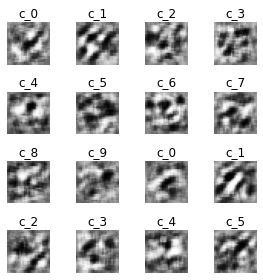

--------------------
Epoch 2/4


g_acc=0.90, g_loss=1.56, d_loss=1.25
Saved D checkpoint: ../gan_attack/checkpoints\it_1\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_1\c_generator_ckpt\ckpt-2


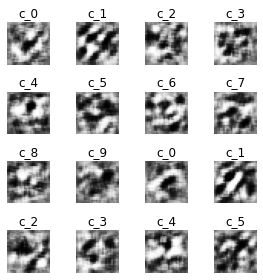

--------------------
Epoch 3/4


g_acc=0.90, g_loss=1.56, d_loss=1.25
Saved D checkpoint: ../gan_attack/checkpoints\it_1\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_1\c_generator_ckpt\ckpt-3
> no change inc: 1/5


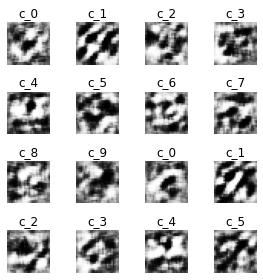

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.50, d_loss=1.28
Saved D checkpoint: ../gan_attack/checkpoints\it_1\d_middle_model\ckpt-5
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_1\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_1\c_generator_ckpt\ckpt-4


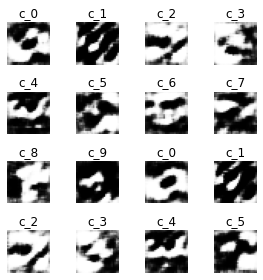


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


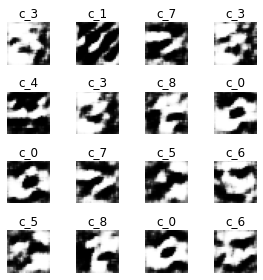

1 datasets gathered

only querying this iteration


Drop percentage: 0.3333333333333333

train_acc=0.0000%
accuracy of blackbox on G dataset: 97.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-9
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


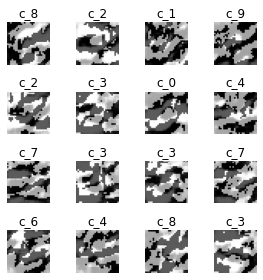

Drop percentage: 0.42857142857142855

train_acc=0.0000%
accuracy of blackbox on G dataset: 1.4286%
Saved checkpoint: ../gan_attack/checkpoints\it_1\blackbox_ckpt\ckpt-10
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_1\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.912

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.819 | Loss: 1.785

saved g_acc metric: [None, 0.96703124]
saved bb_acc metric: [None, None]
saved d_acc metric: [0.8298]
saved bb_ong_acc metric: [None, 1.0]
****************************************
Iteration 2

D Test Accuracy: 0.819 | Loss: 1.785

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.95, g_loss=1.67, d_loss=1.17
Saved D checkpoint: ../gan_attack/checkpoints\it_2\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_2\c_generator_ckpt\ckpt-1


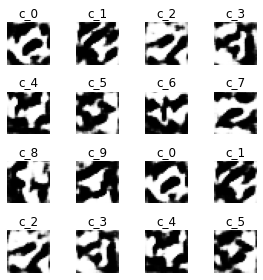

--------------------
Epoch 2/4


g_acc=0.93, g_loss=1.77, d_loss=1.10
Saved D checkpoint: ../gan_attack/checkpoints\it_2\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_2\c_generator_ckpt\ckpt-2
> no change inc: 1/5


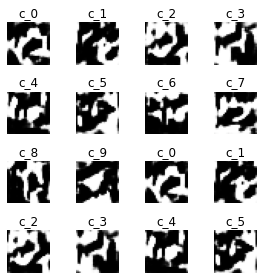

--------------------
Epoch 3/4


g_acc=0.96, g_loss=1.73, d_loss=1.13
Saved D checkpoint: ../gan_attack/checkpoints\it_2\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_2\c_generator_ckpt\ckpt-3


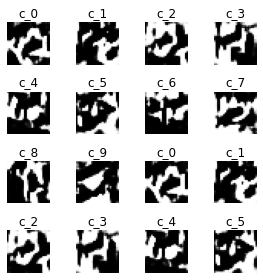

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.71, d_loss=1.14
Saved D checkpoint: ../gan_attack/checkpoints\it_2\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_2\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_2\c_generator_ckpt\ckpt-4
> no change inc: 1/5


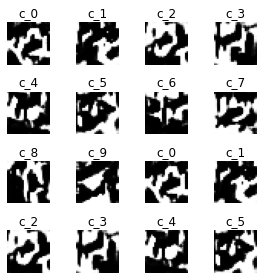


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


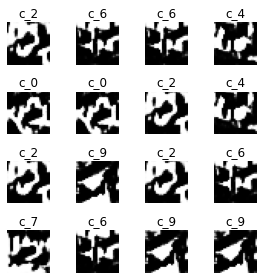

2 datasets gathered



Drop percentage: 0.5

train_acc=88.2174%
accuracy of blackbox on G dataset: 91.6667%
Saved checkpoint: ../gan_attack/checkpoints\it_2\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_2\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_2\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_2\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


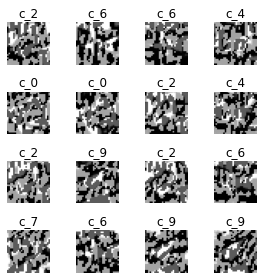

Drop percentage: 0.45454545454545453

train_acc=0.0000%
accuracy of blackbox on G dataset: 12.2917%
Saved checkpoint: ../gan_attack/checkpoints\it_2\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_2\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_2\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_2\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.883

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.870 | Loss: 1.591


D Test Accuracy: 0.751 | Loss: 1.808

saved g_acc metric: [None, 0.96703124, 0.9682031]
saved bb_acc metric: [None, None, 0.88217384]
saved d_acc metric: [0.8298, 0.8193]
saved bb_ong_acc metric: [None, 1.0, 0.87]
****************************************
Iteration 3

D Test Accuracy: 0.751 | Loss: 1.808

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.97, g_loss=1.70, d_loss=1.16
Saved D checkpoint: ../gan_attack/checkpoints\it_3\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_3\c_generator_ckpt\ckpt-1


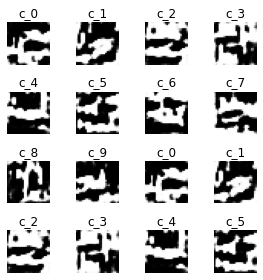

--------------------
Epoch 2/4


g_acc=0.95, g_loss=2.02, d_loss=0.94
Saved D checkpoint: ../gan_attack/checkpoints\it_3\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_3\c_generator_ckpt\ckpt-2


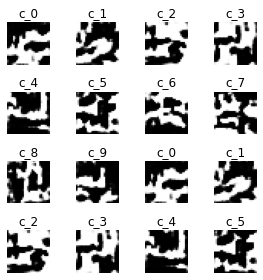

--------------------
Epoch 3/4


g_acc=0.97, g_loss=1.97, d_loss=0.97
Saved D checkpoint: ../gan_attack/checkpoints\it_3\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_3\c_generator_ckpt\ckpt-3


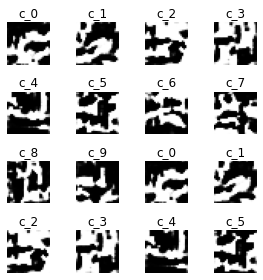

--------------------
Epoch 4/4


g_acc=0.93, g_loss=2.08, d_loss=0.90
Saved D checkpoint: ../gan_attack/checkpoints\it_3\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_3\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_3\c_generator_ckpt\ckpt-4


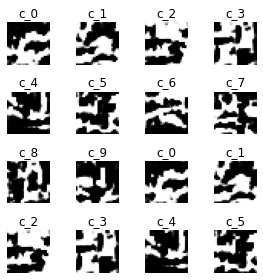


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


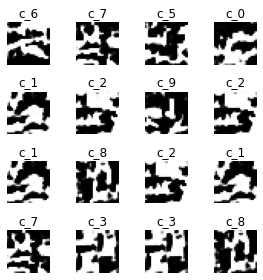

3 datasets gathered

only querying this iteration


Drop percentage: 0.4444444444444444

train_acc=0.0000%
accuracy of blackbox on G dataset: 84.8000%
Saved checkpoint: ../gan_attack/checkpoints\it_3\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_3\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_3\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_3\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


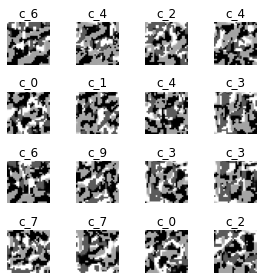

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 32.1429%
Saved checkpoint: ../gan_attack/checkpoints\it_3\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_3\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_3\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_3\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.855

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.670 | Loss: 1.789


D Test Accuracy: 0.786 | Loss: 1.785

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375]
saved bb_acc metric: [None, None, 0.88217384, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67]
****************************************
Iteration 4

D Test Accuracy: 0.786 | Loss: 1.785

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.63, d_loss=1.21
Saved D checkpoint: ../gan_attack/checkpoints\it_4\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_4\c_generator_ckpt\ckpt-1


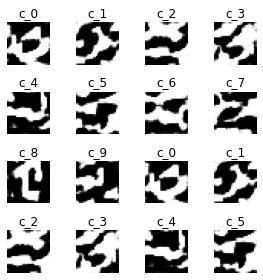

--------------------
Epoch 2/4


g_acc=0.97, g_loss=2.09, d_loss=0.90
Saved D checkpoint: ../gan_attack/checkpoints\it_4\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_4\c_generator_ckpt\ckpt-2
> no change inc: 1/5


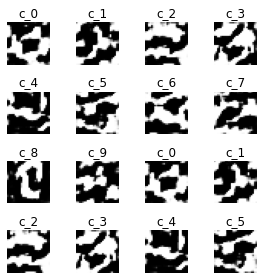

--------------------
Epoch 3/4


g_acc=0.97, g_loss=2.19, d_loss=0.84
Saved D checkpoint: ../gan_attack/checkpoints\it_4\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_4\c_generator_ckpt\ckpt-3
> no change inc: 2/5


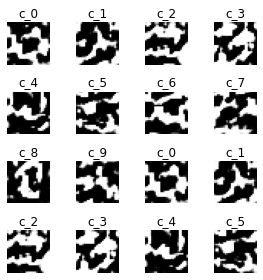

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.22, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_4\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_4\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_4\c_generator_ckpt\ckpt-4
> no change inc: 3/5


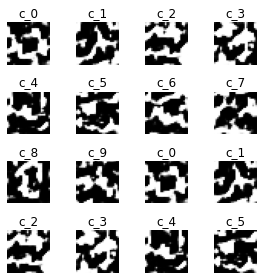


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


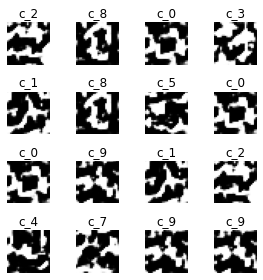

4 datasets gathered



Drop percentage: 0.5

train_acc=89.7114%
accuracy of blackbox on G dataset: 89.1667%
Saved checkpoint: ../gan_attack/checkpoints\it_4\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_4\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_4\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_4\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


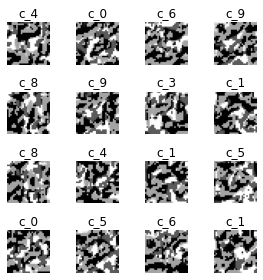

Drop percentage: 0.45454545454545453

train_acc=0.0000%
accuracy of blackbox on G dataset: 25.1923%
Saved checkpoint: ../gan_attack/checkpoints\it_4\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_4\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_4\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_4\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.895

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.821 | Loss: 1.717

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0]
****************************************
Iteration 5

D Test Accuracy: 0.821 | Loss: 1.717

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.97, g_loss=1.89, d_loss=1.02
Saved D checkpoint: ../gan_attack/checkpoints\it_5\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_5\c_generator_ckpt\ckpt-1


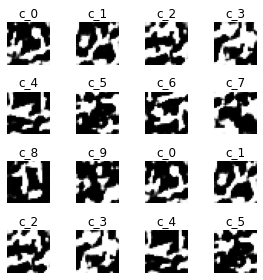

--------------------
Epoch 2/4


g_acc=0.95, g_loss=2.14, d_loss=0.87
Saved D checkpoint: ../gan_attack/checkpoints\it_5\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_5\c_generator_ckpt\ckpt-2
> no change inc: 1/5


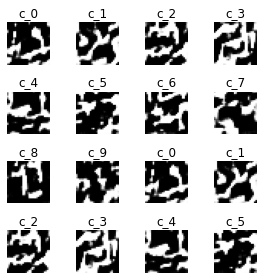

--------------------
Epoch 3/4


g_acc=0.97, g_loss=2.11, d_loss=0.89
Saved D checkpoint: ../gan_attack/checkpoints\it_5\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_5\c_generator_ckpt\ckpt-3


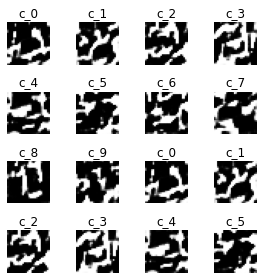

--------------------
Epoch 4/4


g_acc=0.96, g_loss=2.18, d_loss=0.85
Saved D checkpoint: ../gan_attack/checkpoints\it_5\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_5\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_5\c_generator_ckpt\ckpt-4
> no change inc: 1/5


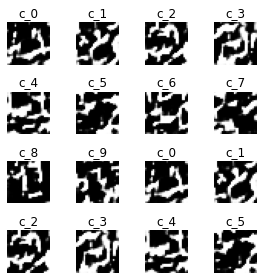


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


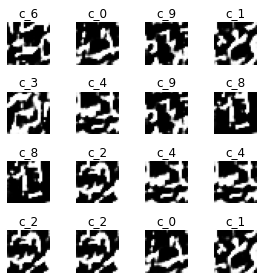

5 datasets gathered

only querying this iteration


Drop percentage: 0.4666666666666667

train_acc=0.0000%
accuracy of blackbox on G dataset: 87.1250%
Saved checkpoint: ../gan_attack/checkpoints\it_5\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_5\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_5\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_5\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


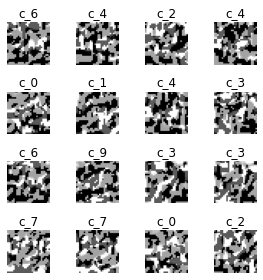

Drop percentage: 0.46153846153846156

train_acc=0.0000%
accuracy of blackbox on G dataset: 20.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_5\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_5\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_5\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_5\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.904

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.466


D Test Accuracy: 0.779 | Loss: 1.759

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0]
****************************************
Iteration 6

D Test Accuracy: 0.779 | Loss: 1.759

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.93, d_loss=1.00
Saved D checkpoint: ../gan_attack/checkpoints\it_6\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_6\c_generator_ckpt\ckpt-1


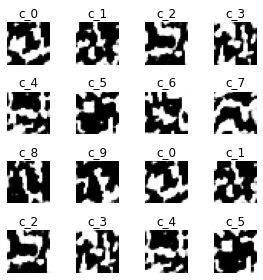

--------------------
Epoch 2/4


g_acc=0.95, g_loss=2.18, d_loss=0.85
Saved D checkpoint: ../gan_attack/checkpoints\it_6\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_6\c_generator_ckpt\ckpt-2
> no change inc: 1/5


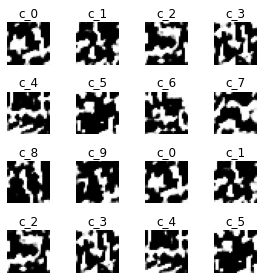

--------------------
Epoch 3/4


g_acc=0.97, g_loss=2.17, d_loss=0.85
Saved D checkpoint: ../gan_attack/checkpoints\it_6\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_6\c_generator_ckpt\ckpt-3
> no change inc: 2/5


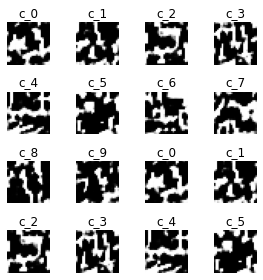

--------------------
Epoch 4/4


g_acc=0.95, g_loss=2.21, d_loss=0.83
Saved D checkpoint: ../gan_attack/checkpoints\it_6\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_6\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_6\c_generator_ckpt\ckpt-4
> no change inc: 3/5


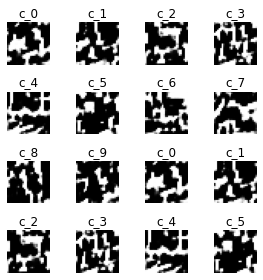


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


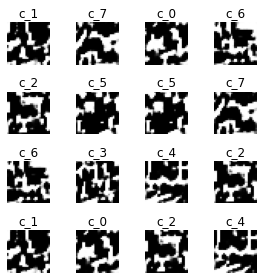

6 datasets gathered



Drop percentage: 0.5

train_acc=90.5244%
accuracy of blackbox on G dataset: 84.9000%
Saved checkpoint: ../gan_attack/checkpoints\it_6\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_6\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_6\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_6\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


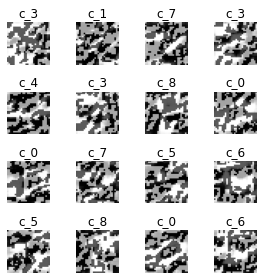

Drop percentage: 0.4666666666666667

train_acc=0.0000%
accuracy of blackbox on G dataset: 37.1053%
Saved checkpoint: ../gan_attack/checkpoints\it_6\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_6\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_6\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_6\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.879

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.468


D Test Accuracy: 0.770 | Loss: 1.824

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0]
****************************************
Iteration 7

D Test Accuracy: 0.770 | Loss: 1.824

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.78, d_loss=1.10
Saved D checkpoint: ../gan_attack/checkpoints\it_7\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_7\c_generator_ckpt\ckpt-1


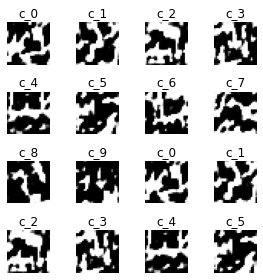

--------------------
Epoch 2/4


g_acc=0.96, g_loss=2.05, d_loss=0.92
Saved D checkpoint: ../gan_attack/checkpoints\it_7\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_7\c_generator_ckpt\ckpt-2
> no change inc: 1/5


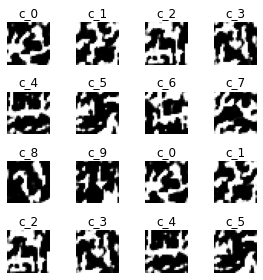

--------------------
Epoch 3/4


g_acc=0.98, g_loss=2.05, d_loss=0.92
Saved D checkpoint: ../gan_attack/checkpoints\it_7\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_7\c_generator_ckpt\ckpt-3
> no change inc: 2/5


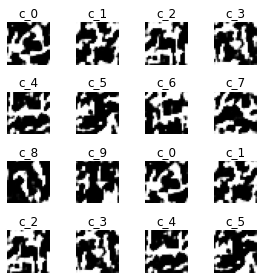

--------------------
Epoch 4/4


g_acc=0.94, g_loss=2.18, d_loss=0.85
Saved D checkpoint: ../gan_attack/checkpoints\it_7\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_7\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_7\c_generator_ckpt\ckpt-4


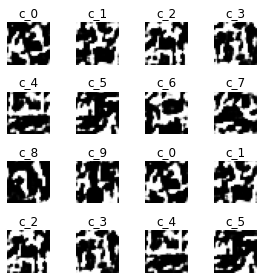


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


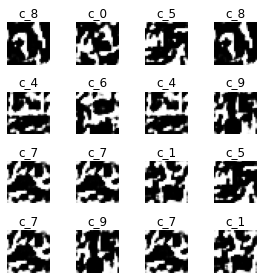

7 datasets gathered

only querying this iteration


Drop percentage: 0.47619047619047616

train_acc=0.0000%
accuracy of blackbox on G dataset: 83.9091%
Saved checkpoint: ../gan_attack/checkpoints\it_7\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_7\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_7\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_7\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


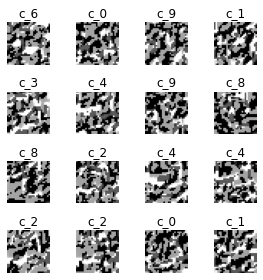

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 26.5625%
Saved checkpoint: ../gan_attack/checkpoints\it_7\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_7\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_7\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_7\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.885

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.740 | Loss: 1.705


D Test Accuracy: 0.758 | Loss: 1.798

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74]
****************************************
Iteration 8

D Test Accuracy: 0.758 | Loss: 1.798

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.95, g_loss=1.75, d_loss=1.12
Saved D checkpoint: ../gan_attack/checkpoints\it_8\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_8\c_generator_ckpt\ckpt-1


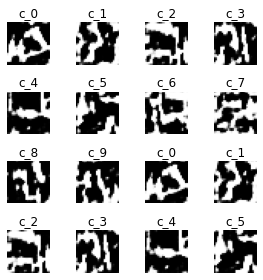

--------------------
Epoch 2/4


g_acc=0.97, g_loss=2.03, d_loss=0.94
Saved D checkpoint: ../gan_attack/checkpoints\it_8\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_8\c_generator_ckpt\ckpt-2
> no change inc: 1/5


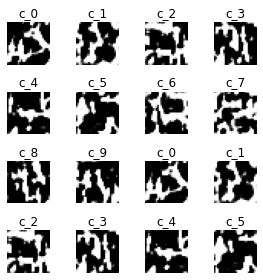

--------------------
Epoch 3/4


g_acc=0.96, g_loss=2.17, d_loss=0.85
Saved D checkpoint: ../gan_attack/checkpoints\it_8\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_8\c_generator_ckpt\ckpt-3
> no change inc: 2/5


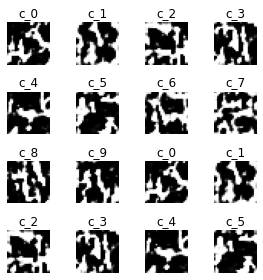

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.14, d_loss=0.87
Saved D checkpoint: ../gan_attack/checkpoints\it_8\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_8\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_8\c_generator_ckpt\ckpt-4
> no change inc: 3/5


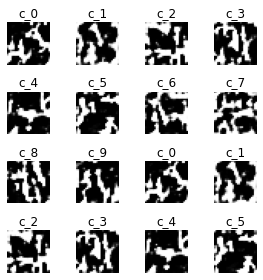


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


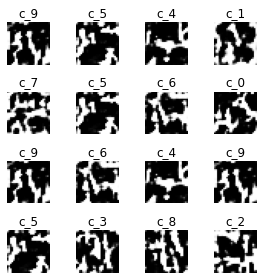

8 datasets gathered



Drop percentage: 0.5

train_acc=91.4852%
accuracy of blackbox on G dataset: 85.6667%
Saved checkpoint: ../gan_attack/checkpoints\it_8\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_8\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_8\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_8\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


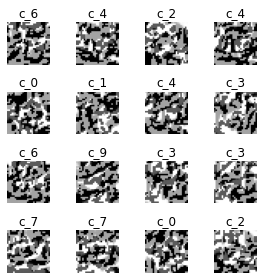

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 31.6129%
Saved checkpoint: ../gan_attack/checkpoints\it_8\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_8\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_8\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_8\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.887

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.860 | Loss: 1.598


D Test Accuracy: 0.783 | Loss: 1.793

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86]
****************************************
Iteration 9

D Test Accuracy: 0.783 | Loss: 1.793

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.90, d_loss=1.02
Saved D checkpoint: ../gan_attack/checkpoints\it_9\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_9\c_generator_ckpt\ckpt-1


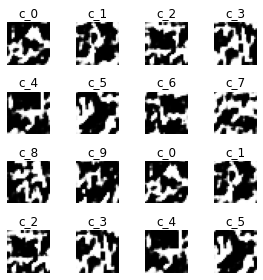

--------------------
Epoch 2/4


g_acc=0.95, g_loss=2.22, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_9\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_9\c_generator_ckpt\ckpt-2
> no change inc: 1/5


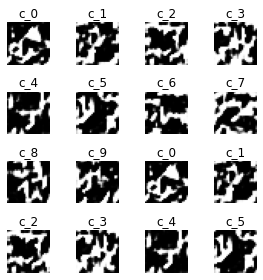

--------------------
Epoch 3/4


g_acc=0.98, g_loss=2.19, d_loss=0.84
Saved D checkpoint: ../gan_attack/checkpoints\it_9\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_9\c_generator_ckpt\ckpt-3


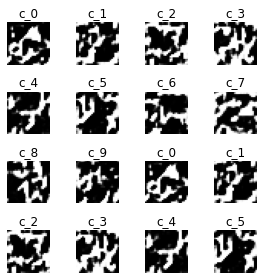

--------------------
Epoch 4/4


g_acc=0.96, g_loss=2.28, d_loss=0.79
Saved D checkpoint: ../gan_attack/checkpoints\it_9\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_9\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_9\c_generator_ckpt\ckpt-4


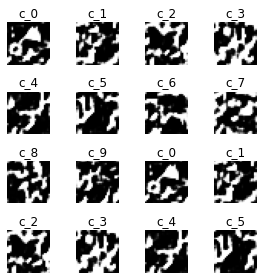


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


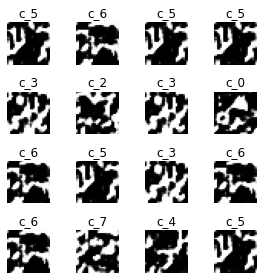

9 datasets gathered

only querying this iteration


Drop percentage: 0.48148148148148145

train_acc=0.0000%
accuracy of blackbox on G dataset: 85.5000%
Saved checkpoint: ../gan_attack/checkpoints\it_9\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_9\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_9\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_9\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


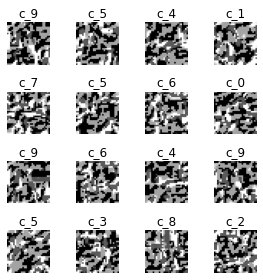

Drop percentage: 0.47368421052631576

train_acc=0.0000%
accuracy of blackbox on G dataset: 33.9773%
Saved checkpoint: ../gan_attack/checkpoints\it_9\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_9\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_9\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_9\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.878

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.840 | Loss: 1.601


D Test Accuracy: 0.682 | Loss: 1.879

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84]
****************************************
Iteration 10

D Test Accuracy: 0.682 | Loss: 1.879

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.94, d_loss=1.00
Saved D checkpoint: ../gan_attack/checkpoints\it_10\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_10\c_generator_ckpt\ckpt-1


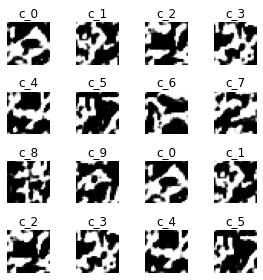

--------------------
Epoch 2/4


g_acc=0.97, g_loss=2.22, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_10\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_10\c_generator_ckpt\ckpt-2
> no change inc: 1/5


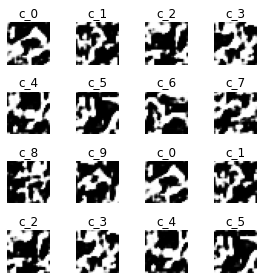

--------------------
Epoch 3/4


g_acc=0.97, g_loss=2.23, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_10\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_10\c_generator_ckpt\ckpt-3
> no change inc: 2/5


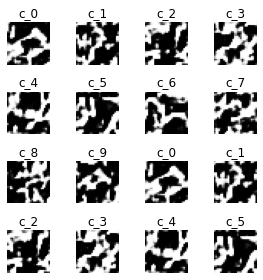

--------------------
Epoch 4/4


g_acc=0.94, g_loss=2.28, d_loss=0.79
Saved D checkpoint: ../gan_attack/checkpoints\it_10\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_10\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_10\c_generator_ckpt\ckpt-4


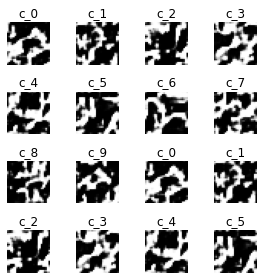


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


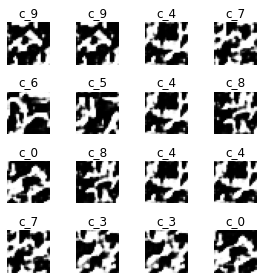

10 datasets gathered



Drop percentage: 0.5

train_acc=91.3141%
accuracy of blackbox on G dataset: 87.3125%
Saved checkpoint: ../gan_attack/checkpoints\it_10\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_10\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_10\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_10\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


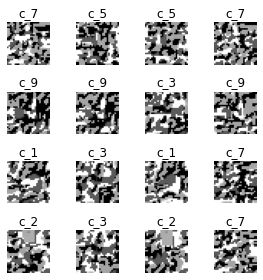

Drop percentage: 0.47619047619047616

train_acc=0.0000%
accuracy of blackbox on G dataset: 29.2553%
Saved checkpoint: ../gan_attack/checkpoints\it_10\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_10\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_10\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_10\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.893

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.950 | Loss: 1.511


D Test Accuracy: 0.675 | Loss: 1.906

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95]
****************************************
Iteration 11

D Test Accuracy: 0.675 | Loss: 1.906

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.94, g_loss=2.03, d_loss=0.94
Saved D checkpoint: ../gan_attack/checkpoints\it_11\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_11\c_generator_ckpt\ckpt-1


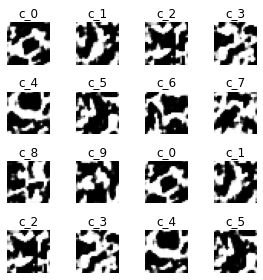

--------------------
Epoch 2/4


g_acc=0.93, g_loss=2.28, d_loss=0.79
Saved D checkpoint: ../gan_attack/checkpoints\it_11\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_11\c_generator_ckpt\ckpt-2
> no change inc: 1/5


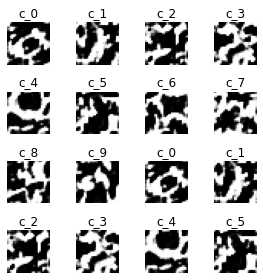

--------------------
Epoch 3/4


g_acc=0.96, g_loss=2.26, d_loss=0.80
Saved D checkpoint: ../gan_attack/checkpoints\it_11\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_11\c_generator_ckpt\ckpt-3


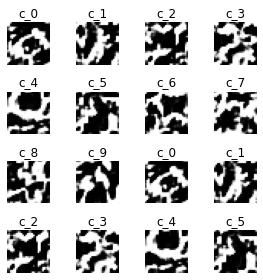

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.25, d_loss=0.81
Saved D checkpoint: ../gan_attack/checkpoints\it_11\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_11\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_11\c_generator_ckpt\ckpt-4
> no change inc: 1/5


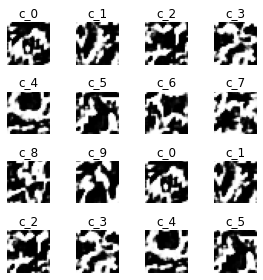


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


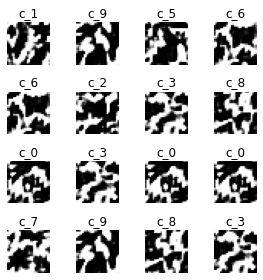

11 datasets gathered

only querying this iteration


Drop percentage: 0.48484848484848486

train_acc=0.0000%
accuracy of blackbox on G dataset: 83.8824%
Saved checkpoint: ../gan_attack/checkpoints\it_11\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_11\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_11\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_11\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


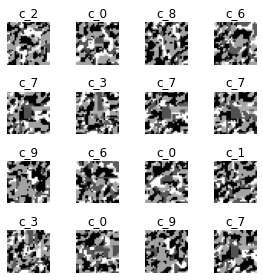

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 37.4545%
Saved checkpoint: ../gan_attack/checkpoints\it_11\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_11\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_11\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_11\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.889

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.880 | Loss: 1.548


D Test Accuracy: 0.709 | Loss: 1.856

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88]
****************************************
Iteration 12

D Test Accuracy: 0.709 | Loss: 1.856

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.95, g_loss=2.10, d_loss=0.90
Saved D checkpoint: ../gan_attack/checkpoints\it_12\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_12\c_generator_ckpt\ckpt-1


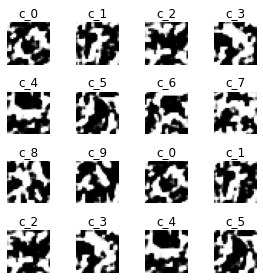

--------------------
Epoch 2/4


g_acc=0.97, g_loss=2.26, d_loss=0.80
Saved D checkpoint: ../gan_attack/checkpoints\it_12\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_12\c_generator_ckpt\ckpt-2
> no change inc: 1/5


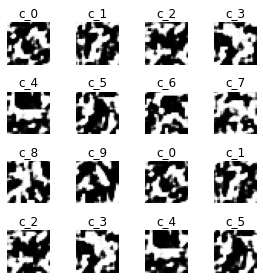

--------------------
Epoch 3/4


g_acc=0.98, g_loss=2.25, d_loss=0.81
Saved D checkpoint: ../gan_attack/checkpoints\it_12\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_12\c_generator_ckpt\ckpt-3
> no change inc: 2/5


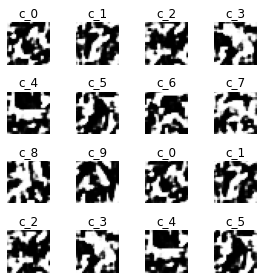

--------------------
Epoch 4/4


g_acc=0.93, g_loss=2.30, d_loss=0.77
Saved D checkpoint: ../gan_attack/checkpoints\it_12\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_12\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_12\c_generator_ckpt\ckpt-4


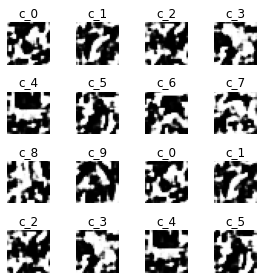


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


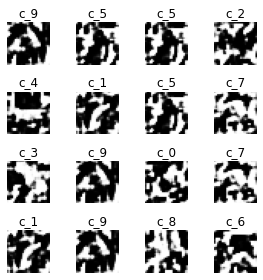

12 datasets gathered



Drop percentage: 0.5

train_acc=92.2074%
accuracy of blackbox on G dataset: 83.3810%
Saved checkpoint: ../gan_attack/checkpoints\it_12\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_12\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_12\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_12\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


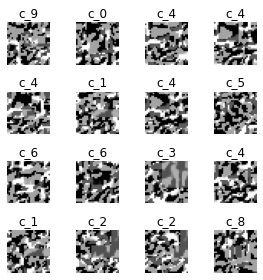

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 33.5593%
Saved checkpoint: ../gan_attack/checkpoints\it_12\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_12\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_12\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_12\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.877

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.478


D Test Accuracy: 0.665 | Loss: 1.911

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0]
****************************************
Iteration 13

D Test Accuracy: 0.665 | Loss: 1.911

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the current D


--------------------
Epoch 1/4


g_acc=0.95, g_loss=1.96, d_loss=0.99
Saved D checkpoint: ../gan_attack/checkpoints\it_13\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_13\c_generator_ckpt\ckpt-1


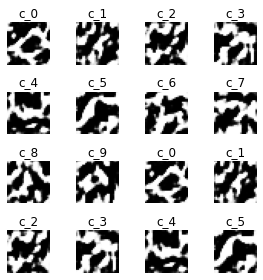

--------------------
Epoch 2/4


g_acc=0.94, g_loss=2.25, d_loss=0.80
Saved D checkpoint: ../gan_attack/checkpoints\it_13\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_13\c_generator_ckpt\ckpt-2
> no change inc: 1/5


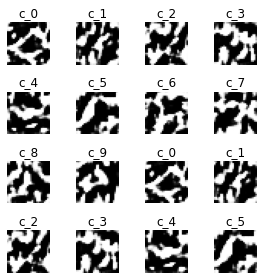

--------------------
Epoch 3/4


g_acc=0.97, g_loss=2.22, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_13\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_13\c_generator_ckpt\ckpt-3


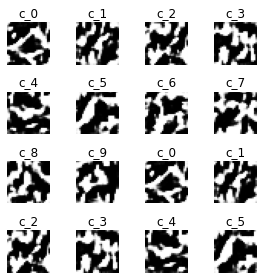

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.20, d_loss=0.83
Saved D checkpoint: ../gan_attack/checkpoints\it_13\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_13\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_13\c_generator_ckpt\ckpt-4
> no change inc: 1/5


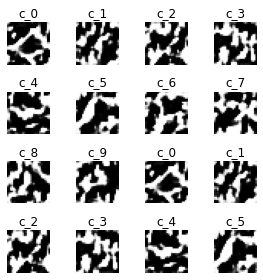


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


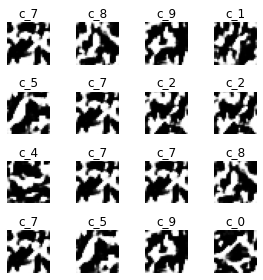

13 datasets gathered

only querying this iteration


Drop percentage: 0.48717948717948717

train_acc=0.0000%
accuracy of blackbox on G dataset: 86.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_13\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_13\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_13\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_13\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


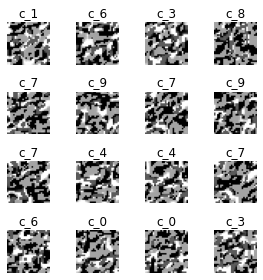

Drop percentage: 0.48

train_acc=0.0000%
accuracy of blackbox on G dataset: 30.0000%
Saved checkpoint: ../gan_attack/checkpoints\it_13\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_13\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_13\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_13\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.892

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.900 | Loss: 1.561


D Test Accuracy: 0.682 | Loss: 1.876

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9]
****************************************
Iteration 14

D Test Accuracy: 0.682 | Loss: 1.876

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - performed until cG converges with the

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.83, d_loss=1.07
Saved D checkpoint: ../gan_attack/checkpoints\it_14\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_14\c_generator_ckpt\ckpt-1


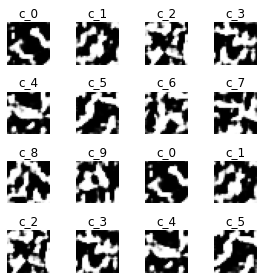

--------------------
Epoch 2/4


g_acc=0.96, g_loss=2.18, d_loss=0.84
Saved D checkpoint: ../gan_attack/checkpoints\it_14\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_14\c_generator_ckpt\ckpt-2
> no change inc: 1/5


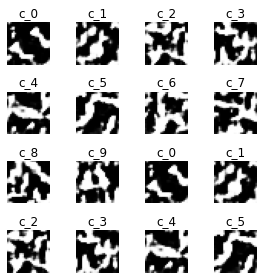

--------------------
Epoch 3/4


g_acc=0.98, g_loss=2.15, d_loss=0.87
Saved D checkpoint: ../gan_attack/checkpoints\it_14\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_14\c_generator_ckpt\ckpt-3


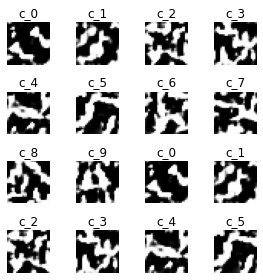

--------------------
Epoch 4/4


g_acc=0.94, g_loss=2.23, d_loss=0.81
Saved D checkpoint: ../gan_attack/checkpoints\it_14\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_14\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_14\c_generator_ckpt\ckpt-4


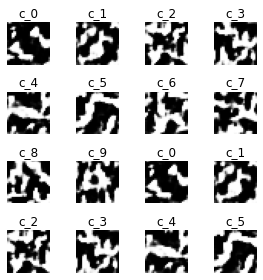


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


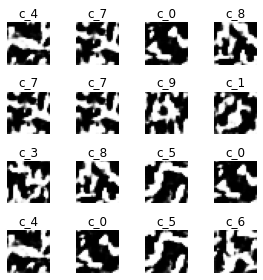

14 datasets gathered



Drop percentage: 0.5

train_acc=92.5179%
accuracy of blackbox on G dataset: 86.9412%
Saved checkpoint: ../gan_attack/checkpoints\it_14\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_14\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_14\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_14\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


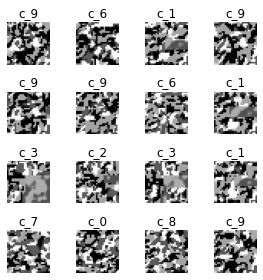

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 32.3469%
Saved checkpoint: ../gan_attack/checkpoints\it_14\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_14\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_14\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_14\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.896

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.920 | Loss: 1.541


D Test Accuracy: 0.661 | Loss: 1.903

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92]
****************************************
Iteration 15

D Test Accuracy: 0.661 | Loss: 1.903

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 3.2: Training cG
 - p

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.98, d_loss=0.97
Saved D checkpoint: ../gan_attack/checkpoints\it_15\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_15\c_generator_ckpt\ckpt-1


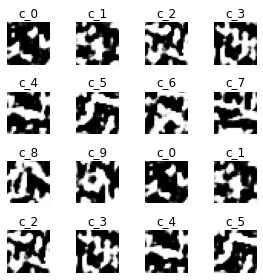

--------------------
Epoch 2/4


g_acc=0.98, g_loss=2.08, d_loss=0.90
Saved D checkpoint: ../gan_attack/checkpoints\it_15\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_15\c_generator_ckpt\ckpt-2
> no change inc: 1/5


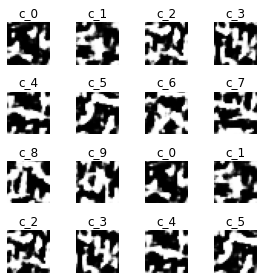

--------------------
Epoch 3/4


g_acc=0.95, g_loss=2.22, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_15\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_15\c_generator_ckpt\ckpt-3


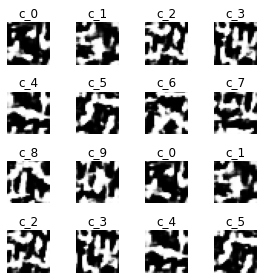

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.19, d_loss=0.84
Saved D checkpoint: ../gan_attack/checkpoints\it_15\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_15\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_15\c_generator_ckpt\ckpt-4
> no change inc: 1/5


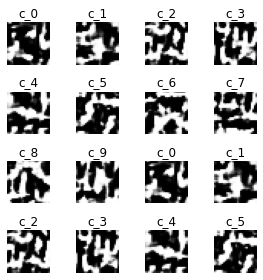


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


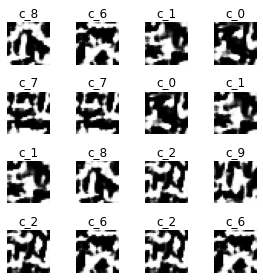

15 datasets gathered

only querying this iteration


Drop percentage: 0.4888888888888889

train_acc=0.0000%
accuracy of blackbox on G dataset: 87.1304%
Saved checkpoint: ../gan_attack/checkpoints\it_15\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_15\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_15\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_15\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


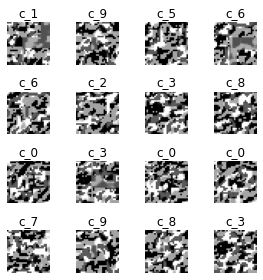

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 35.2273%
Saved checkpoint: ../gan_attack/checkpoints\it_15\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_15\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_15\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_15\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.902

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.810 | Loss: 1.651


D Test Accuracy: 0.660 | Loss: 1.899

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92, 0.81]
****************************************
Iteration 16

D Test Accuracy: 0.660 | Loss: 1.899

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

--------------------
Epoch 1/4


g_acc=0.93, g_loss=1.83, d_loss=1.07
Saved D checkpoint: ../gan_attack/checkpoints\it_16\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_16\c_generator_ckpt\ckpt-1


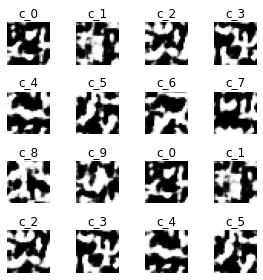

--------------------
Epoch 2/4


g_acc=0.96, g_loss=2.03, d_loss=0.93
Saved D checkpoint: ../gan_attack/checkpoints\it_16\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_16\c_generator_ckpt\ckpt-2


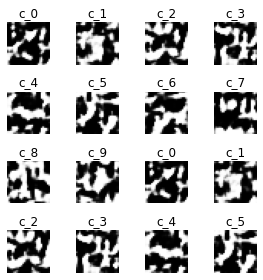

--------------------
Epoch 3/4


g_acc=0.95, g_loss=2.17, d_loss=0.85
Saved D checkpoint: ../gan_attack/checkpoints\it_16\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_16\c_generator_ckpt\ckpt-3
> no change inc: 1/5


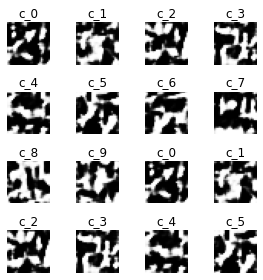

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.14, d_loss=0.87
Saved D checkpoint: ../gan_attack/checkpoints\it_16\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_16\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_16\c_generator_ckpt\ckpt-4
> no change inc: 2/5


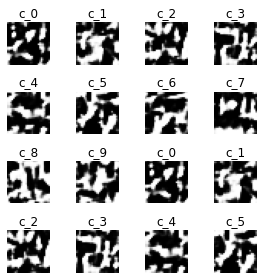


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


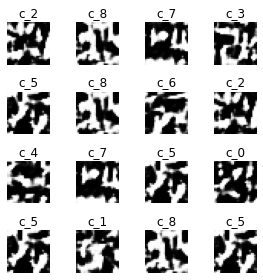

16 datasets gathered



Drop percentage: 0.5

train_acc=92.9277%
accuracy of blackbox on G dataset: 87.8636%
Saved checkpoint: ../gan_attack/checkpoints\it_16\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_16\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_16\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_16\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


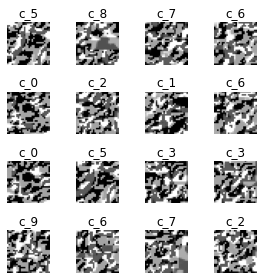

Drop percentage: 0.48148148148148145

train_acc=0.0000%
accuracy of blackbox on G dataset: 41.3636%
Saved checkpoint: ../gan_attack/checkpoints\it_16\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_16\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_16\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_16\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.903

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.474


D Test Accuracy: 0.675 | Loss: 1.882

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92, 0.81, 1.0]
****************************************
Iteration 17

D Test Accuracy: 0.675 | Loss: 1.882

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx



--------------------
Epoch 1/4


g_acc=0.98, g_loss=1.99, d_loss=0.96
Saved D checkpoint: ../gan_attack/checkpoints\it_17\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_17\c_generator_ckpt\ckpt-1


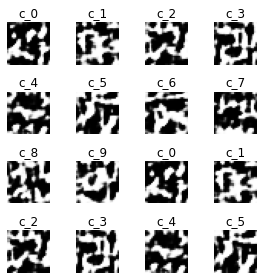

--------------------
Epoch 2/4


g_acc=0.92, g_loss=2.26, d_loss=0.80
Saved D checkpoint: ../gan_attack/checkpoints\it_17\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_17\c_generator_ckpt\ckpt-2


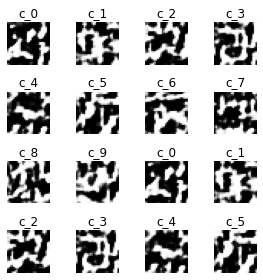

--------------------
Epoch 3/4


g_acc=0.96, g_loss=2.23, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_17\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_17\c_generator_ckpt\ckpt-3


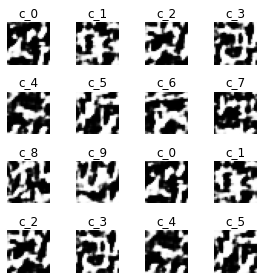

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.21, d_loss=0.83
Saved D checkpoint: ../gan_attack/checkpoints\it_17\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_17\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_17\c_generator_ckpt\ckpt-4
> no change inc: 1/5


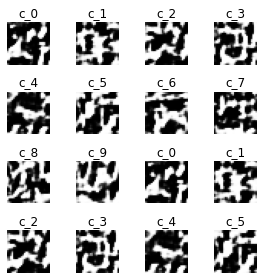


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


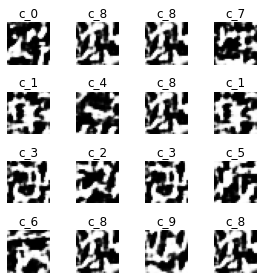

17 datasets gathered

only querying this iteration


Drop percentage: 0.49019607843137253

train_acc=0.0000%
accuracy of blackbox on G dataset: 87.5769%
Saved checkpoint: ../gan_attack/checkpoints\it_17\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_17\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_17\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_17\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


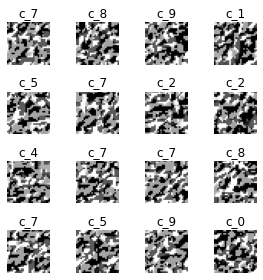

Drop percentage: 0.4838709677419355

train_acc=0.0000%
accuracy of blackbox on G dataset: 38.8158%
Saved checkpoint: ../gan_attack/checkpoints\it_17\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_17\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_17\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_17\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.890

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.624 | Loss: 1.922

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92, 0.81, 1.0, 1.0]
****************************************
Iteration 18

D Test Accuracy: 0.624 | Loss: 1.922

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
SKIPPED STEPS 1 & 2
xxxxxxxxxxx

--------------------
Epoch 1/4


g_acc=0.94, g_loss=2.02, d_loss=0.95
Saved D checkpoint: ../gan_attack/checkpoints\it_18\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_18\c_generator_ckpt\ckpt-1


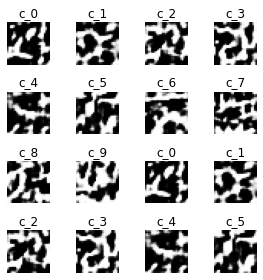

--------------------
Epoch 2/4


g_acc=0.97, g_loss=2.21, d_loss=0.83
Saved D checkpoint: ../gan_attack/checkpoints\it_18\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_18\c_generator_ckpt\ckpt-2


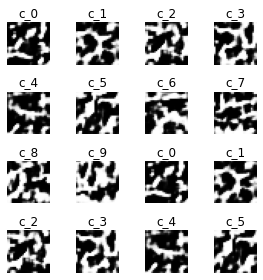

--------------------
Epoch 3/4


g_acc=0.98, g_loss=2.18, d_loss=0.85
Saved D checkpoint: ../gan_attack/checkpoints\it_18\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_18\c_generator_ckpt\ckpt-3
> no change inc: 1/5


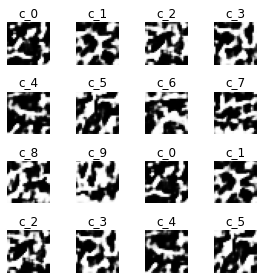

--------------------
Epoch 4/4


g_acc=0.96, g_loss=2.25, d_loss=0.80
Saved D checkpoint: ../gan_attack/checkpoints\it_18\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_18\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_18\c_generator_ckpt\ckpt-4
> no change inc: 2/5


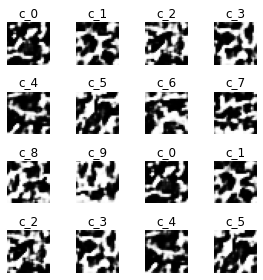


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


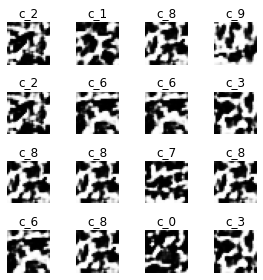

18 datasets gathered



Drop percentage: 0.5

train_acc=93.3409%
accuracy of blackbox on G dataset: 85.9333%
Saved checkpoint: ../gan_attack/checkpoints\it_18\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_18\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_18\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_18\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


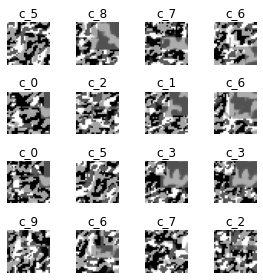

Drop percentage: 0.4857142857142857

train_acc=0.0000%
accuracy of blackbox on G dataset: 41.3636%
Saved checkpoint: ../gan_attack/checkpoints\it_18\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_18\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_18\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_18\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.895

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.890 | Loss: 1.572


D Test Accuracy: 0.587 | Loss: 1.933

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92, 0.81, 1.0, 1.0, 0.89]
****************************************
Iteration 19

D Test Accuracy: 0.587 | Loss: 1.933

xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.80, d_loss=1.09
Saved D checkpoint: ../gan_attack/checkpoints\it_19\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_19\c_generator_ckpt\ckpt-1


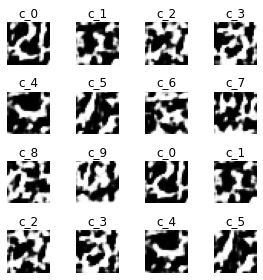

--------------------
Epoch 2/4


g_acc=0.93, g_loss=2.25, d_loss=0.80
Saved D checkpoint: ../gan_attack/checkpoints\it_19\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_19\c_generator_ckpt\ckpt-2


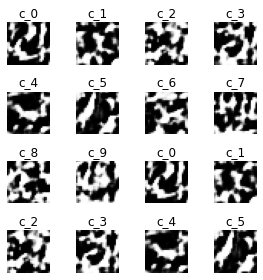

--------------------
Epoch 3/4


g_acc=0.98, g_loss=2.20, d_loss=0.83
Saved D checkpoint: ../gan_attack/checkpoints\it_19\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_19\c_generator_ckpt\ckpt-3


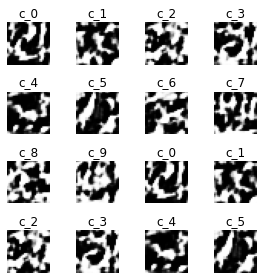

--------------------
Epoch 4/4


g_acc=0.92, g_loss=2.28, d_loss=0.79
Saved D checkpoint: ../gan_attack/checkpoints\it_19\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_19\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_19\c_generator_ckpt\ckpt-4


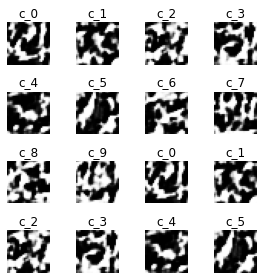


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


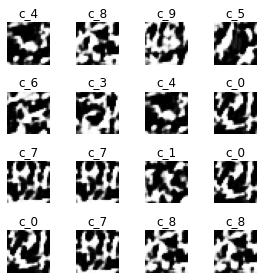

19 datasets gathered

only querying this iteration


Drop percentage: 0.49122807017543857

train_acc=0.0000%
accuracy of blackbox on G dataset: 85.4483%
Saved checkpoint: ../gan_attack/checkpoints\it_19\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_19\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_19\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_19\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


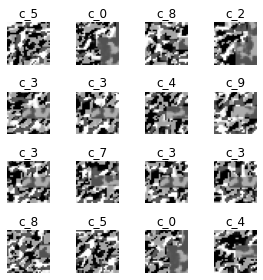

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 37.4000%
Saved checkpoint: ../gan_attack/checkpoints\it_19\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_19\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_19\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_19\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.891

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.910 | Loss: 1.550


D Test Accuracy: 0.743 | Loss: 1.838

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92, 0.81, 1.0, 1.0, 0.89, 0.91]
****************************************
Iteration 20

D Test Accuracy: 0.743 | Loss: 1.838

xxxxxxx

--------------------
Epoch 1/4


g_acc=0.95, g_loss=2.00, d_loss=0.96
Saved D checkpoint: ../gan_attack/checkpoints\it_20\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_20\c_generator_ckpt\ckpt-1


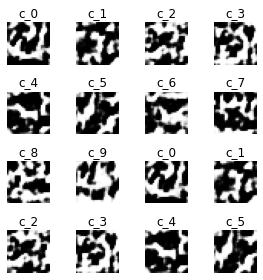

--------------------
Epoch 2/4


g_acc=0.95, g_loss=2.24, d_loss=0.81
Saved D checkpoint: ../gan_attack/checkpoints\it_20\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_20\c_generator_ckpt\ckpt-2
> no change inc: 1/5


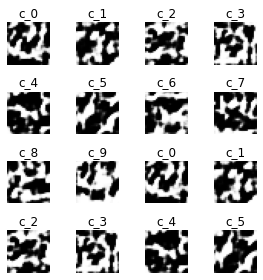

--------------------
Epoch 3/4


g_acc=0.97, g_loss=2.24, d_loss=0.81
Saved D checkpoint: ../gan_attack/checkpoints\it_20\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_20\c_generator_ckpt\ckpt-3


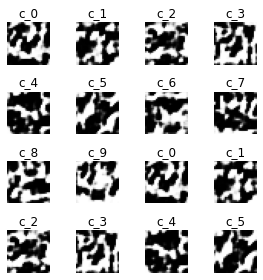

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.21, d_loss=0.83
Saved D checkpoint: ../gan_attack/checkpoints\it_20\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_20\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_20\c_generator_ckpt\ckpt-4
> no change inc: 1/5


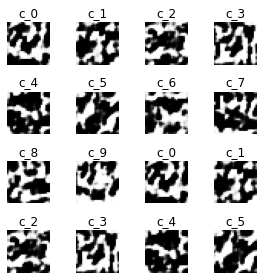


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


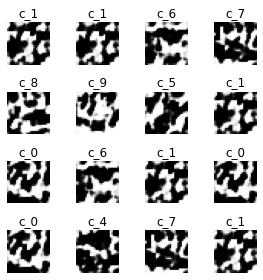

20 datasets gathered



Drop percentage: 0.5

train_acc=93.4031%
accuracy of blackbox on G dataset: 85.4815%
Saved checkpoint: ../gan_attack/checkpoints\it_20\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_20\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_20\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_20\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


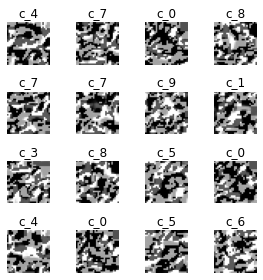

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 33.2639%
Saved checkpoint: ../gan_attack/checkpoints\it_20\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_20\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_20\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_20\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.894

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.940 | Loss: 1.519


D Test Accuracy: 0.748 | Loss: 1.831

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92, 0.81, 1.0, 1.0, 0.89, 0.91, 0.94]
****************************************
Iteration 21

D Test Ac

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.85, d_loss=1.06
Saved D checkpoint: ../gan_attack/checkpoints\it_21\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_21\c_generator_ckpt\ckpt-1


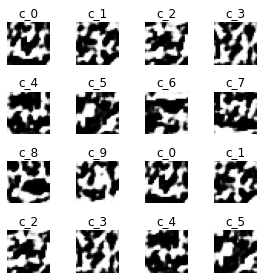

--------------------
Epoch 2/4


g_acc=0.96, g_loss=2.13, d_loss=0.88
Saved D checkpoint: ../gan_attack/checkpoints\it_21\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_21\c_generator_ckpt\ckpt-2
> no change inc: 1/5


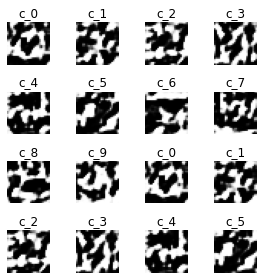

--------------------
Epoch 3/4


g_acc=0.92, g_loss=2.23, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_21\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_21\c_generator_ckpt\ckpt-3


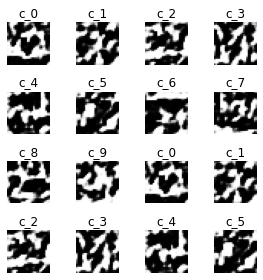

--------------------
Epoch 4/4


g_acc=0.95, g_loss=2.20, d_loss=0.83
Saved D checkpoint: ../gan_attack/checkpoints\it_21\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_21\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_21\c_generator_ckpt\ckpt-4


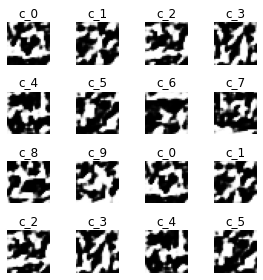


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


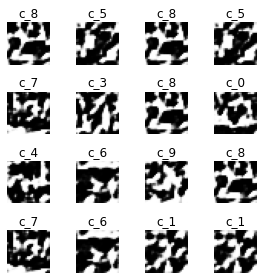

21 datasets gathered

only querying this iteration


Drop percentage: 0.49206349206349204

train_acc=0.0000%
accuracy of blackbox on G dataset: 81.5938%
Saved checkpoint: ../gan_attack/checkpoints\it_21\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_21\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_21\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_21\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


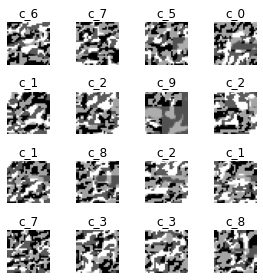

Drop percentage: 0.4864864864864865

train_acc=0.0000%
accuracy of blackbox on G dataset: 34.2697%
Saved checkpoint: ../gan_attack/checkpoints\it_21\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_21\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_21\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_21\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.881

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.790 | Loss: 1.671


D Test Accuracy: 0.734 | Loss: 1.849

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92, 0.81, 1.0, 1.0, 0.89, 0.91, 0.94, 0.79]
********************************

--------------------
Epoch 1/4


g_acc=0.94, g_loss=1.88, d_loss=1.04
Saved D checkpoint: ../gan_attack/checkpoints\it_22\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_22\c_generator_ckpt\ckpt-1


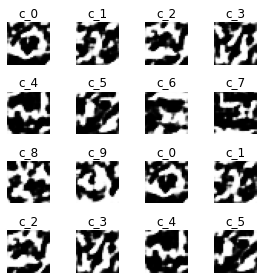

--------------------
Epoch 2/4


g_acc=0.98, g_loss=2.04, d_loss=0.93
Saved D checkpoint: ../gan_attack/checkpoints\it_22\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_22\c_generator_ckpt\ckpt-2


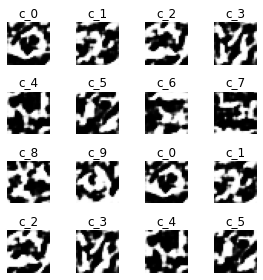

--------------------
Epoch 3/4


g_acc=0.96, g_loss=2.17, d_loss=0.85
Saved D checkpoint: ../gan_attack/checkpoints\it_22\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_22\c_generator_ckpt\ckpt-3


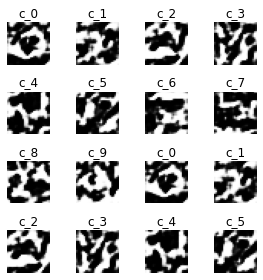

--------------------
Epoch 4/4


g_acc=0.98, g_loss=2.14, d_loss=0.87
Saved D checkpoint: ../gan_attack/checkpoints\it_22\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_22\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_22\c_generator_ckpt\ckpt-4
> no change inc: 1/5


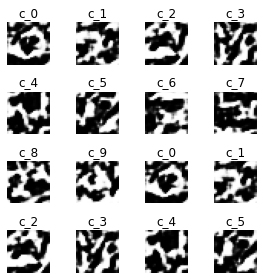


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


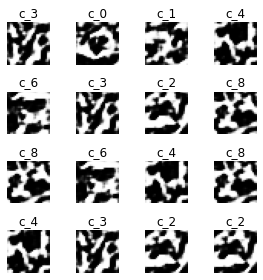

22 datasets gathered



Drop percentage: 0.5

train_acc=93.7146%
accuracy of blackbox on G dataset: 86.7105%
Saved checkpoint: ../gan_attack/checkpoints\it_22\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_22\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_22\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_22\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


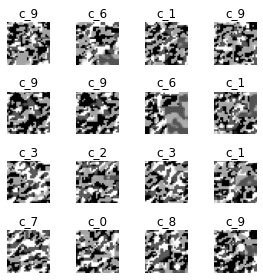

Drop percentage: 0.4883720930232558

train_acc=0.0000%
accuracy of blackbox on G dataset: 32.7885%
Saved checkpoint: ../gan_attack/checkpoints\it_22\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_22\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_22\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_22\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.899

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.930 | Loss: 1.531


D Test Accuracy: 0.621 | Loss: 1.900

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484, 0.7343]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92, 0.81, 1.0, 1.0, 0.89, 0.91, 0.94, 0.79, 0

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.80, d_loss=1.09
Saved D checkpoint: ../gan_attack/checkpoints\it_23\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_23\c_generator_ckpt\ckpt-1


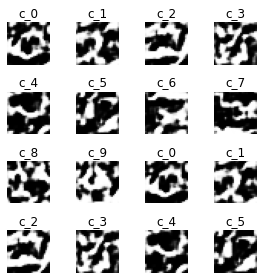

--------------------
Epoch 2/4


g_acc=0.96, g_loss=2.17, d_loss=0.85
Saved D checkpoint: ../gan_attack/checkpoints\it_23\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_23\c_generator_ckpt\ckpt-2
> no change inc: 1/5


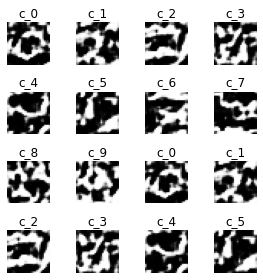

--------------------
Epoch 3/4


g_acc=0.96, g_loss=2.22, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_23\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_23\c_generator_ckpt\ckpt-3
> no change inc: 2/5


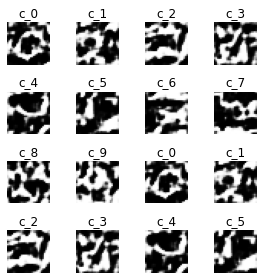

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.23, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_23\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_23\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_23\c_generator_ckpt\ckpt-4
> no change inc: 3/5


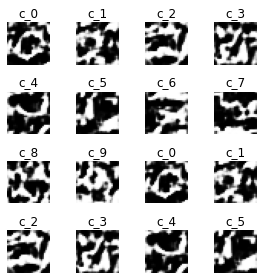


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


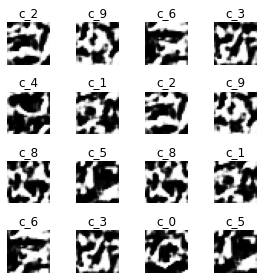

23 datasets gathered

only querying this iteration


Drop percentage: 0.4927536231884058

train_acc=0.0000%
accuracy of blackbox on G dataset: 83.3714%
Saved checkpoint: ../gan_attack/checkpoints\it_23\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_23\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_23\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_23\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


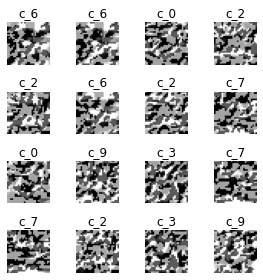

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 45.6771%
Saved checkpoint: ../gan_attack/checkpoints\it_23\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_23\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_23\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_23\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.898

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.920 | Loss: 1.541


D Test Accuracy: 0.641 | Loss: 1.905

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484, 0.7343, 0.6211]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 1.0, 0.9, 0.92, 0.81, 1.0, 1.0,

--------------------
Epoch 1/4


g_acc=0.94, g_loss=1.76, d_loss=1.12
Saved D checkpoint: ../gan_attack/checkpoints\it_24\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_24\c_generator_ckpt\ckpt-1


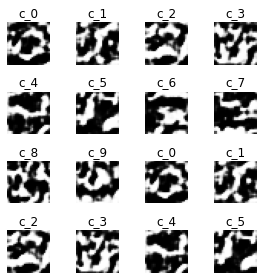

--------------------
Epoch 2/4


g_acc=0.97, g_loss=2.10, d_loss=0.90
Saved D checkpoint: ../gan_attack/checkpoints\it_24\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_24\c_generator_ckpt\ckpt-2


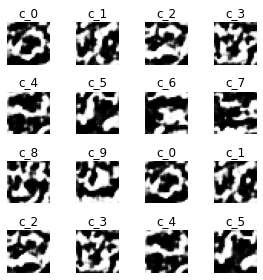

--------------------
Epoch 3/4


g_acc=0.96, g_loss=2.21, d_loss=0.83
Saved D checkpoint: ../gan_attack/checkpoints\it_24\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_24\c_generator_ckpt\ckpt-3
> no change inc: 1/5


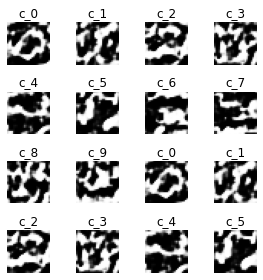

--------------------
Epoch 4/4


g_acc=0.97, g_loss=2.18, d_loss=0.84
Saved D checkpoint: ../gan_attack/checkpoints\it_24\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_24\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_24\c_generator_ckpt\ckpt-4
> no change inc: 2/5


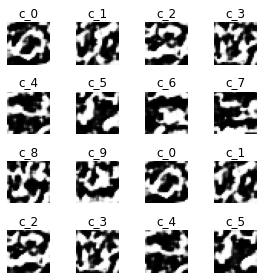


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


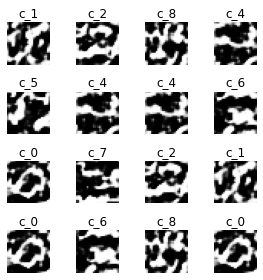

24 datasets gathered



Drop percentage: 0.5

train_acc=93.7934%
accuracy of blackbox on G dataset: 84.6842%
Saved checkpoint: ../gan_attack/checkpoints\it_24\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_24\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_24\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_24\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


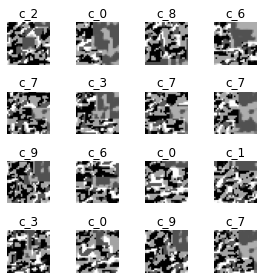

Drop percentage: 0.4883720930232558

train_acc=0.0000%
accuracy of blackbox on G dataset: 35.5093%
Saved checkpoint: ../gan_attack/checkpoints\it_24\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_24\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_24\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_24\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.894

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.697 | Loss: 1.877

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484, 0.7343, 0.6211, 0.6415]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.86, 0.84, 0.95, 0.88, 

--------------------
Epoch 1/4


g_acc=0.95, g_loss=2.03, d_loss=0.94
Saved D checkpoint: ../gan_attack/checkpoints\it_25\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_25\c_generator_ckpt\ckpt-1


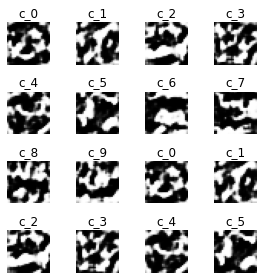

--------------------
Epoch 2/4


g_acc=0.97, g_loss=2.04, d_loss=0.93
Saved D checkpoint: ../gan_attack/checkpoints\it_25\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_25\c_generator_ckpt\ckpt-2


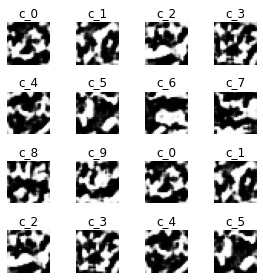

--------------------
Epoch 3/4


g_acc=0.98, g_loss=1.97, d_loss=0.97
Saved D checkpoint: ../gan_attack/checkpoints\it_25\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_25\c_generator_ckpt\ckpt-3
> no change inc: 1/5


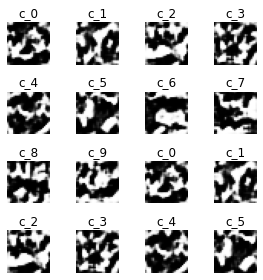

--------------------
Epoch 4/4


g_acc=0.90, g_loss=2.25, d_loss=0.80
Saved D checkpoint: ../gan_attack/checkpoints\it_25\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_25\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_25\c_generator_ckpt\ckpt-4


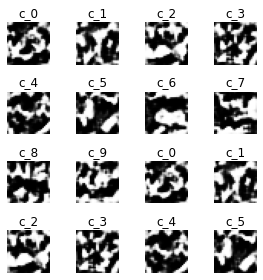


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


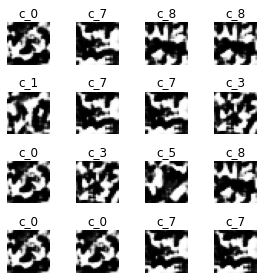

25 datasets gathered

only querying this iteration


Drop percentage: 0.49333333333333335

train_acc=0.0000%
accuracy of blackbox on G dataset: 83.8421%
Saved checkpoint: ../gan_attack/checkpoints\it_25\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_25\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_25\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_25\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


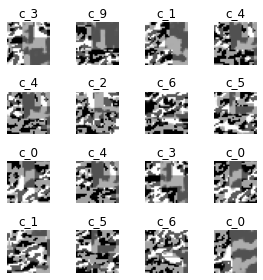

Drop percentage: 0.4883720930232558

train_acc=0.0000%
accuracy of blackbox on G dataset: 44.6698%
Saved checkpoint: ../gan_attack/checkpoints\it_25\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_25\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_25\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_25\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.890

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.700 | Loss: 1.756


D Test Accuracy: 0.733 | Loss: 1.845

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484, 0.7343, 0.6211, 0.6415, 0.6969]
saved bb_ong_acc metric: [None, 1.0, 0.87, 0.67, 1.0, 1.0, 1.0, 0.74, 0.

--------------------
Epoch 1/4


g_acc=0.95, g_loss=1.82, d_loss=1.07
Saved D checkpoint: ../gan_attack/checkpoints\it_26\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_26\c_generator_ckpt\ckpt-1


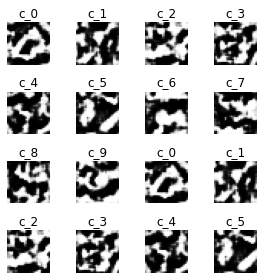

--------------------
Epoch 2/4


g_acc=0.98, g_loss=1.97, d_loss=0.98
Saved D checkpoint: ../gan_attack/checkpoints\it_26\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_26\c_generator_ckpt\ckpt-2


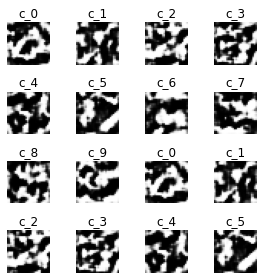

--------------------
Epoch 3/4


g_acc=0.97, g_loss=2.02, d_loss=0.95
Saved D checkpoint: ../gan_attack/checkpoints\it_26\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_26\c_generator_ckpt\ckpt-3
> no change inc: 1/5


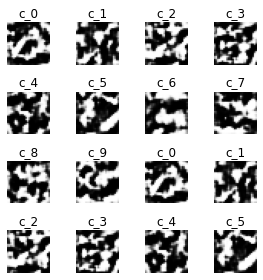

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.98, d_loss=0.97
Saved D checkpoint: ../gan_attack/checkpoints\it_26\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_26\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_26\c_generator_ckpt\ckpt-4
> no change inc: 2/5


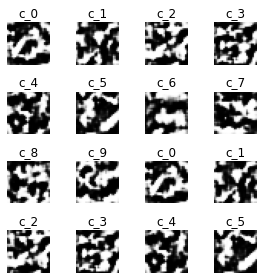


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


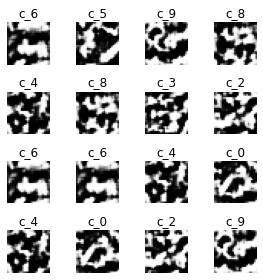

26 datasets gathered



Drop percentage: 0.5

train_acc=93.7325%
accuracy of blackbox on G dataset: 86.9211%
Saved checkpoint: ../gan_attack/checkpoints\it_26\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_26\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_26\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_26\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


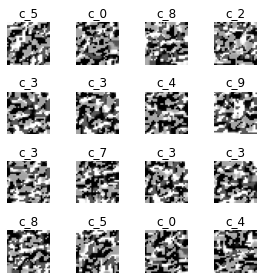

Drop percentage: 0.4883720930232558

train_acc=0.0000%
accuracy of blackbox on G dataset: 39.9519%
Saved checkpoint: ../gan_attack/checkpoints\it_26\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_26\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_26\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_26\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.907

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.790 | Loss: 1.670


D Test Accuracy: 0.641 | Loss: 1.894

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484, 0.7343, 0.6211, 0.6415, 0.6969, 0.7327]
saved bb_ong_acc metric: [None, 1.0, 0.87,

--------------------
Epoch 1/4


g_acc=0.97, g_loss=1.56, d_loss=1.25
Saved D checkpoint: ../gan_attack/checkpoints\it_27\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_27\c_generator_ckpt\ckpt-1


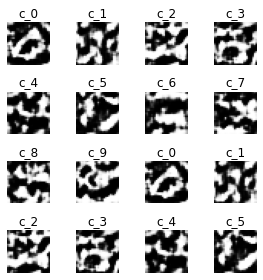

--------------------
Epoch 2/4


g_acc=0.91, g_loss=2.07, d_loss=0.91
Saved D checkpoint: ../gan_attack/checkpoints\it_27\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_27\c_generator_ckpt\ckpt-2


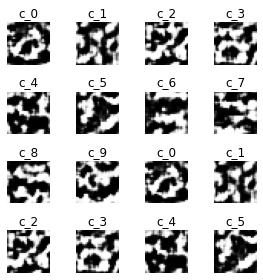

--------------------
Epoch 3/4


g_acc=0.97, g_loss=1.93, d_loss=1.00
Saved D checkpoint: ../gan_attack/checkpoints\it_27\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_27\c_generator_ckpt\ckpt-3


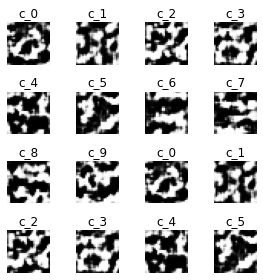

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.95, d_loss=0.99
Saved D checkpoint: ../gan_attack/checkpoints\it_27\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_27\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_27\c_generator_ckpt\ckpt-4
> no change inc: 1/5


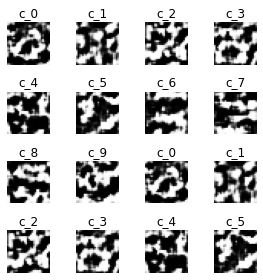


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


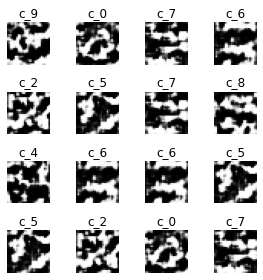

27 datasets gathered

only querying this iteration


Drop percentage: 0.49382716049382713

train_acc=0.0000%
accuracy of blackbox on G dataset: 86.1951%
Saved checkpoint: ../gan_attack/checkpoints\it_27\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_27\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_27\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_27\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


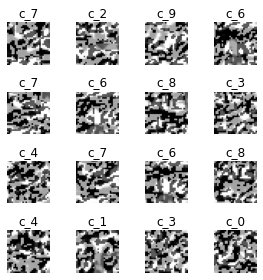

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 41.5929%
Saved checkpoint: ../gan_attack/checkpoints\it_27\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_27\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_27\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_27\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.904

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.750 | Loss: 1.689


D Test Accuracy: 0.649 | Loss: 1.895

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484, 0.7343, 0.6211, 0.6415, 0.6969, 0.7327, 0.6413]
saved bb_ong_acc

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.84, d_loss=1.06
Saved D checkpoint: ../gan_attack/checkpoints\it_28\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_28\c_generator_ckpt\ckpt-1


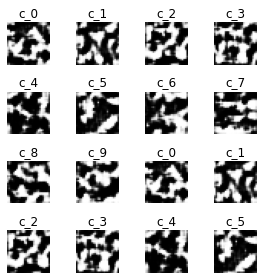

--------------------
Epoch 2/4


g_acc=0.95, g_loss=2.04, d_loss=0.93
Saved D checkpoint: ../gan_attack/checkpoints\it_28\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_28\c_generator_ckpt\ckpt-2
> no change inc: 1/5


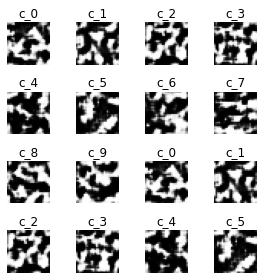

--------------------
Epoch 3/4


g_acc=0.96, g_loss=1.95, d_loss=0.99
Saved D checkpoint: ../gan_attack/checkpoints\it_28\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_28\c_generator_ckpt\ckpt-3
> no change inc: 2/5


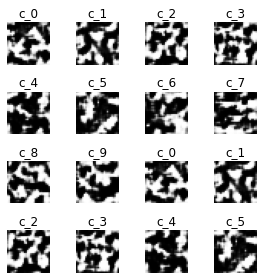

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.92, d_loss=1.01
Saved D checkpoint: ../gan_attack/checkpoints\it_28\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_28\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_28\c_generator_ckpt\ckpt-4
> no change inc: 3/5


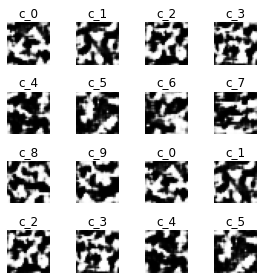


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


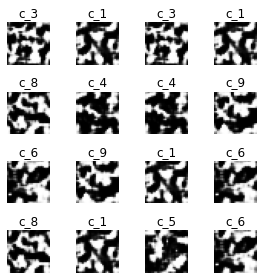

28 datasets gathered



Drop percentage: 0.5

train_acc=94.5051%
accuracy of blackbox on G dataset: 85.2857%
Saved checkpoint: ../gan_attack/checkpoints\it_28\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_28\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_28\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_28\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


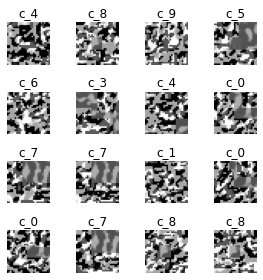

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 42.7407%
Saved checkpoint: ../gan_attack/checkpoints\it_28\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_28\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_28\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_28\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.904

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.473


D Test Accuracy: 0.499 | Loss: 1.994

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484, 0.7343, 0.6211, 0.6415, 0.6969, 0.7327, 0

--------------------
Epoch 1/4


g_acc=0.98, g_loss=1.87, d_loss=1.04
Saved D checkpoint: ../gan_attack/checkpoints\it_29\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_29\c_generator_ckpt\ckpt-1


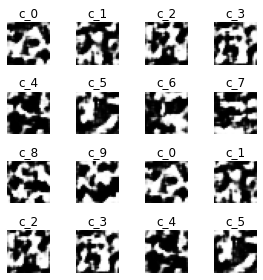

--------------------
Epoch 2/4


g_acc=0.94, g_loss=2.04, d_loss=0.93
Saved D checkpoint: ../gan_attack/checkpoints\it_29\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_29\c_generator_ckpt\ckpt-2


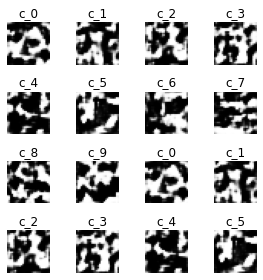

--------------------
Epoch 3/4


g_acc=0.96, g_loss=1.99, d_loss=0.96
Saved D checkpoint: ../gan_attack/checkpoints\it_29\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_29\c_generator_ckpt\ckpt-3
> no change inc: 1/5


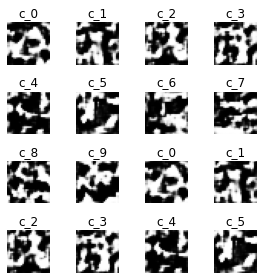

--------------------
Epoch 4/4


g_acc=0.96, g_loss=1.95, d_loss=0.99
Saved D checkpoint: ../gan_attack/checkpoints\it_29\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_29\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_29\c_generator_ckpt\ckpt-4
> no change inc: 2/5


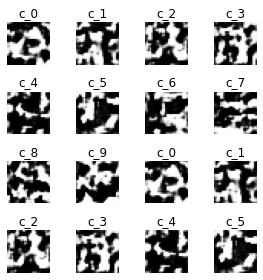


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


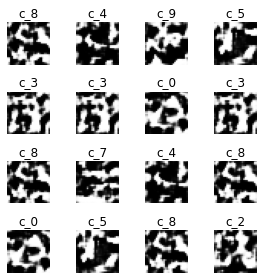

29 datasets gathered

only querying this iteration


Drop percentage: 0.4942528735632184

train_acc=0.0000%
accuracy of blackbox on G dataset: 85.1591%
Saved checkpoint: ../gan_attack/checkpoints\it_29\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_29\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_29\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_29\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


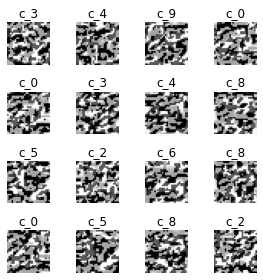

Drop percentage: 0.4897959183673469

train_acc=0.0000%
accuracy of blackbox on G dataset: 43.0992%
Saved checkpoint: ../gan_attack/checkpoints\it_29\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_29\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_29\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_29\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.898

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.850 | Loss: 1.611


D Test Accuracy: 0.431 | Loss: 2.053

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484, 0.7343, 0.6211, 0.6415, 

--------------------
Epoch 1/4


g_acc=0.95, g_loss=1.88, d_loss=1.04
Saved D checkpoint: ../gan_attack/checkpoints\it_30\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_30\c_generator_ckpt\ckpt-1


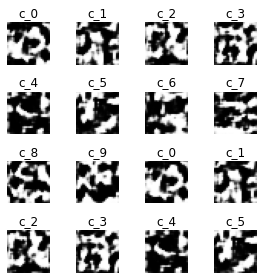

--------------------
Epoch 2/4


g_acc=0.97, g_loss=2.02, d_loss=0.94
Saved D checkpoint: ../gan_attack/checkpoints\it_30\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_30\c_generator_ckpt\ckpt-2


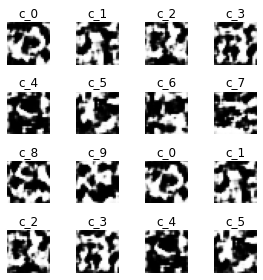

--------------------
Epoch 3/4


g_acc=0.91, g_loss=2.22, d_loss=0.82
Saved D checkpoint: ../gan_attack/checkpoints\it_30\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_30\c_generator_ckpt\ckpt-3


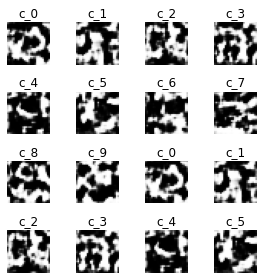

--------------------
Epoch 4/4


g_acc=0.93, g_loss=2.15, d_loss=0.87
Saved D checkpoint: ../gan_attack/checkpoints\it_30\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_30\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_30\c_generator_ckpt\ckpt-4
> no change inc: 1/5


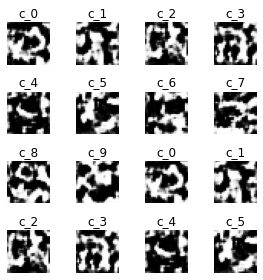


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


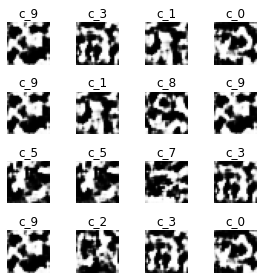

30 datasets gathered



Drop percentage: 0.5

train_acc=94.4991%
accuracy of blackbox on G dataset: 84.5000%
Saved checkpoint: ../gan_attack/checkpoints\it_30\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_30\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_30\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_30\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


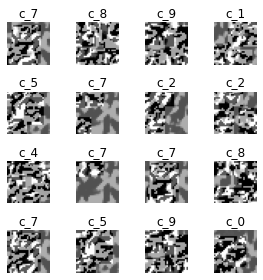

Drop percentage: 0.49019607843137253

train_acc=0.0000%
accuracy of blackbox on G dataset: 46.7578%
Saved checkpoint: ../gan_attack/checkpoints\it_30\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_30\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_30\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_30\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.901

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.860 | Loss: 1.601


D Test Accuracy: 0.490 | Loss: 2.010

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 0.743, 0.7484, 0.

--------------------
Epoch 1/4


g_acc=0.98, g_loss=1.49, d_loss=1.29
Saved D checkpoint: ../gan_attack/checkpoints\it_31\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_31\c_generator_ckpt\ckpt-1


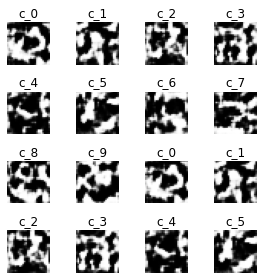

--------------------
Epoch 2/4


g_acc=0.97, g_loss=1.87, d_loss=1.04
Saved D checkpoint: ../gan_attack/checkpoints\it_31\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_31\c_generator_ckpt\ckpt-2
> no change inc: 1/5


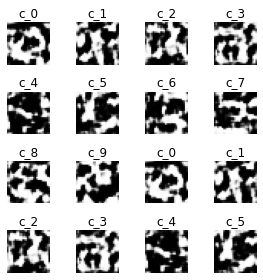

--------------------
Epoch 3/4


g_acc=0.91, g_loss=2.20, d_loss=0.84
Saved D checkpoint: ../gan_attack/checkpoints\it_31\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_31\c_generator_ckpt\ckpt-3


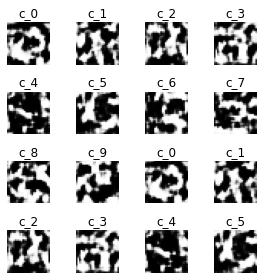

--------------------
Epoch 4/4


g_acc=0.94, g_loss=2.13, d_loss=0.88
Saved D checkpoint: ../gan_attack/checkpoints\it_31\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_31\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_31\c_generator_ckpt\ckpt-4


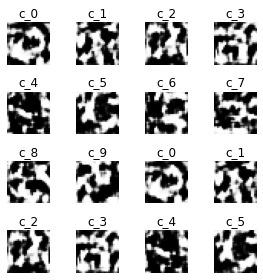


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


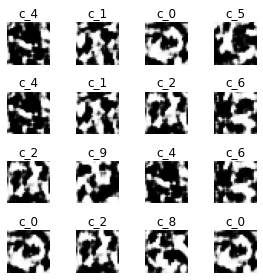

31 datasets gathered

only querying this iteration


Drop percentage: 0.4946236559139785

train_acc=0.0000%
accuracy of blackbox on G dataset: 85.7872%
Saved checkpoint: ../gan_attack/checkpoints\it_31\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_31\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_31\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_31\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


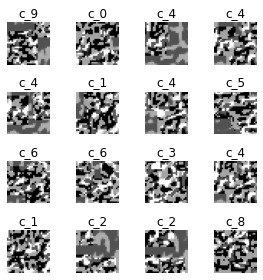

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 49.6311%
Saved checkpoint: ../gan_attack/checkpoints\it_31\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_31\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_31\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_31\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.906

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.462


D Test Accuracy: 0.451 | Loss: 2.043

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 0.6755, 0.6237, 0.5869, 

--------------------
Epoch 1/4


g_acc=0.95, g_loss=1.81, d_loss=1.08
Saved D checkpoint: ../gan_attack/checkpoints\it_32\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_32\c_generator_ckpt\ckpt-1


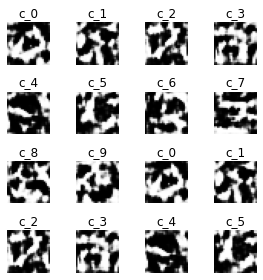

--------------------
Epoch 2/4


g_acc=0.97, g_loss=1.68, d_loss=1.16
Saved D checkpoint: ../gan_attack/checkpoints\it_32\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_32\c_generator_ckpt\ckpt-2


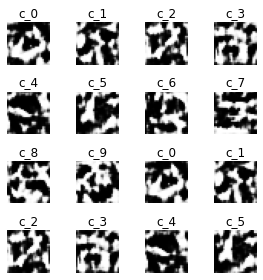

--------------------
Epoch 3/4


g_acc=0.92, g_loss=1.88, d_loss=1.04
Saved D checkpoint: ../gan_attack/checkpoints\it_32\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_32\c_generator_ckpt\ckpt-3


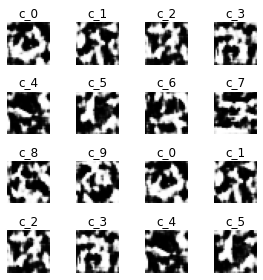

--------------------
Epoch 4/4


g_acc=0.96, g_loss=1.79, d_loss=1.10
Saved D checkpoint: ../gan_attack/checkpoints\it_32\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_32\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_32\c_generator_ckpt\ckpt-4


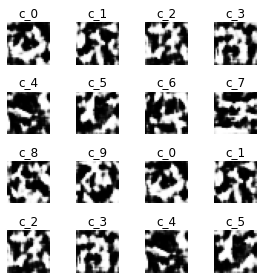


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


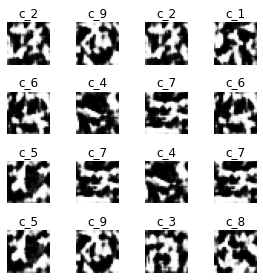

32 datasets gathered



Drop percentage: 0.5

train_acc=94.5644%
accuracy of blackbox on G dataset: 84.8293%
Saved checkpoint: ../gan_attack/checkpoints\it_32\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_32\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_32\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_32\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


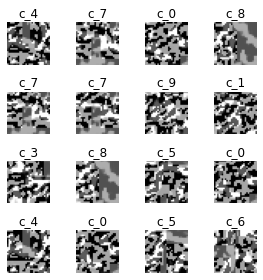

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 49.1743%
Saved checkpoint: ../gan_attack/checkpoints\it_32\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_32\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_32\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_32\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.904

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.463


D Test Accuracy: 0.620 | Loss: 1.927

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815, 0.6615, 0.6597, 

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.91, d_loss=1.02
Saved D checkpoint: ../gan_attack/checkpoints\it_33\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_33\c_generator_ckpt\ckpt-1


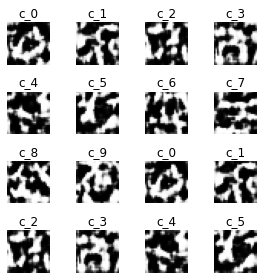

--------------------
Epoch 2/4


g_acc=0.95, g_loss=2.05, d_loss=0.93
Saved D checkpoint: ../gan_attack/checkpoints\it_33\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_33\c_generator_ckpt\ckpt-2
> no change inc: 1/5


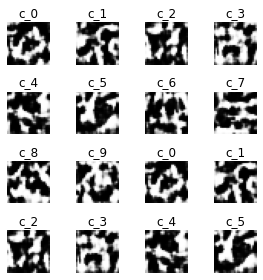

--------------------
Epoch 3/4


g_acc=0.96, g_loss=1.99, d_loss=0.96
Saved D checkpoint: ../gan_attack/checkpoints\it_33\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_33\c_generator_ckpt\ckpt-3
> no change inc: 2/5


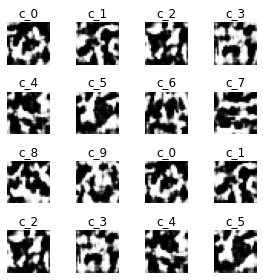

--------------------
Epoch 4/4


g_acc=0.96, g_loss=1.93, d_loss=1.00
Saved D checkpoint: ../gan_attack/checkpoints\it_33\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_33\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_33\c_generator_ckpt\ckpt-4
> no change inc: 3/5


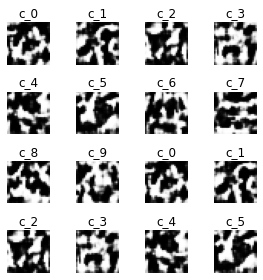


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


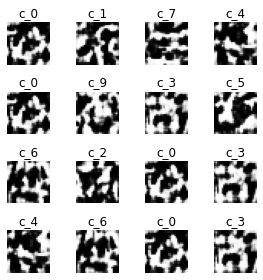

33 datasets gathered

only querying this iteration


Drop percentage: 0.494949494949495

train_acc=0.0000%
accuracy of blackbox on G dataset: 84.6600%
Saved checkpoint: ../gan_attack/checkpoints\it_33\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_33\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_33\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_33\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


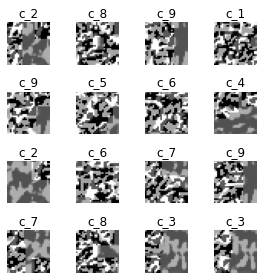

Drop percentage: 0.4909090909090909

train_acc=0.0000%
accuracy of blackbox on G dataset: 50.1471%
Saved checkpoint: ../gan_attack/checkpoints\it_33\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_33\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_33\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_33\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.896

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.940 | Loss: 1.522


D Test Accuracy: 0.670 | Loss: 1.892

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0.7086, 0.6649, 0.6815

--------------------
Epoch 1/4


g_acc=0.98, g_loss=1.49, d_loss=1.29
Saved D checkpoint: ../gan_attack/checkpoints\it_34\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_34\c_generator_ckpt\ckpt-1


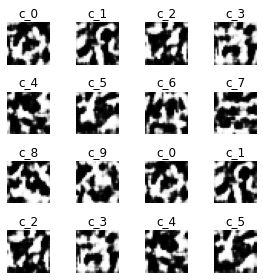

--------------------
Epoch 2/4


g_acc=0.89, g_loss=2.03, d_loss=0.94
Saved D checkpoint: ../gan_attack/checkpoints\it_34\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_34\c_generator_ckpt\ckpt-2


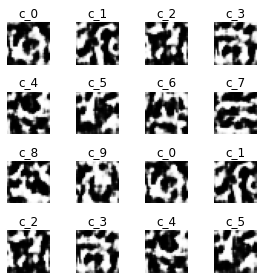

--------------------
Epoch 3/4


g_acc=0.95, g_loss=1.98, d_loss=0.97
Saved D checkpoint: ../gan_attack/checkpoints\it_34\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_34\c_generator_ckpt\ckpt-3


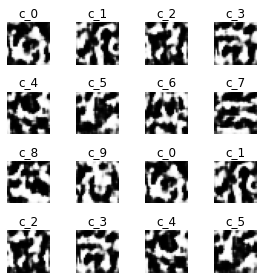

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.89, d_loss=1.03
Saved D checkpoint: ../gan_attack/checkpoints\it_34\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_34\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_34\c_generator_ckpt\ckpt-4


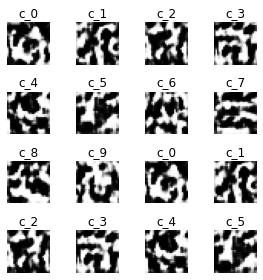


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


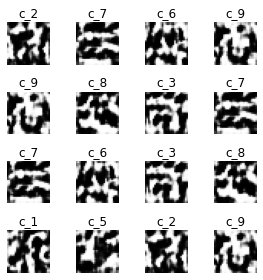

34 datasets gathered



Drop percentage: 0.5

train_acc=94.5862%
accuracy of blackbox on G dataset: 83.5385%
Saved checkpoint: ../gan_attack/checkpoints\it_34\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_34\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_34\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_34\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


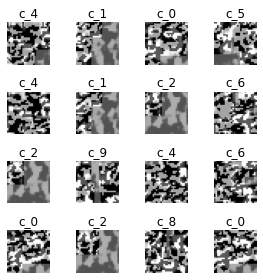

Drop percentage: 0.49122807017543857

train_acc=0.0000%
accuracy of blackbox on G dataset: 48.3094%
Saved checkpoint: ../gan_attack/checkpoints\it_34\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_34\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_34\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_34\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.890

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.820 | Loss: 1.638


D Test Accuracy: 0.599 | Loss: 1.937

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828, 0.6821, 0.6752, 0

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.61, d_loss=1.22
Saved D checkpoint: ../gan_attack/checkpoints\it_35\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_35\c_generator_ckpt\ckpt-1


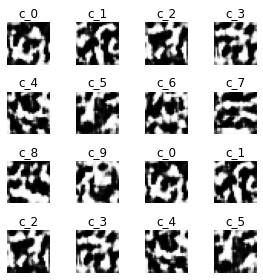

--------------------
Epoch 2/4


g_acc=0.94, g_loss=1.90, d_loss=1.03
Saved D checkpoint: ../gan_attack/checkpoints\it_35\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_35\c_generator_ckpt\ckpt-2


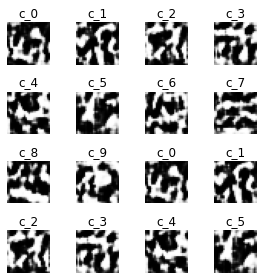

--------------------
Epoch 3/4


g_acc=0.97, g_loss=1.73, d_loss=1.13
Saved D checkpoint: ../gan_attack/checkpoints\it_35\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_35\c_generator_ckpt\ckpt-3


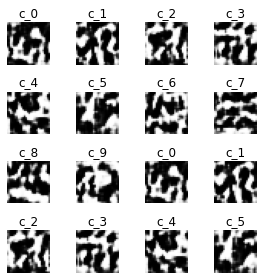

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.77, d_loss=1.11
Saved D checkpoint: ../gan_attack/checkpoints\it_35\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_35\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_35\c_generator_ckpt\ckpt-4
> no change inc: 1/5


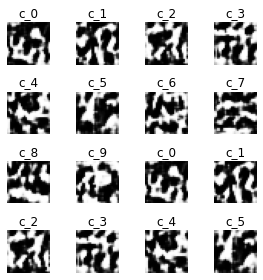


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


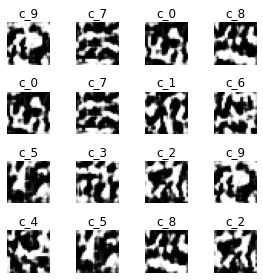

35 datasets gathered

only querying this iteration


Drop percentage: 0.49523809523809526

train_acc=0.0000%
accuracy of blackbox on G dataset: 84.7358%
Saved checkpoint: ../gan_attack/checkpoints\it_35\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_35\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_35\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_35\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


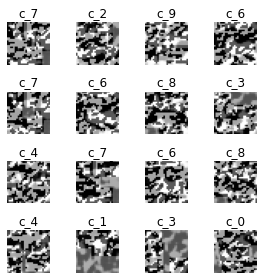

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 42.4126%
Saved checkpoint: ../gan_attack/checkpoints\it_35\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_35\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_35\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_35\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.897

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.860 | Loss: 1.572


D Test Accuracy: 0.567 | Loss: 1.964

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 0.77, 0.7585, 0.7828,

--------------------
Epoch 1/4


g_acc=0.95, g_loss=1.69, d_loss=1.16
Saved D checkpoint: ../gan_attack/checkpoints\it_36\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_36\c_generator_ckpt\ckpt-1


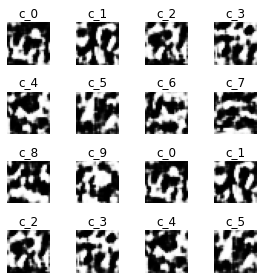

--------------------
Epoch 2/4


g_acc=0.94, g_loss=1.92, d_loss=1.01
Saved D checkpoint: ../gan_attack/checkpoints\it_36\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_36\c_generator_ckpt\ckpt-2
> no change inc: 1/5


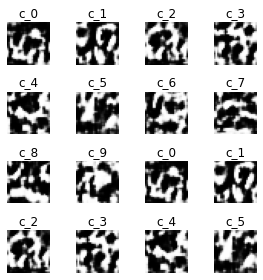

--------------------
Epoch 3/4


g_acc=0.97, g_loss=1.81, d_loss=1.08
Saved D checkpoint: ../gan_attack/checkpoints\it_36\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_36\c_generator_ckpt\ckpt-3


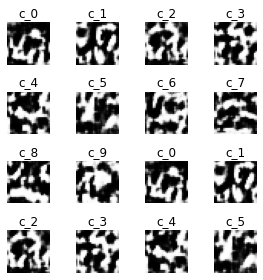

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.74, d_loss=1.12
Saved D checkpoint: ../gan_attack/checkpoints\it_36\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_36\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_36\c_generator_ckpt\ckpt-4
> no change inc: 1/5


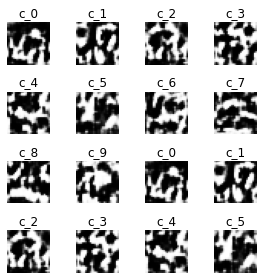


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


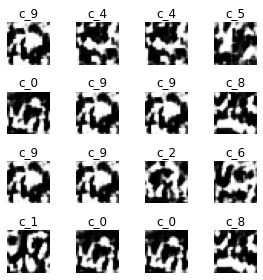

36 datasets gathered



Drop percentage: 0.5

train_acc=95.0562%
accuracy of blackbox on G dataset: 84.2241%
Saved checkpoint: ../gan_attack/checkpoints\it_36\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_36\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_36\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_36\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


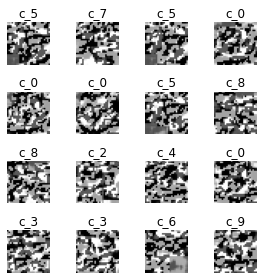

Drop percentage: 0.49206349206349204

train_acc=0.0000%
accuracy of blackbox on G dataset: 39.9026%
Saved checkpoint: ../gan_attack/checkpoints\it_36\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_36\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_36\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_36\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.888

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.960 | Loss: 1.501


D Test Accuracy: 0.529 | Loss: 1.992

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, None, 0.95056194]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865, 0.8206, 0.7786, 

--------------------
Epoch 1/4


g_acc=0.95, g_loss=1.83, d_loss=1.07
Saved D checkpoint: ../gan_attack/checkpoints\it_37\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_37\c_generator_ckpt\ckpt-1


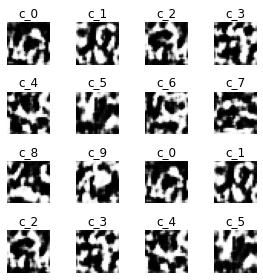

--------------------
Epoch 2/4


g_acc=0.98, g_loss=1.84, d_loss=1.06
Saved D checkpoint: ../gan_attack/checkpoints\it_37\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_37\c_generator_ckpt\ckpt-2


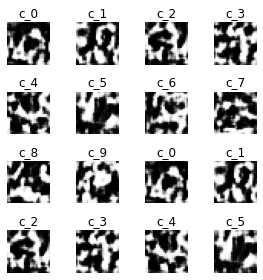

--------------------
Epoch 3/4


g_acc=0.95, g_loss=2.03, d_loss=0.94
Saved D checkpoint: ../gan_attack/checkpoints\it_37\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_37\c_generator_ckpt\ckpt-3


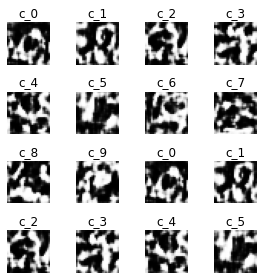

--------------------
Epoch 4/4


g_acc=0.96, g_loss=1.94, d_loss=1.00
Saved D checkpoint: ../gan_attack/checkpoints\it_37\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_37\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_37\c_generator_ckpt\ckpt-4
> no change inc: 1/5


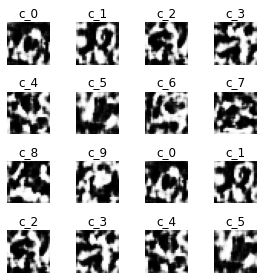


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


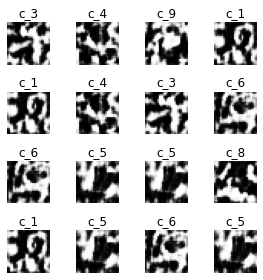

37 datasets gathered

only querying this iteration


Drop percentage: 0.4954954954954955

train_acc=0.0000%
accuracy of blackbox on G dataset: 86.7321%
Saved checkpoint: ../gan_attack/checkpoints\it_37\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_37\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_37\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_37\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


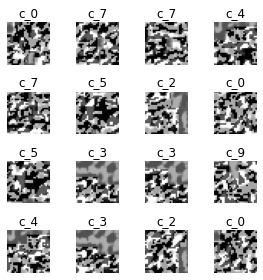

Drop percentage: 0.4918032786885246

train_acc=0.0000%
accuracy of blackbox on G dataset: 51.1111%
Saved checkpoint: ../gan_attack/checkpoints\it_37\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_37\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_37\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_37\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.900

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.464


D Test Accuracy: 0.640 | Loss: 1.887

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, None, 0.95056194, None]
saved d_acc metric: [0.8298, 0.8193, 0.7512, 0.7865,

--------------------
Epoch 1/4


g_acc=0.92, g_loss=1.92, d_loss=1.01
Saved D checkpoint: ../gan_attack/checkpoints\it_38\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_38\c_generator_ckpt\ckpt-1


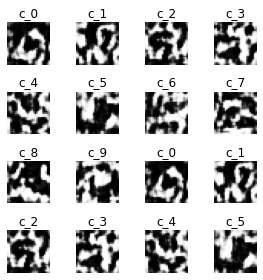

--------------------
Epoch 2/4


g_acc=0.98, g_loss=1.79, d_loss=1.09
Saved D checkpoint: ../gan_attack/checkpoints\it_38\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_38\c_generator_ckpt\ckpt-2


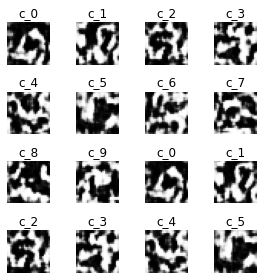

--------------------
Epoch 3/4


g_acc=0.92, g_loss=2.00, d_loss=0.96
Saved D checkpoint: ../gan_attack/checkpoints\it_38\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_38\c_generator_ckpt\ckpt-3


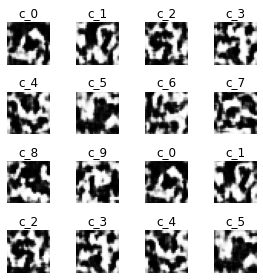

--------------------
Epoch 4/4


g_acc=0.95, g_loss=1.94, d_loss=1.00
Saved D checkpoint: ../gan_attack/checkpoints\it_38\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_38\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_38\c_generator_ckpt\ckpt-4


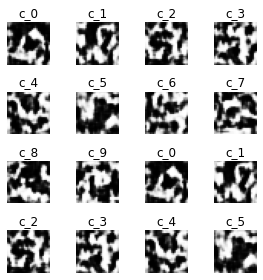


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


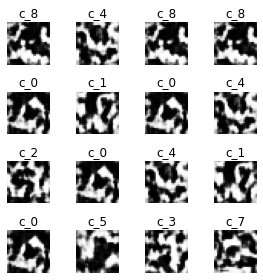

38 datasets gathered



Drop percentage: 0.5

train_acc=94.9530%
accuracy of blackbox on G dataset: 86.6000%
Saved checkpoint: ../gan_attack/checkpoints\it_38\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_38\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_38\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_38\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


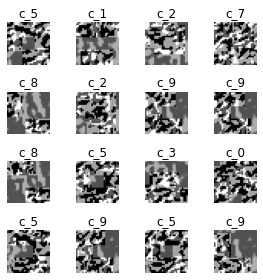

Drop percentage: 0.49333333333333335

train_acc=0.0000%
accuracy of blackbox on G dataset: 45.0272%
Saved checkpoint: ../gan_attack/checkpoints\it_38\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_38\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_38\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_38\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.894

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.960 | Loss: 1.502


D Test Accuracy: 0.671 | Loss: 1.897

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, None, 0.95056194, None, 0.94952995]
saved d_acc metric: [0.8298, 

--------------------
Epoch 1/4


g_acc=0.95, g_loss=1.83, d_loss=1.07
Saved D checkpoint: ../gan_attack/checkpoints\it_39\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_39\c_generator_ckpt\ckpt-1


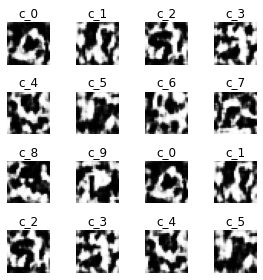

--------------------
Epoch 2/4


g_acc=0.97, g_loss=1.87, d_loss=1.04
Saved D checkpoint: ../gan_attack/checkpoints\it_39\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_39\c_generator_ckpt\ckpt-2
> no change inc: 1/5


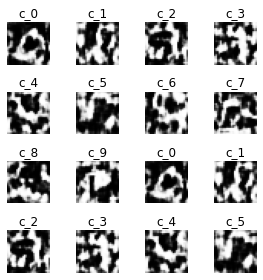

--------------------
Epoch 3/4


g_acc=0.96, g_loss=1.95, d_loss=0.99
Saved D checkpoint: ../gan_attack/checkpoints\it_39\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_39\c_generator_ckpt\ckpt-3
> no change inc: 2/5


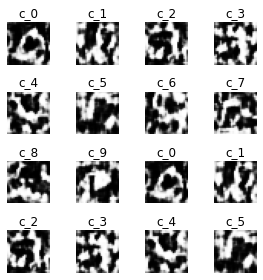

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.90, d_loss=1.02
Saved D checkpoint: ../gan_attack/checkpoints\it_39\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_39\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_39\c_generator_ckpt\ckpt-4
> no change inc: 3/5


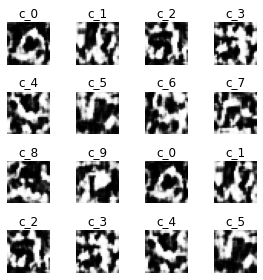


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


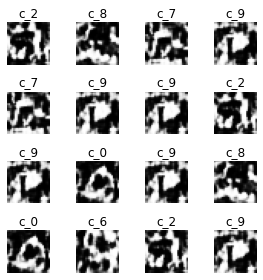

39 datasets gathered

only querying this iteration


Drop percentage: 0.49572649572649574

train_acc=0.0000%
accuracy of blackbox on G dataset: 83.4576%
Saved checkpoint: ../gan_attack/checkpoints\it_39\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_39\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_39\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_39\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


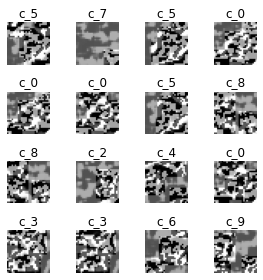

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 53.8141%
Saved checkpoint: ../gan_attack/checkpoints\it_39\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_39\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_39\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_39\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.894

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.466


D Test Accuracy: 0.607 | Loss: 1.937

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, None, 0.95056194, None, 0.94952995, None]
saved d_acc 

--------------------
Epoch 1/4


g_acc=0.98, g_loss=1.70, d_loss=1.15
Saved D checkpoint: ../gan_attack/checkpoints\it_40\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_40\c_generator_ckpt\ckpt-1


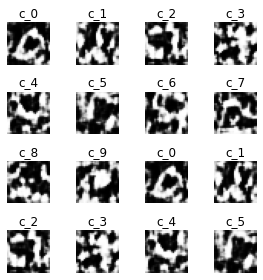

--------------------
Epoch 2/4


g_acc=0.93, g_loss=1.96, d_loss=0.99
Saved D checkpoint: ../gan_attack/checkpoints\it_40\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_40\c_generator_ckpt\ckpt-2


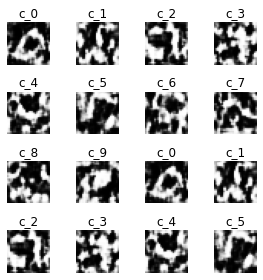

--------------------
Epoch 3/4


g_acc=0.95, g_loss=1.83, d_loss=1.07
Saved D checkpoint: ../gan_attack/checkpoints\it_40\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_40\c_generator_ckpt\ckpt-3


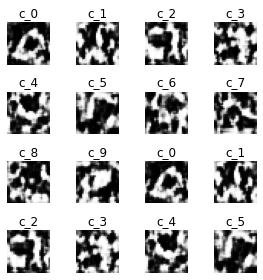

--------------------
Epoch 4/4


g_acc=0.95, g_loss=1.77, d_loss=1.11
Saved D checkpoint: ../gan_attack/checkpoints\it_40\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_40\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_40\c_generator_ckpt\ckpt-4
> no change inc: 1/5


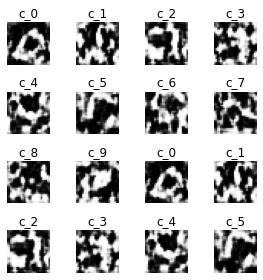


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


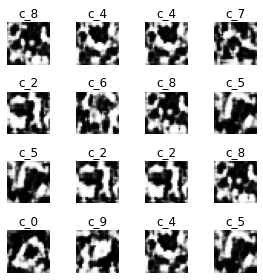

40 datasets gathered



Drop percentage: 0.5

train_acc=95.1042%
accuracy of blackbox on G dataset: 83.4906%
Saved checkpoint: ../gan_attack/checkpoints\it_40\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_40\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_40\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_40\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


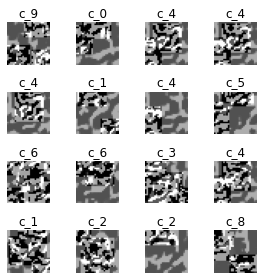

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 46.5185%
Saved checkpoint: ../gan_attack/checkpoints\it_40\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_40\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_40\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_40\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.896

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.490 | Loss: 2.032

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, None, 0.95056194, None, 0.94952995, None, 0

--------------------
Epoch 1/4


g_acc=0.97, g_loss=1.71, d_loss=1.14
Saved D checkpoint: ../gan_attack/checkpoints\it_41\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_41\c_generator_ckpt\ckpt-1


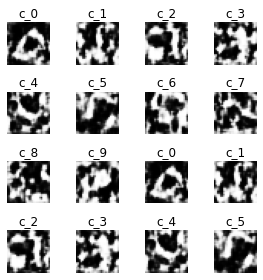

--------------------
Epoch 2/4


g_acc=0.93, g_loss=1.88, d_loss=1.04
Saved D checkpoint: ../gan_attack/checkpoints\it_41\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_41\c_generator_ckpt\ckpt-2


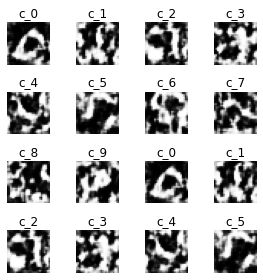

--------------------
Epoch 3/4


g_acc=0.96, g_loss=1.77, d_loss=1.11
Saved D checkpoint: ../gan_attack/checkpoints\it_41\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_41\c_generator_ckpt\ckpt-3


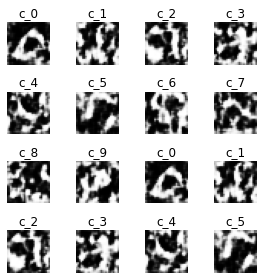

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.71, d_loss=1.14
Saved D checkpoint: ../gan_attack/checkpoints\it_41\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_41\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_41\c_generator_ckpt\ckpt-4
> no change inc: 1/5


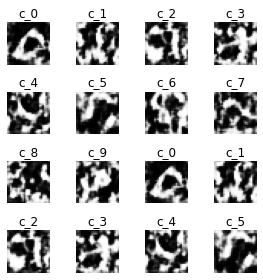


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


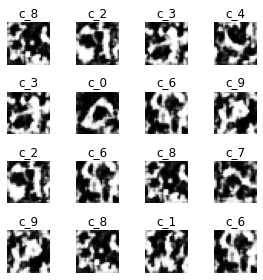

41 datasets gathered

only querying this iteration


Drop percentage: 0.4959349593495935

train_acc=0.0000%
accuracy of blackbox on G dataset: 82.6613%
Saved checkpoint: ../gan_attack/checkpoints\it_41\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_41\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_41\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_41\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


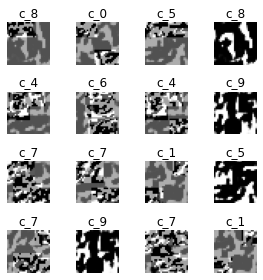

Drop percentage: 0.4925373134328358

train_acc=0.0000%
accuracy of blackbox on G dataset: 49.8171%
Saved checkpoint: ../gan_attack/checkpoints\it_41\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_41\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_41\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_41\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.887

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.493 | Loss: 2.022

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, None, 0.95056194, None, 0.949529

--------------------
Epoch 1/4


g_acc=0.94, g_loss=1.71, d_loss=1.15
Saved D checkpoint: ../gan_attack/checkpoints\it_42\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_42\c_generator_ckpt\ckpt-1


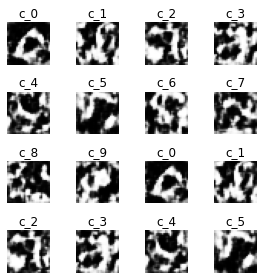

--------------------
Epoch 2/4


g_acc=0.93, g_loss=1.78, d_loss=1.10
Saved D checkpoint: ../gan_attack/checkpoints\it_42\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_42\c_generator_ckpt\ckpt-2
> no change inc: 1/5


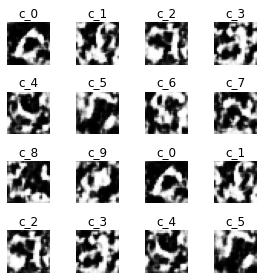

--------------------
Epoch 3/4


g_acc=0.97, g_loss=1.67, d_loss=1.17
Saved D checkpoint: ../gan_attack/checkpoints\it_42\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_42\c_generator_ckpt\ckpt-3


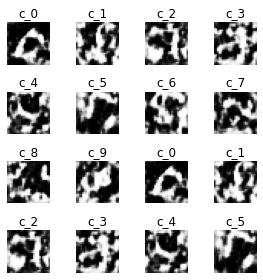

--------------------
Epoch 4/4


g_acc=0.98, g_loss=1.63, d_loss=1.20
Saved D checkpoint: ../gan_attack/checkpoints\it_42\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_42\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_42\c_generator_ckpt\ckpt-4
> no change inc: 1/5


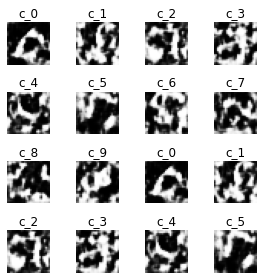


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


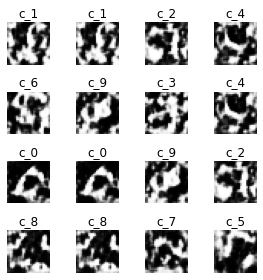

42 datasets gathered



Drop percentage: 0.5

train_acc=95.3249%
accuracy of blackbox on G dataset: 83.7031%
Saved checkpoint: ../gan_attack/checkpoints\it_42\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_42\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_42\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_42\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


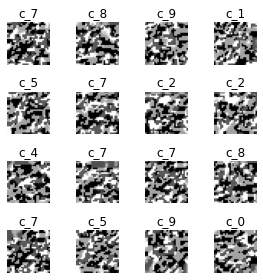

Drop percentage: 0.4927536231884058

train_acc=0.0000%
accuracy of blackbox on G dataset: 39.4509%
Saved checkpoint: ../gan_attack/checkpoints\it_42\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_42\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_42\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_42\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.891

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.462


D Test Accuracy: 0.496 | Loss: 2.020

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, None, 0.95056194, None,

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.79, d_loss=1.09
Saved D checkpoint: ../gan_attack/checkpoints\it_43\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_43\c_generator_ckpt\ckpt-1


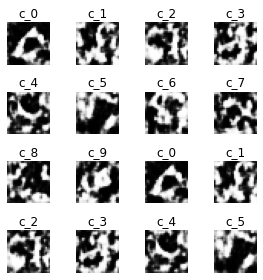

--------------------
Epoch 2/4


g_acc=0.97, g_loss=1.76, d_loss=1.11
Saved D checkpoint: ../gan_attack/checkpoints\it_43\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_43\c_generator_ckpt\ckpt-2
> no change inc: 1/5


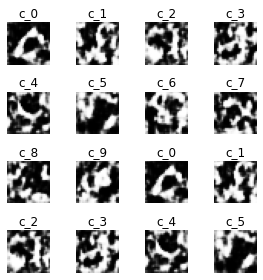

--------------------
Epoch 3/4


g_acc=0.98, g_loss=1.75, d_loss=1.12
Saved D checkpoint: ../gan_attack/checkpoints\it_43\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_43\c_generator_ckpt\ckpt-3
> no change inc: 2/5


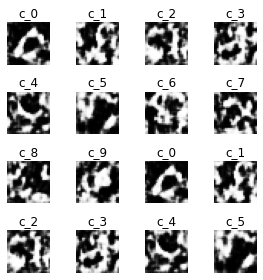

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.77, d_loss=1.11
Saved D checkpoint: ../gan_attack/checkpoints\it_43\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_43\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_43\c_generator_ckpt\ckpt-4
> no change inc: 3/5


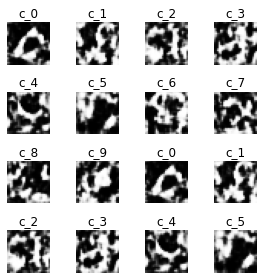


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


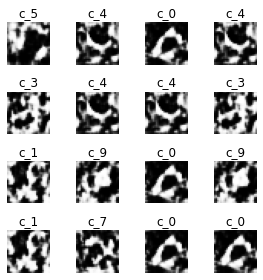

43 datasets gathered

only querying this iteration


Drop percentage: 0.49612403100775193

train_acc=0.0000%
accuracy of blackbox on G dataset: 84.0769%
Saved checkpoint: ../gan_attack/checkpoints\it_43\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_43\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_43\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_43\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


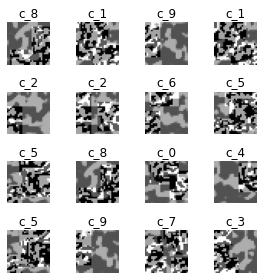

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 50.6358%
Saved checkpoint: ../gan_attack/checkpoints\it_43\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_43\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_43\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_43\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.902

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.470 | Loss: 2.031

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625, 0.9738672]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, None, 0.9505

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.70, d_loss=1.15
Saved D checkpoint: ../gan_attack/checkpoints\it_44\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_44\c_generator_ckpt\ckpt-1


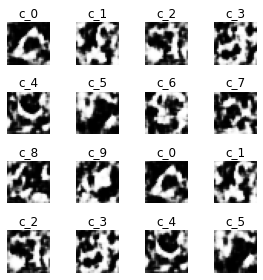

--------------------
Epoch 2/4


g_acc=0.95, g_loss=1.82, d_loss=1.08
Saved D checkpoint: ../gan_attack/checkpoints\it_44\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_44\c_generator_ckpt\ckpt-2
> no change inc: 1/5


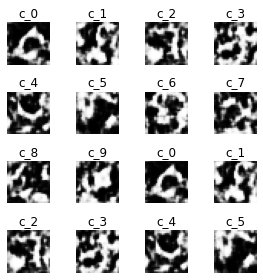

--------------------
Epoch 3/4


g_acc=0.95, g_loss=1.86, d_loss=1.05
Saved D checkpoint: ../gan_attack/checkpoints\it_44\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_44\c_generator_ckpt\ckpt-3
> no change inc: 2/5


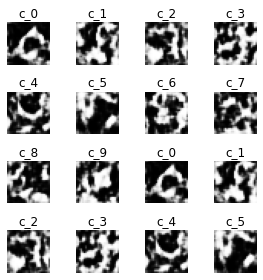

--------------------
Epoch 4/4


g_acc=0.96, g_loss=1.81, d_loss=1.08
Saved D checkpoint: ../gan_attack/checkpoints\it_44\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_44\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_44\c_generator_ckpt\ckpt-4
> no change inc: 3/5


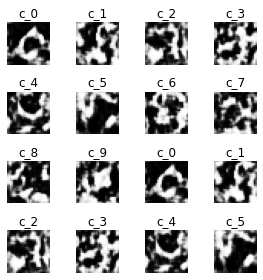


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


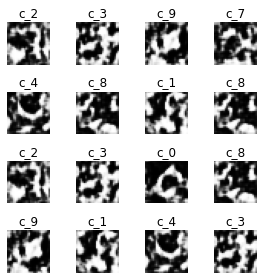

44 datasets gathered



Drop percentage: 0.5

train_acc=95.2787%
accuracy of blackbox on G dataset: 84.1194%
Saved checkpoint: ../gan_attack/checkpoints\it_44\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_44\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_44\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_44\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


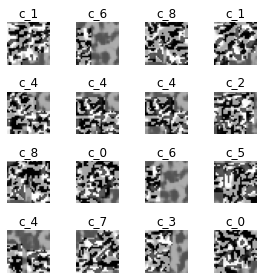

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 49.3678%
Saved checkpoint: ../gan_attack/checkpoints\it_44\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_44\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_44\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_44\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.888

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.416 | Loss: 2.077

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625, 0.9738672, 0.9553516]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 0.945862, N

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.75, d_loss=1.12
Saved D checkpoint: ../gan_attack/checkpoints\it_45\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_45\c_generator_ckpt\ckpt-1


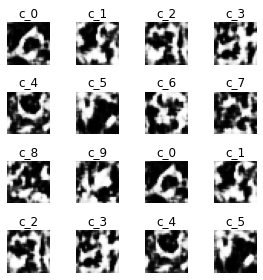

--------------------
Epoch 2/4


g_acc=0.96, g_loss=1.80, d_loss=1.09
Saved D checkpoint: ../gan_attack/checkpoints\it_45\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_45\c_generator_ckpt\ckpt-2
> no change inc: 1/5


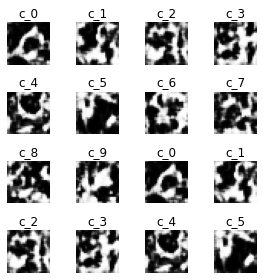

--------------------
Epoch 3/4


g_acc=0.96, g_loss=1.77, d_loss=1.11
Saved D checkpoint: ../gan_attack/checkpoints\it_45\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_45\c_generator_ckpt\ckpt-3
> no change inc: 2/5


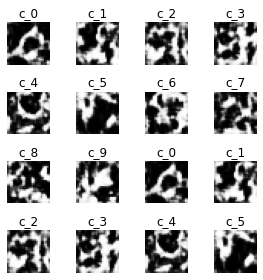

--------------------
Epoch 4/4


g_acc=0.95, g_loss=1.85, d_loss=1.06
Saved D checkpoint: ../gan_attack/checkpoints\it_45\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_45\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_45\c_generator_ckpt\ckpt-4
> no change inc: 3/5


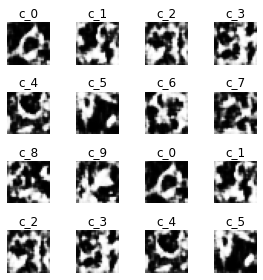


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


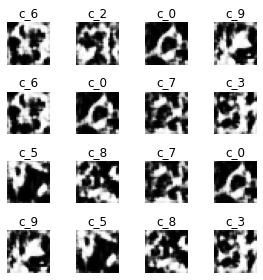

45 datasets gathered

only querying this iteration


Drop percentage: 0.4962962962962963

train_acc=0.0000%
accuracy of blackbox on G dataset: 85.8529%
Saved checkpoint: ../gan_attack/checkpoints\it_45\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_45\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_45\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_45\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


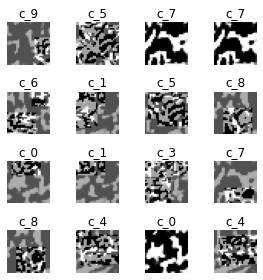

Drop percentage: 0.4931506849315068

train_acc=0.0000%
accuracy of blackbox on G dataset: 59.5628%
Saved checkpoint: ../gan_attack/checkpoints\it_45\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_45\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_45\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_45\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.896

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.960 | Loss: 1.501


D Test Accuracy: 0.428 | Loss: 2.072

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625, 0.9738672, 0.9553516, 0.9535547]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564396, None, 

--------------------
Epoch 1/4


g_acc=0.94, g_loss=1.83, d_loss=1.07
Saved D checkpoint: ../gan_attack/checkpoints\it_46\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_46\c_generator_ckpt\ckpt-1


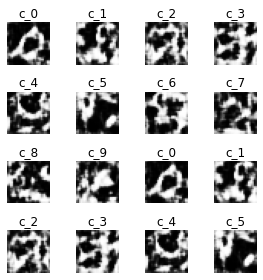

--------------------
Epoch 2/4


g_acc=0.97, g_loss=1.73, d_loss=1.13
Saved D checkpoint: ../gan_attack/checkpoints\it_46\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_46\c_generator_ckpt\ckpt-2


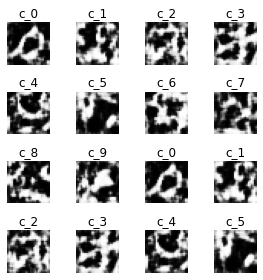

--------------------
Epoch 3/4


g_acc=0.96, g_loss=1.79, d_loss=1.10
Saved D checkpoint: ../gan_attack/checkpoints\it_46\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_46\c_generator_ckpt\ckpt-3
> no change inc: 1/5


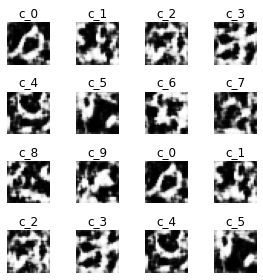

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.74, d_loss=1.12
Saved D checkpoint: ../gan_attack/checkpoints\it_46\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_46\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_46\c_generator_ckpt\ckpt-4
> no change inc: 2/5


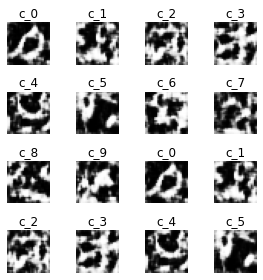


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


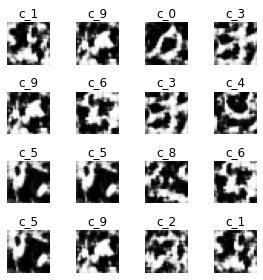

46 datasets gathered



Drop percentage: 0.5

train_acc=95.1352%
accuracy of blackbox on G dataset: 85.7632%
Saved checkpoint: ../gan_attack/checkpoints\it_46\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_46\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_46\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_46\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


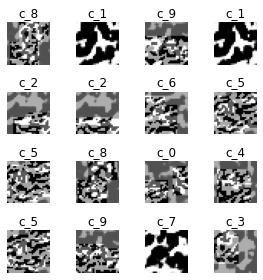

Drop percentage: 0.49382716049382713

train_acc=0.0000%
accuracy of blackbox on G dataset: 56.5672%
Saved checkpoint: ../gan_attack/checkpoints\it_46\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_46\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_46\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_46\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.888

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.830 | Loss: 1.628


D Test Accuracy: 0.460 | Loss: 2.028

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625, 0.9738672, 0.9553516, 0.9535547, 0.9682031]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, None, 0.94564

--------------------
Epoch 1/4


g_acc=0.98, g_loss=1.63, d_loss=1.20
Saved D checkpoint: ../gan_attack/checkpoints\it_47\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_47\c_generator_ckpt\ckpt-1


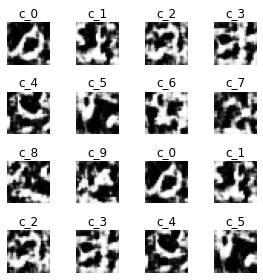

--------------------
Epoch 2/4


g_acc=0.94, g_loss=1.87, d_loss=1.05
Saved D checkpoint: ../gan_attack/checkpoints\it_47\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_47\c_generator_ckpt\ckpt-2


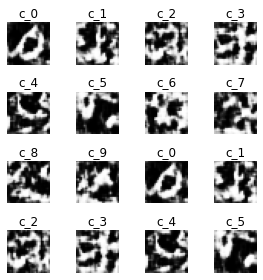

--------------------
Epoch 3/4


g_acc=0.97, g_loss=1.72, d_loss=1.14
Saved D checkpoint: ../gan_attack/checkpoints\it_47\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_47\c_generator_ckpt\ckpt-3


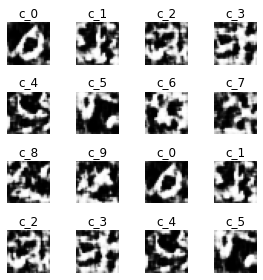

--------------------
Epoch 4/4


g_acc=0.98, g_loss=1.68, d_loss=1.17
Saved D checkpoint: ../gan_attack/checkpoints\it_47\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_47\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_47\c_generator_ckpt\ckpt-4
> no change inc: 1/5


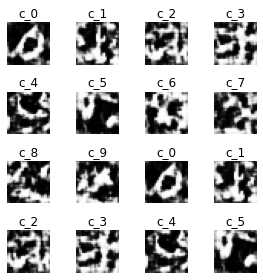


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


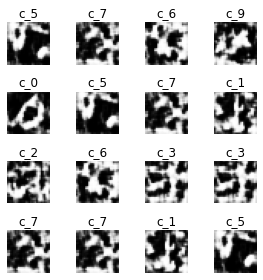

47 datasets gathered

only querying this iteration


Drop percentage: 0.49645390070921985

train_acc=0.0000%
accuracy of blackbox on G dataset: 84.7747%
Saved checkpoint: ../gan_attack/checkpoints\it_47\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_47\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_47\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_47\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


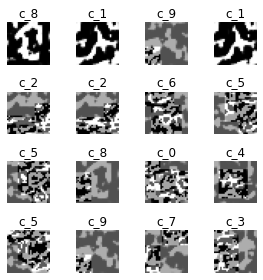

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 57.2581%
Saved checkpoint: ../gan_attack/checkpoints\it_47\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_47\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_47\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_47\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.883

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.910 | Loss: 1.526


D Test Accuracy: 0.482 | Loss: 2.024

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625, 0.9738672, 0.9553516, 0.9535547, 0.9682031, 0.97941405]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 0.9449908, N

--------------------
Epoch 1/4


g_acc=0.98, g_loss=1.62, d_loss=1.20
Saved D checkpoint: ../gan_attack/checkpoints\it_48\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_48\c_generator_ckpt\ckpt-1


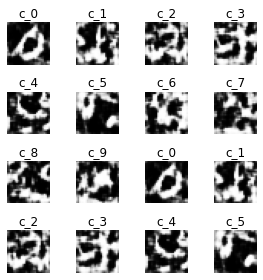

--------------------
Epoch 2/4


g_acc=0.95, g_loss=1.87, d_loss=1.04
Saved D checkpoint: ../gan_attack/checkpoints\it_48\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_48\c_generator_ckpt\ckpt-2


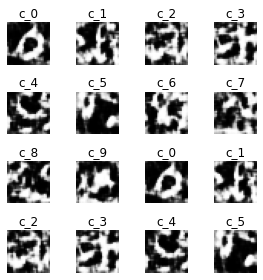

--------------------
Epoch 3/4


g_acc=0.98, g_loss=1.76, d_loss=1.11
Saved D checkpoint: ../gan_attack/checkpoints\it_48\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_48\c_generator_ckpt\ckpt-3


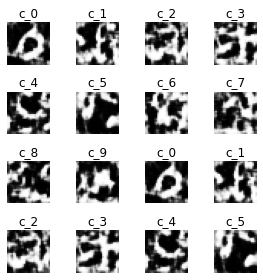

--------------------
Epoch 4/4


g_acc=0.97, g_loss=1.84, d_loss=1.06
Saved D checkpoint: ../gan_attack/checkpoints\it_48\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_48\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_48\c_generator_ckpt\ckpt-4
> no change inc: 1/5


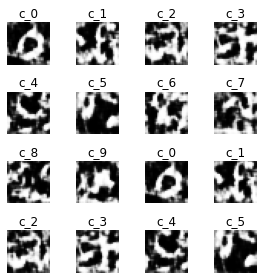


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


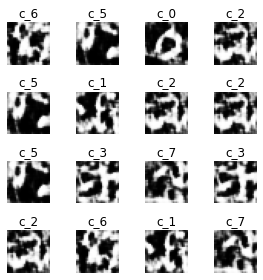

48 datasets gathered



Drop percentage: 0.5

train_acc=95.7848%
accuracy of blackbox on G dataset: 84.2346%
Saved checkpoint: ../gan_attack/checkpoints\it_48\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_48\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_48\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_48\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


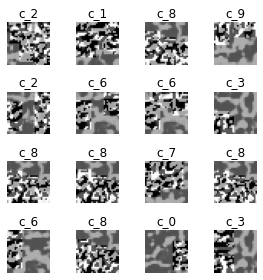

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 49.0521%
Saved checkpoint: ../gan_attack/checkpoints\it_48\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_48\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_48\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_48\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.874

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.549 | Loss: 1.968

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625, 0.9738672, 0.9553516, 0.9535547, 0.9682031, 0.97941405, 0.96878904]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450505, None, 

--------------------
Epoch 1/4


g_acc=0.97, g_loss=1.54, d_loss=1.26
Saved D checkpoint: ../gan_attack/checkpoints\it_49\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_49\c_generator_ckpt\ckpt-1


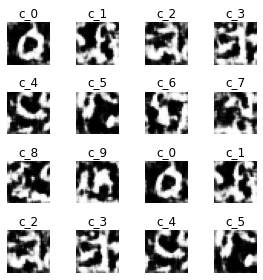

--------------------
Epoch 2/4


g_acc=0.97, g_loss=1.53, d_loss=1.27
Saved D checkpoint: ../gan_attack/checkpoints\it_49\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_49\c_generator_ckpt\ckpt-2
> no change inc: 1/5


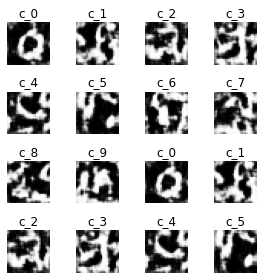

--------------------
Epoch 3/4


g_acc=0.98, g_loss=1.51, d_loss=1.28
Saved D checkpoint: ../gan_attack/checkpoints\it_49\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_49\c_generator_ckpt\ckpt-3
> no change inc: 2/5


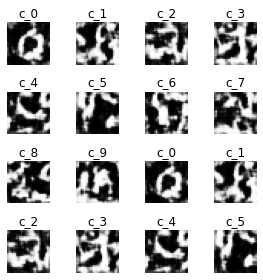

--------------------
Epoch 4/4


g_acc=0.92, g_loss=1.57, d_loss=1.24
Saved D checkpoint: ../gan_attack/checkpoints\it_49\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_49\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_49\c_generator_ckpt\ckpt-4


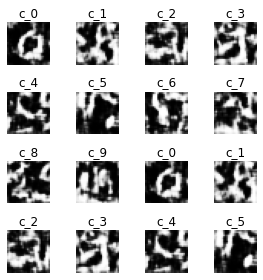


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


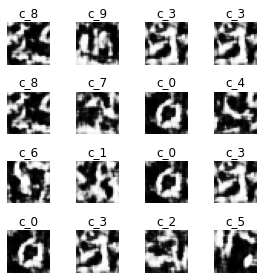

49 datasets gathered

only querying this iteration


Drop percentage: 0.4965986394557823

train_acc=0.0000%
accuracy of blackbox on G dataset: 83.7162%
Saved checkpoint: ../gan_attack/checkpoints\it_49\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_49\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_49\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_49\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


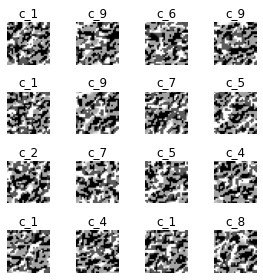

Drop percentage: 0.4936708860759494

train_acc=0.0000%
accuracy of blackbox on G dataset: 37.8316%
Saved checkpoint: ../gan_attack/checkpoints\it_49\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_49\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_49\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_49\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.871

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 0.880 | Loss: 1.546


D Test Accuracy: 0.377 | Loss: 2.103

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625, 0.9738672, 0.9553516, 0.9535547, 0.9682031, 0.97941405, 0.96878904, 0.9240625]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, None, 0.9450

--------------------
Epoch 1/4


g_acc=0.98, g_loss=1.52, d_loss=1.28
Saved D checkpoint: ../gan_attack/checkpoints\it_50\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_50\c_generator_ckpt\ckpt-1


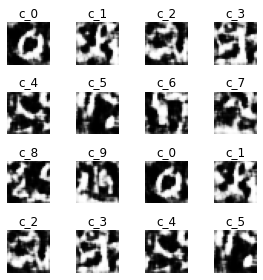

--------------------
Epoch 2/4


g_acc=0.97, g_loss=1.63, d_loss=1.20
Saved D checkpoint: ../gan_attack/checkpoints\it_50\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_50\c_generator_ckpt\ckpt-2
> no change inc: 1/5


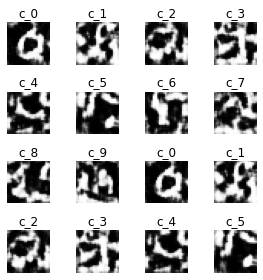

--------------------
Epoch 3/4


g_acc=0.95, g_loss=1.74, d_loss=1.13
Saved D checkpoint: ../gan_attack/checkpoints\it_50\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_50\c_generator_ckpt\ckpt-3


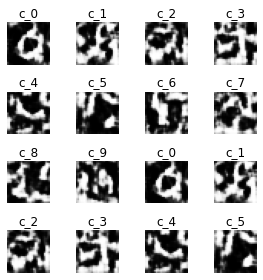

--------------------
Epoch 4/4


g_acc=0.98, g_loss=1.64, d_loss=1.19
Saved D checkpoint: ../gan_attack/checkpoints\it_50\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_50\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_50\c_generator_ckpt\ckpt-4


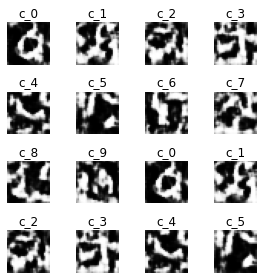


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


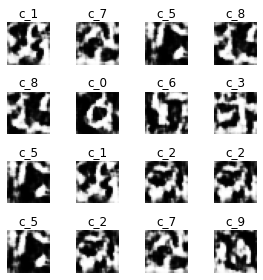

50 datasets gathered



Drop percentage: 0.5

train_acc=95.4520%
accuracy of blackbox on G dataset: 84.3478%
Saved checkpoint: ../gan_attack/checkpoints\it_50\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_50\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_50\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_50\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


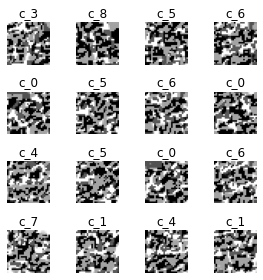

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 40.6145%
Saved checkpoint: ../gan_attack/checkpoints\it_50\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_50\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_50\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_50\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.871

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.400 | Loss: 2.082

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625, 0.9738672, 0.9553516, 0.9535547, 0.9682031, 0.97941405, 0.96878904, 0.9240625, 0.9786328]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 0.9373254, N

--------------------
Epoch 1/4


g_acc=0.96, g_loss=1.69, d_loss=1.16
Saved D checkpoint: ../gan_attack/checkpoints\it_51\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_51\c_generator_ckpt\ckpt-1


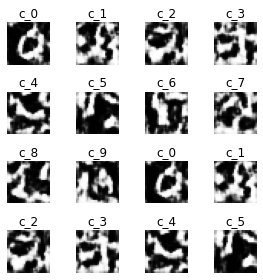

--------------------
Epoch 2/4


g_acc=0.90, g_loss=1.81, d_loss=1.08
Saved D checkpoint: ../gan_attack/checkpoints\it_51\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_51\c_generator_ckpt\ckpt-2


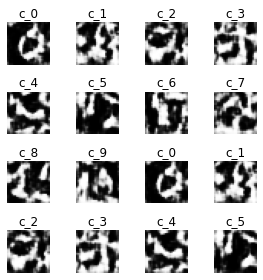

--------------------
Epoch 3/4


g_acc=0.90, g_loss=1.80, d_loss=1.09
Saved D checkpoint: ../gan_attack/checkpoints\it_51\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_51\c_generator_ckpt\ckpt-3
> no change inc: 1/5


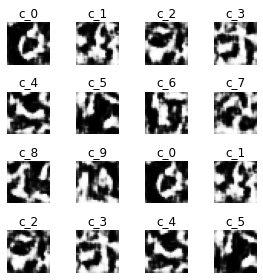

--------------------
Epoch 4/4


g_acc=0.91, g_loss=1.77, d_loss=1.11
Saved D checkpoint: ../gan_attack/checkpoints\it_51\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_51\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_51\c_generator_ckpt\ckpt-4
> no change inc: 2/5


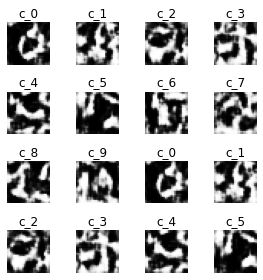


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


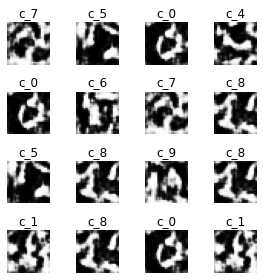

51 datasets gathered

only querying this iteration


Drop percentage: 0.49673202614379086

train_acc=0.0000%
accuracy of blackbox on G dataset: 85.3766%
Saved checkpoint: ../gan_attack/checkpoints\it_51\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_51\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_51\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_51\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


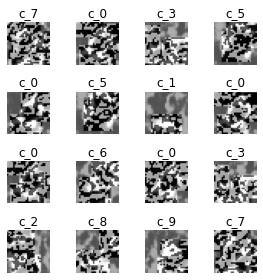

Drop percentage: 0.5

train_acc=0.0000%
accuracy of blackbox on G dataset: 49.3596%
Saved checkpoint: ../gan_attack/checkpoints\it_51\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_51\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_51\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_51\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D



d_refine_acc: 0.875

Split accuracy on G dataset:
Train Accuracy: 0.000 | Loss: 0.000
Test Accuracy: 1.000 | Loss: 1.461


D Test Accuracy: 0.443 | Loss: 2.065

saved g_acc metric: [None, 0.96703124, 0.9682031, 0.93359375, 0.9652344, 0.95984375, 0.9515234, 0.93976563, 0.9740625, 0.9554688, 0.94035155, 0.968125, 0.93019533, 0.9660547, 0.9441406, 0.9682031, 0.96621096, 0.97277343, 0.96375, 0.9232031, 0.9736328, 0.95246094, 0.9751953, 0.96546876, 0.9699219, 0.9025, 0.9742578, 0.97371095, 0.96808594, 0.9582813, 0.9296875, 0.9397266, 0.95835936, 0.96339846, 0.9657813, 0.96972656, 0.97375, 0.9627344, 0.9484375, 0.9721875, 0.9532812, 0.9664062, 0.97625, 0.9738672, 0.9553516, 0.9535547, 0.9682031, 0.97941405, 0.96878904, 0.9240625, 0.9786328, 0.91003907]
saved bb_acc metric: [None, None, 0.88217384, None, 0.8971144, None, 0.90524393, None, 0.9148521, None, 0.913141, None, 0.9220736, None, 0.9251793, None, 0.9292775, None, 0.9334091, None, 0.93403137, None, 0.93714577, None, 0.93793356, None, 

--------------------
Epoch 1/4


g_acc=0.97, g_loss=1.65, d_loss=1.18
Saved D checkpoint: ../gan_attack/checkpoints\it_52\d_middle_model\ckpt-1
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_52\c_generator_ckpt\ckpt-1


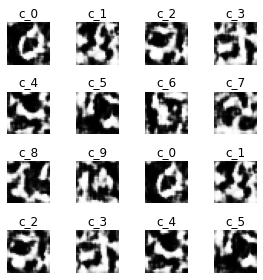

--------------------
Epoch 2/4


g_acc=0.89, g_loss=1.77, d_loss=1.11
Saved D checkpoint: ../gan_attack/checkpoints\it_52\d_middle_model\ckpt-2
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_52\c_generator_ckpt\ckpt-2


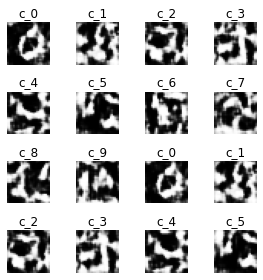

--------------------
Epoch 3/4


g_acc=0.94, g_loss=1.69, d_loss=1.16
Saved D checkpoint: ../gan_attack/checkpoints\it_52\d_middle_model\ckpt-3
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_52\c_generator_ckpt\ckpt-3


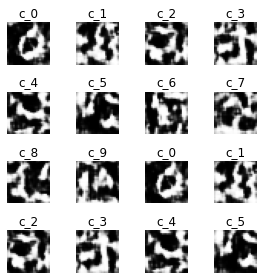

--------------------
Epoch 4/4


g_acc=0.96, g_loss=1.65, d_loss=1.18
Saved D checkpoint: ../gan_attack/checkpoints\it_52\d_middle_model\ckpt-4
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_start_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_middle_model_ckpt\ckpt
Saved D checkpoint: ..\gan_attack\checkpoints\it_52\d_end_model_ckpt\ckpt
Saved c_G checkpoint: ../gan_attack/checkpoints\it_52\c_generator_ckpt\ckpt-4


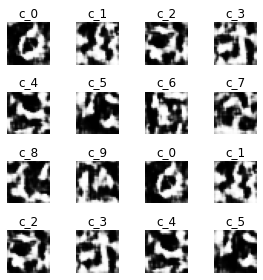


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 4: Training Split Learning (and gathering Black-box labels)


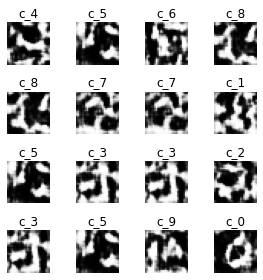

52 datasets gathered



Drop percentage: 0.5

train_acc=95.7046%
accuracy of blackbox on G dataset: 85.3000%
Saved checkpoint: ../gan_attack/checkpoints\it_52\blackbox_ckpt\ckpt-1
Saved checkpoint: ..\gan_attack\checkpoints\it_52\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_52\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_52\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.1: Gathering queries
Fast Gradient Sign Method based on Inf norm



~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.2: Gathering Blackbox labels for the augmented images


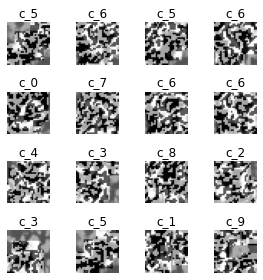

Drop percentage: 0.49411764705882355

train_acc=0.0000%
accuracy of blackbox on G dataset: 43.2536%
Saved checkpoint: ../gan_attack/checkpoints\it_52\blackbox_ckpt\ckpt-2
Saved checkpoint: ..\gan_attack\checkpoints\it_52\split_start_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_52\split_mid_ckpt\ckpt
Saved checkpoint: ..\gan_attack\checkpoints\it_52\split_end_ckpt\ckpt
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Step 5.3: Refining D


KeyboardInterrupt: 

In [24]:
slg = SystemTrainer(split_training_params, cgan_training_params, ugan_training_params, fgsm_training_params, attack_params)
slg.train_system()